In [1]:
%matplotlib inline

import numpy as np
import torch
import matplotlib.pyplot as plt

In [2]:
from torchvision import datasets
import torchvision.transforms as transforms

# number of subprocesses to use for data loading
num_workers = 0
# how many samples per batch to load
batch_size = 64

# convert data to torch.FloatTensor
transform = transforms.ToTensor()

# get the training datasets
train_data = datasets.MNIST(root='data', train=True,
                                   download=True, transform=transform)

# prepare data loader
train_loader = torch.utils.data.DataLoader(train_data, batch_size=batch_size,
                                           num_workers=num_workers)

100%|███████████████████████████████████████████████████████████████████| 9912422/9912422 [00:02<00:00, 4554833.70it/s]


Extracting data\MNIST\raw\train-images-idx3-ubyte.gz to data\MNIST\raw



100%|██████████████████████████████████████████████████████████████████████| 28881/28881 [00:00<00:00, 14458784.18it/s]


Extracting data\MNIST\raw\train-labels-idx1-ubyte.gz to data\MNIST\raw



100%|███████████████████████████████████████████████████████████████████| 1648877/1648877 [00:01<00:00, 1614568.18it/s]


Extracting data\MNIST\raw\t10k-images-idx3-ubyte.gz to data\MNIST\raw



100%|██████████████████████████████████████████████████████████████████████████| 4542/4542 [00:00<00:00, 291256.86it/s]


Extracting data\MNIST\raw\t10k-labels-idx1-ubyte.gz to data\MNIST\raw



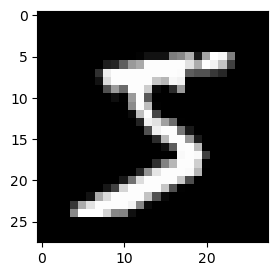

In [3]:
# obtain one batch of training images
dataiter = iter(train_loader)
#images, labels = dataiter.next()
images, labels = next(dataiter)
images = images.numpy()

# get one image from the batch
img = np.squeeze(images[0])

fig = plt.figure(figsize = (3,3)) 
ax = fig.add_subplot(111)
ax.imshow(img, cmap='gray')

In [4]:
import torch.nn as nn
import torch.nn.functional as F

class Discriminator(nn.Module):

    def __init__(self, input_size, hidden_dim, output_size):
        super(Discriminator, self).__init__()
        
        # define all layers
        self.fc1 = nn.Linear(input_size, hidden_dim*4)
        self.fc2 = nn.Linear(hidden_dim*4, hidden_dim*2)
        self.fc3 = nn.Linear(hidden_dim*2, hidden_dim)
        
        # final fully-connected layer
        self.fc4 = nn.Linear(hidden_dim, output_size)
        
        # dropout layer 
        self.dropout = nn.Dropout(0.3)
        
        
    def forward(self, x):
        # flatten image
        x = x.view(-1, 28*28)
        
        # pass x through all layers
        x = F.leaky_relu(self.fc1(x), 0.2)
        x = self.dropout(x)
        x = F.leaky_relu(self.fc2(x), 0.2)
        x = self.dropout(x)
        x = F.leaky_relu(self.fc3(x), 0.2)
        x = self.dropout(x)
        
        x = self.fc4(x)
        # apply leaky relu activation to all hidden layers

        return x


In [5]:
class Generator(nn.Module):

    def __init__(self, input_size, hidden_dim, output_size):
        super(Generator, self).__init__()
        
        # define hidden linear layers
        self.fc1 = nn.Linear(input_size, hidden_dim)
        self.fc2 = nn.Linear(hidden_dim, hidden_dim*2)
        self.fc3 = nn.Linear(hidden_dim*2, hidden_dim*4)
        
        # final fully-connected layer
        self.fc4 = nn.Linear(hidden_dim*4, output_size)
        
        # dropout layer 
        self.dropout = nn.Dropout(0.3)
        
        

    def forward(self, x):
        # pass x through all layers
        x = F.leaky_relu(self.fc1(x), 0.2)
        x = self.dropout(x)
        x = F.leaky_relu(self.fc2(x), 0.2)
        x = self.dropout(x)
        x = F.leaky_relu(self.fc3(x), 0.2)
        x = self.dropout(x)
        
        # final layer should have tanh applied
        x = F.tanh(self.fc4(x))
        
        return x

In [6]:
# Discriminator hyperparams

# Size of input image to discriminator (28*28)
input_size = 28*28
# Size of discriminator output (real or fake)
d_output_size = 1
# Size of *last* hidden layer in the discriminator
d_hidden_size = 32

# Generator hyperparams

# Size of latent vector to give to generator
z_size = 100
# Size of generator output (generated image)
g_output_size = 784
# Size of *first* hidden layer in the generator
g_hidden_size = 32

In [7]:
# instantiate discriminator and generator
D = Discriminator(input_size, d_hidden_size, d_output_size)
G = Generator(z_size, g_hidden_size, g_output_size)

# check that they are as you expect
print(D)
print()
print(G)

Discriminator(
  (fc1): Linear(in_features=784, out_features=128, bias=True)
  (fc2): Linear(in_features=128, out_features=64, bias=True)
  (fc3): Linear(in_features=64, out_features=32, bias=True)
  (fc4): Linear(in_features=32, out_features=1, bias=True)
  (dropout): Dropout(p=0.3, inplace=False)
)

Generator(
  (fc1): Linear(in_features=100, out_features=32, bias=True)
  (fc2): Linear(in_features=32, out_features=64, bias=True)
  (fc3): Linear(in_features=64, out_features=128, bias=True)
  (fc4): Linear(in_features=128, out_features=784, bias=True)
  (dropout): Dropout(p=0.3, inplace=False)
)


In [8]:
# Calculate losses
def real_loss(D_out, smooth=False):
    batch_size = D_out.size(0)
    # compare logits to real labels
    # smooth labels if smooth=True
    if smooth:
        labels = torch.ones(batch_size) * 0.9
    else:
        labels = torch.ones(batch_size)
        
    criterion = nn.BCEWithLogitsLoss()
    loss = criterion(D_out.squeeze(), labels)
    
    return loss

def fake_loss(D_out):
    batch_size = D_out.size(0)
    # compare logits to fake labels
    labels = torch.zeros(batch_size)
    
    criterion = nn.BCEWithLogitsLoss()
    loss = criterion(D_out.squeeze(), labels)
    
    return loss

In [9]:
import torch.optim as optim

# learning rate for optimizers
lr = 0.002

# Create optimizers for the discriminator and generator
d_optimizer = optim.Adam(D.parameters(), lr)
g_optimizer = optim.Adam(G.parameters(), lr)

In [10]:
import pickle as pkl

# training hyperparams
num_epochs = 200

# keep track of loss and generated, "fake" samples
samples = []
losses = []

print_every = 400

# Get some fixed data for sampling. These are images that are held
# constant throughout training, and allow us to inspect the model's performance
sample_size=16
fixed_z = np.random.uniform(-1, 1, size=(sample_size, z_size))
fixed_z = torch.from_numpy(fixed_z).float()

count = 0

# train the network
D.train()
G.train()
for epoch in range(num_epochs):
    
    for batch_i, (real_images, _) in enumerate(train_loader):
        count += 1
        
        batch_size = real_images.size(0)
        print('batch size: ', batch_size)
        print('total len in each epoch remaining: ', len(train_loader)-count)
        print('len of data being processed: ', len(real_images[0]))
        
        ## Important rescaling step ## 
        real_images = real_images*2 - 1  # rescale input images from [0,1) to [-1, 1)
        
        # ============================================
        #            TRAIN THE DISCRIMINATOR
        # ============================================
        d_optimizer.zero_grad()
                
        # 1. Train with real images

        # Compute the discriminator losses on real images
        D_real = D(real_images)
        d_real_loss = real_loss(D_real, smooth=True)
        # use smoothed labels
        
        # 2. Train with fake images
        
        # Generate fake images #gradient doesnt need to flow here
        # These fake images generated here are just for the training of the discriminator
        with torch.no_grad():
            z = np.random.uniform(-1, 1, size=(batch_size, z_size))
            z = torch.from_numpy(z).float()
            fake_images = G(z)
        
        # Compute the discriminator losses on fake images        
        D_fake = D(fake_images)
        d_fake_loss = fake_loss(D_fake)
        # add up real and fake losses and perform backprop
        d_loss = d_real_loss + d_fake_loss
        d_loss.backward()
        d_optimizer.step()
        
        
        # =========================================
        #            TRAIN THE GENERATOR
        # =========================================
        g_optimizer.zero_grad()
        
        # 1. Train with fake images and flipped labels
        
        # Generate fake images
        z = np.random.uniform(-1, 1, size = (batch_size, z_size))
        z = torch.from_numpy(z).float()
        fake_images = G(z)
        
        # Compute the discriminator losses on fake images 
        # using flipped labels!
        D_fake = D(fake_images)
        g_loss = real_loss(D_fake)
        
        # perform backprop
        g_loss.backward()
        g_optimizer.step()
        

        # Print some loss stats
        if batch_i % print_every == 0:
            # print discriminator and generator loss
            print('Epoch [{:5d}/{:5d}] | d_loss: {:6.4f} | g_loss: {:6.4f}'.format(
                    epoch+1, num_epochs, d_loss.item(), g_loss.item()))

    
    ## AFTER EACH EPOCH##
    # append discriminator loss and generator loss
    losses.append((d_loss.item(), g_loss.item()))
    
    # generate and save sample, fake images
    G.eval() # eval mode for generating samples
    samples_z = G(fixed_z)
    samples.append(samples_z)
    G.train() # back to train mode


# Save training generator samples
with open('train_samples.pkl', 'wb') as f:
    pkl.dump(samples, f)

batch size:  64
total len in each epoch remaining:  937
len of data being processed:  1
Epoch [    1/  200] | d_loss: 1.3763 | g_loss: 0.6755
batch size:  64
total len in each epoch remaining:  936
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  935
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  934
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  933
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  932
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  931
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  930
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  929
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  928
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  927
len of dat

batch size:  64
total len in each epoch remaining:  839
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  838
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  837
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  836
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  835
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  834
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  833
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  832
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  831
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  830
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  829
len of data being processed:  1
batch size:  64
total len in eac

batch size:  64
total len in each epoch remaining:  743
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  742
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  741
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  740
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  739
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  738
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  737
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  736
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  735
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  734
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  733
len of data being processed:  1
batch size:  64
total len in eac

batch size:  64
total len in each epoch remaining:  648
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  647
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  646
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  645
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  644
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  643
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  642
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  641
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  640
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  639
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  638
len of data being processed:  1
batch size:  64
total len in eac

batch size:  64
total len in each epoch remaining:  550
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  549
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  548
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  547
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  546
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  545
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  544
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  543
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  542
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  541
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  540
len of data being processed:  1
batch size:  64
total len in eac

batch size:  64
total len in each epoch remaining:  453
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  452
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  451
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  450
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  449
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  448
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  447
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  446
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  445
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  444
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  443
len of data being processed:  1
batch size:  64
total len in eac

batch size:  64
total len in each epoch remaining:  358
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  357
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  356
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  355
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  354
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  353
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  352
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  351
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  350
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  349
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  348
len of data being processed:  1
batch size:  64
total len in eac

batch size:  64
total len in each epoch remaining:  261
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  260
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  259
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  258
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  257
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  256
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  255
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  254
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  253
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  252
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  251
len of data being processed:  1
batch size:  64
total len in eac

batch size:  64
total len in each epoch remaining:  167
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  166
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  165
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  164
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  163
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  162
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  161
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  160
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  159
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  158
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  157
len of data being processed:  1
batch size:  64
total len in eac

batch size:  64
total len in each epoch remaining:  72
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  71
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  70
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  69
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  68
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  67
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  66
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  65
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  64
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  63
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  62
len of data being processed:  1
batch size:  64
total len in each epoch rem

batch size:  64
total len in each epoch remaining:  -24
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34
len of data being processed:  1
batch size:  64
total len in eac

batch size:  64
total len in each epoch remaining:  -119
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129
len of data being processed:  1
batch size:  64
total

batch size:  64
total len in each epoch remaining:  -216
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -217
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -218
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -219
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -220
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -221
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -222
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -223
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -224
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -225
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -226
len of data being processed:  1
batch size:  64
total

batch size:  64
total len in each epoch remaining:  -312
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -313
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -314
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -315
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -316
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -317
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -318
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -319
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -320
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -321
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -322
len of data being processed:  1
batch size:  64
total

batch size:  64
total len in each epoch remaining:  -407
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -408
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -409
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -410
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -411
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -412
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -413
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -414
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -415
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -416
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -417
len of data being processed:  1
batch size:  64
total

batch size:  64
total len in each epoch remaining:  -504
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -505
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -506
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -507
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -508
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -509
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -510
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -511
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -512
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -513
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -514
len of data being processed:  1
batch size:  64
total

batch size:  64
total len in each epoch remaining:  -600
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -601
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -602
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -603
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -604
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -605
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -606
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -607
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -608
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -609
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -610
len of data being processed:  1
batch size:  64
total

batch size:  64
total len in each epoch remaining:  -694
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -695
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -696
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -697
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -698
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -699
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -700
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -701
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -702
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -703
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -704
len of data being processed:  1
batch size:  64
total

batch size:  64
total len in each epoch remaining:  -789
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -790
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -791
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -792
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -793
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -794
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -795
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -796
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -797
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -798
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -799
len of data being processed:  1
batch size:  64
total

batch size:  64
total len in each epoch remaining:  -885
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -886
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -887
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -888
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -889
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -890
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -891
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -892
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -893
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -894
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -895
len of data being processed:  1
batch size:  64
total

batch size:  64
total len in each epoch remaining:  -980
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -981
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -982
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -983
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -984
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -985
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -986
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -987
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -988
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -989
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -990
len of data being processed:  1
batch size:  64
total

batch size:  64
total len in each epoch remaining:  -1077
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1078
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1079
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1080
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1081
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1082
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1083
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1084
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1085
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1086
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1087
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -1174
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1175
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1176
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1177
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1178
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1179
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1180
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1181
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1182
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1183
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1184
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -1270
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1271
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1272
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1273
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1274
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1275
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1276
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1277
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1278
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1279
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1280
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -1365
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1366
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1367
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1368
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1369
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1370
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1371
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1372
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1373
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1374
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1375
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -1460
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1461
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1462
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1463
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1464
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1465
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1466
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1467
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1468
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1469
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1470
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -1556
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1557
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1558
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1559
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1560
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1561
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1562
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1563
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1564
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1565
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1566
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -1649
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1650
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1651
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1652
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1653
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1654
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1655
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1656
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1657
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1658
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1659
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -1745
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1746
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1747
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1748
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1749
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1750
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1751
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1752
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1753
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1754
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1755
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -1841
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1842
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1843
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1844
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1845
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1846
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1847
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1848
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1849
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1850
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1851
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -1938
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1939
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1940
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1941
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1942
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1943
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1944
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1945
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1946
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1947
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -1948
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -2034
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2035
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2036
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2037
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2038
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2039
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2040
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2041
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2042
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2043
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2044
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -2133
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2134
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2135
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2136
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2137
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2138
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2139
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2140
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2141
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2142
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2143
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -2226
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2227
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2228
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2229
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2230
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2231
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2232
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2233
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2234
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2235
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2236
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -2320
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2321
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2322
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2323
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2324
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2325
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2326
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2327
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2328
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2329
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2330
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -2415
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2416
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2417
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2418
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2419
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2420
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2421
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2422
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2423
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2424
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2425
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -2512
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2513
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2514
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2515
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2516
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2517
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2518
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2519
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2520
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2521
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2522
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -2604
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2605
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2606
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2607
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2608
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2609
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2610
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2611
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2612
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2613
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2614
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -2701
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2702
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2703
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2704
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2705
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2706
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2707
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2708
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2709
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2710
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2711
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -2799
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2800
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2801
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2802
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2803
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2804
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2805
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2806
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2807
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2808
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2809
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -2892
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2893
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2894
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2895
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2896
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2897
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2898
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2899
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2900
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2901
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2902
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -2990
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2991
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2992
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2993
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2994
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2995
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2996
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2997
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2998
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -2999
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3000
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -3087
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3088
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3089
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3090
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3091
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3092
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3093
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3094
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3095
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3096
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3097
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -3183
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3184
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3185
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3186
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3187
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3188
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3189
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3190
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3191
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3192
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3193
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -3279
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3280
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3281
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3282
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3283
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3284
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3285
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3286
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3287
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3288
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3289
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -3373
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3374
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3375
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3376
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3377
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3378
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3379
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3380
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3381
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3382
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3383
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -3470
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3471
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3472
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3473
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3474
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3475
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3476
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3477
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3478
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3479
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3480
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -3567
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3568
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3569
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3570
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3571
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3572
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3573
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3574
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3575
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3576
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3577
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -3665
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3666
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3667
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3668
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3669
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3670
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3671
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3672
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3673
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3674
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3675
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -3762
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3763
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3764
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3765
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3766
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3767
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3768
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3769
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3770
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3771
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3772
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -3857
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3858
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3859
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3860
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3861
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3862
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3863
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3864
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3865
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3866
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3867
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -3954
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3955
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3956
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3957
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3958
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3959
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3960
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3961
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3962
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3963
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -3964
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -4048
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4049
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4050
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4051
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4052
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4053
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4054
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4055
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4056
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4057
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4058
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -4142
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4143
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4144
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4145
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4146
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4147
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4148
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4149
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4150
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4151
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4152
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -4239
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4240
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4241
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4242
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4243
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4244
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4245
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4246
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4247
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4248
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4249
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -4333
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4334
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4335
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4336
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4337
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4338
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4339
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4340
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4341
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4342
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4343
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -4430
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4431
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4432
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4433
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4434
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4435
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4436
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4437
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4438
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4439
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4440
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -4524
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4525
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4526
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4527
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4528
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4529
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4530
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4531
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4532
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4533
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4534
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -4619
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4620
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4621
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4622
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4623
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4624
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4625
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4626
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4627
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4628
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4629
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -4717
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4718
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4719
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4720
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4721
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4722
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4723
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4724
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4725
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4726
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4727
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -4811
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4812
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4813
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4814
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4815
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4816
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4817
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4818
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4819
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4820
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4821
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -4907
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4908
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4909
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4910
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4911
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4912
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4913
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4914
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4915
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4916
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -4917
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -5005
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5006
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5007
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5008
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5009
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5010
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5011
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5012
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5013
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5014
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5015
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -5098
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5099
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5100
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5101
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5102
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5103
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5104
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5105
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5106
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5107
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5108
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -5192
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5193
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5194
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5195
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5196
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5197
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5198
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5199
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5200
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5201
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5202
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -5288
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5289
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5290
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5291
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5292
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5293
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5294
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5295
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5296
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5297
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5298
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -5383
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5384
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5385
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5386
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5387
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5388
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5389
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5390
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5391
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5392
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5393
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -5476
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5477
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5478
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5479
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5480
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5481
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5482
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5483
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5484
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5485
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5486
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -5567
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5568
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5569
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5570
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5571
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5572
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5573
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5574
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5575
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5576
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5577
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -5659
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5660
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5661
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5662
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5663
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5664
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5665
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5666
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5667
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5668
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5669
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -5756
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5757
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5758
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5759
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5760
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5761
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5762
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5763
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5764
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5765
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5766
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -5851
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5852
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5853
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5854
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5855
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5856
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5857
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5858
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5859
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5860
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5861
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -5948
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5949
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5950
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5951
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5952
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5953
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5954
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5955
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5956
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5957
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -5958
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -6046
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6047
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6048
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6049
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6050
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6051
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6052
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6053
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6054
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6055
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6056
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -6140
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6141
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6142
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6143
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6144
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6145
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6146
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6147
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6148
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6149
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6150
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -6232
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6233
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6234
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6235
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6236
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6237
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6238
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6239
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6240
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6241
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6242
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -6325
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6326
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6327
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6328
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6329
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6330
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6331
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6332
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6333
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6334
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6335
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -6423
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6424
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6425
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6426
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6427
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6428
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6429
len of data being processed:  1
Epoch [    8/  200] | d_loss: 1.0927 | g_loss: 1.9255
batch size:  64
total len in each epoch remaining:  -6430
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6431
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6432
len of data being processed:  1
batch size:  64
total len in each epoch remain

batch size:  64
total len in each epoch remaining:  -6519
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6520
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6521
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6522
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6523
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6524
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6525
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6526
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6527
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6528
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6529
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -6615
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6616
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6617
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6618
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6619
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6620
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6621
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6622
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6623
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6624
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6625
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -6711
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6712
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6713
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6714
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6715
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6716
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6717
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6718
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6719
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6720
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6721
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -6807
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6808
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6809
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6810
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6811
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6812
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6813
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6814
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6815
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6816
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6817
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -6903
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6904
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6905
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6906
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6907
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6908
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6909
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6910
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6911
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6912
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6913
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -6996
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6997
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6998
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -6999
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7000
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7001
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7002
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7003
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7004
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7005
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7006
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -7092
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7093
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7094
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7095
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7096
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7097
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7098
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7099
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7100
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7101
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7102
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -7190
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7191
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7192
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7193
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7194
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7195
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7196
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7197
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7198
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7199
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7200
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -7286
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7287
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7288
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7289
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7290
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7291
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7292
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7293
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7294
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7295
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7296
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -7379
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7380
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7381
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7382
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7383
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7384
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7385
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7386
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7387
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7388
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7389
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -7472
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7473
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7474
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7475
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7476
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7477
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7478
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7479
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7480
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7481
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7482
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -7570
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7571
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7572
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7573
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7574
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7575
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7576
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7577
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7578
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7579
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7580
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -7665
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7666
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7667
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7668
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7669
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7670
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7671
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7672
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7673
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7674
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7675
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -7761
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7762
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7763
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7764
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7765
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7766
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7767
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7768
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7769
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7770
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7771
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -7854
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7855
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7856
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7857
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7858
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7859
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7860
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7861
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7862
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7863
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7864
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -7948
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7949
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7950
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7951
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7952
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7953
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7954
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7955
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7956
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7957
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -7958
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -8044
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8045
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8046
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8047
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8048
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8049
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8050
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8051
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8052
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8053
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8054
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -8140
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8141
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8142
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8143
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8144
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8145
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8146
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8147
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8148
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8149
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8150
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -8233
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8234
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8235
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8236
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8237
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8238
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8239
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8240
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8241
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8242
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8243
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -8329
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8330
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8331
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8332
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8333
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8334
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8335
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8336
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8337
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8338
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8339
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -8424
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8425
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8426
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8427
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8428
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8429
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8430
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8431
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8432
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8433
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8434
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -8519
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8520
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8521
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8522
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8523
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8524
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8525
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8526
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8527
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8528
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8529
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -8615
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8616
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8617
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8618
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8619
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8620
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8621
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8622
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8623
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8624
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8625
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -8709
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8710
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8711
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8712
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8713
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8714
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8715
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8716
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8717
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8718
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8719
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -8803
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8804
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8805
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8806
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8807
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8808
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8809
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8810
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8811
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8812
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8813
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -8897
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8898
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8899
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8900
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8901
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8902
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8903
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8904
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8905
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8906
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8907
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -8994
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8995
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8996
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8997
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8998
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -8999
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9000
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9001
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9002
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9003
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9004
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -9089
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9090
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9091
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9092
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9093
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9094
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9095
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9096
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9097
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9098
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9099
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -9183
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9184
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9185
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9186
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9187
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9188
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9189
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9190
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9191
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9192
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9193
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -9278
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9279
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9280
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9281
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9282
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9283
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9284
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9285
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9286
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9287
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9288
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -9374
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9375
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9376
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9377
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9378
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9379
len of data being processed:  1
batch size:  32
total len in each epoch remaining:  -9380
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9381
len of data being processed:  1
Epoch [   12/  200] | d_loss: 1.1261 | g_loss: 1.1336
batch size:  64
total len in each epoch remaining:  -9382
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9383
len of data being processed:  1
batch size:  64
total len in each epoch remain

batch size:  64
total len in each epoch remaining:  -9469
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9470
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9471
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9472
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9473
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9474
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9475
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9476
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9477
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9478
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9479
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -9564
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9565
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9566
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9567
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9568
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9569
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9570
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9571
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9572
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9573
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9574
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -9658
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9659
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9660
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9661
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9662
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9663
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9664
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9665
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9666
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9667
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9668
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -9753
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9754
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9755
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9756
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9757
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9758
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9759
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9760
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9761
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9762
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9763
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -9848
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9849
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9850
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9851
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9852
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9853
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9854
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9855
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9856
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9857
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9858
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -9944
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9945
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9946
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9947
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9948
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9949
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9950
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9951
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9952
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9953
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -9954
len of data being processed:  1
batch size

batch size:  64
total len in each epoch remaining:  -10040
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10041
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10042
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10043
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10044
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10045
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10046
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10047
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10048
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10049
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10050
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -10136
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10137
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10138
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10139
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10140
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10141
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10142
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10143
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10144
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10145
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10146
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -10232
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10233
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10234
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10235
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10236
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10237
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10238
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10239
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10240
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10241
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10242
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -10327
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10328
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10329
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10330
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10331
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10332
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10333
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10334
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10335
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10336
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10337
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -10418
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10419
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10420
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10421
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10422
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10423
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10424
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10425
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10426
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10427
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10428
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -10511
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10512
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10513
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10514
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10515
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10516
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10517
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10518
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10519
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10520
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10521
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -10602
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10603
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10604
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10605
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10606
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10607
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10608
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10609
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10610
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10611
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10612
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -10695
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10696
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10697
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10698
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10699
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10700
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10701
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10702
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10703
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10704
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10705
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -10790
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10791
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10792
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10793
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10794
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10795
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10796
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10797
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10798
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10799
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10800
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -10884
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10885
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10886
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10887
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10888
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10889
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10890
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10891
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10892
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10893
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10894
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -10978
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10979
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10980
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10981
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10982
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10983
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10984
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10985
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10986
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10987
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -10988
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -11072
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11073
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11074
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11075
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11076
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11077
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11078
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11079
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11080
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11081
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11082
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -11166
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11167
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11168
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11169
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11170
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11171
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11172
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11173
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11174
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11175
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11176
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -11263
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11264
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11265
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11266
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11267
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11268
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11269
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11270
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11271
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11272
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11273
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -11359
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11360
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11361
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11362
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11363
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11364
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11365
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11366
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11367
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11368
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11369
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -11453
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11454
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11455
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11456
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11457
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11458
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11459
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11460
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11461
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11462
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11463
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -11547
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11548
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11549
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11550
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11551
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11552
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11553
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11554
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11555
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11556
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11557
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -11641
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11642
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11643
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11644
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11645
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11646
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11647
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11648
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11649
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11650
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11651
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -11737
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11738
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11739
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11740
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11741
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11742
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11743
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11744
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11745
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11746
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11747
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -11835
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11836
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11837
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11838
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11839
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11840
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11841
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11842
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11843
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11844
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11845
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -11931
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11932
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11933
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11934
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11935
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11936
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11937
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11938
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11939
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11940
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -11941
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -12028
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12029
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12030
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12031
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12032
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12033
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12034
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12035
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12036
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12037
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12038
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -12123
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12124
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12125
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12126
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12127
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12128
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12129
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12130
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12131
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12132
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12133
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -12217
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12218
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12219
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12220
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12221
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12222
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12223
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12224
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12225
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12226
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12227
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -12314
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12315
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12316
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12317
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12318
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12319
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12320
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12321
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12322
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12323
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12324
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -12410
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12411
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12412
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12413
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12414
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12415
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12416
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12417
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12418
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12419
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12420
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -12506
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12507
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12508
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12509
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12510
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12511
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12512
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12513
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12514
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12515
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12516
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -12602
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12603
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12604
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12605
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12606
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12607
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12608
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12609
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12610
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12611
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12612
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -12696
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12697
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12698
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12699
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12700
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12701
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12702
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12703
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12704
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12705
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12706
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -12790
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12791
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12792
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12793
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12794
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12795
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12796
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12797
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12798
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12799
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12800
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -12886
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12887
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12888
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12889
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12890
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12891
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12892
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12893
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12894
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12895
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12896
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -12981
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12982
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12983
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12984
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12985
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12986
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12987
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12988
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12989
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12990
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -12991
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -13076
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13077
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13078
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13079
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13080
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13081
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13082
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13083
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13084
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13085
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13086
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -13171
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13172
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13173
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13174
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13175
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13176
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13177
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13178
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13179
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13180
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13181
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -13267
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13268
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13269
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13270
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13271
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13272
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13273
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13274
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13275
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13276
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13277
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -13364
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13365
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13366
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13367
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13368
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13369
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13370
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13371
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13372
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13373
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13374
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -13461
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13462
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13463
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13464
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13465
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13466
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13467
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13468
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13469
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13470
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13471
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -13551
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13552
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13553
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13554
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13555
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13556
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13557
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13558
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13559
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13560
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13561
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -13646
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13647
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13648
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13649
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13650
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13651
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13652
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13653
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13654
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13655
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13656
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -13742
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13743
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13744
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13745
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13746
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13747
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13748
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13749
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13750
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13751
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13752
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -13836
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13837
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13838
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13839
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13840
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13841
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13842
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13843
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13844
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13845
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13846
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -13932
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13933
len of data being processed:  1
Epoch [   16/  200] | d_loss: 1.4120 | g_loss: 0.9917
batch size:  64
total len in each epoch remaining:  -13934
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13935
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13936
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13937
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13938
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13939
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13940
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -13941
len of data being processed:  1
batch size:  64
total len in each ep

batch size:  64
total len in each epoch remaining:  -14025
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14026
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14027
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14028
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14029
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14030
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14031
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14032
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14033
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14034
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14035
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -14122
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14123
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14124
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14125
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14126
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14127
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14128
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14129
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14130
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14131
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14132
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -14217
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14218
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14219
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14220
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14221
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14222
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14223
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14224
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14225
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14226
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14227
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -14312
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14313
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14314
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14315
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14316
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14317
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14318
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14319
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14320
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14321
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14322
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -14410
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14411
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14412
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14413
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14414
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14415
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14416
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14417
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14418
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14419
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14420
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -14507
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14508
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14509
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14510
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14511
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14512
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14513
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14514
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14515
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14516
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14517
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -14603
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14604
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14605
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14606
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14607
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14608
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14609
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14610
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14611
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14612
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14613
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -14697
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14698
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14699
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14700
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14701
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14702
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14703
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14704
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14705
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14706
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14707
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -14791
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14792
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14793
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14794
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14795
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14796
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14797
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14798
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14799
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14800
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14801
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -14882
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14883
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14884
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14885
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14886
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14887
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14888
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14889
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14890
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14891
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14892
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -14975
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14976
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14977
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14978
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14979
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14980
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14981
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14982
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14983
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14984
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -14985
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -15067
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15068
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15069
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15070
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15071
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15072
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15073
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15074
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15075
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15076
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15077
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -15162
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15163
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15164
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15165
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15166
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15167
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15168
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15169
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15170
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15171
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15172
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -15254
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15255
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15256
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15257
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15258
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15259
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15260
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15261
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15262
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15263
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15264
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -15352
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15353
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15354
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15355
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15356
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15357
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15358
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15359
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15360
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15361
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15362
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -15444
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15445
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15446
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15447
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15448
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15449
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15450
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15451
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15452
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15453
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15454
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -15540
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15541
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15542
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15543
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15544
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15545
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15546
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15547
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15548
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15549
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15550
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -15634
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15635
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15636
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15637
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15638
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15639
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15640
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15641
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15642
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15643
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15644
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -15729
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15730
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15731
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15732
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15733
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15734
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15735
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15736
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15737
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15738
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15739
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -15824
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15825
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15826
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15827
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15828
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15829
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15830
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15831
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15832
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15833
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15834
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -15918
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15919
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15920
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15921
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15922
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15923
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15924
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15925
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15926
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15927
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -15928
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -16009
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16010
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16011
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16012
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16013
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16014
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16015
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16016
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16017
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16018
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16019
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -16104
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16105
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16106
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16107
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16108
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16109
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16110
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16111
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16112
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16113
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16114
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -16199
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16200
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16201
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16202
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16203
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16204
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16205
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16206
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16207
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16208
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16209
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -16293
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16294
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16295
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16296
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16297
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16298
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16299
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16300
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16301
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16302
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16303
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -16390
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16391
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16392
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16393
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16394
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16395
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16396
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16397
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16398
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16399
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16400
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -16482
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16483
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16484
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16485
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16486
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16487
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16488
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16489
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16490
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16491
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16492
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -16576
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16577
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16578
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16579
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16580
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16581
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16582
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16583
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16584
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16585
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16586
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -16670
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16671
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16672
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16673
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16674
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16675
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16676
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16677
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16678
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16679
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16680
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -16763
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16764
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16765
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16766
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16767
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16768
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16769
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16770
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16771
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16772
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16773
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -16860
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16861
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16862
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16863
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16864
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16865
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16866
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16867
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16868
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16869
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16870
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -16957
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16958
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16959
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16960
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16961
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16962
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16963
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16964
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16965
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16966
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -16967
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -17053
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17054
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17055
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17056
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17057
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17058
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17059
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17060
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17061
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17062
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17063
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -17149
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17150
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17151
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17152
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17153
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17154
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17155
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17156
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17157
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17158
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17159
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -17243
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17244
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17245
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17246
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17247
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17248
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17249
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17250
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17251
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17252
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17253
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -17337
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17338
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17339
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17340
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17341
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17342
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17343
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17344
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17345
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17346
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17347
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -17430
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17431
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17432
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17433
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17434
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17435
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17436
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17437
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17438
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17439
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17440
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -17526
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17527
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17528
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17529
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17530
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17531
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17532
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17533
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17534
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17535
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17536
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -17620
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17621
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17622
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17623
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17624
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17625
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17626
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17627
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17628
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17629
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17630
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -17715
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17716
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17717
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17718
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17719
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17720
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17721
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17722
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17723
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17724
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17725
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -17806
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17807
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17808
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17809
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17810
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17811
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17812
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17813
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17814
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17815
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17816
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -17901
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17902
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17903
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17904
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17905
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17906
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17907
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17908
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17909
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17910
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17911
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -17993
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17994
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17995
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17996
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17997
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17998
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -17999
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18000
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18001
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18002
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18003
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -18087
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18088
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18089
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18090
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18091
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18092
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18093
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18094
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18095
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18096
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18097
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -18182
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18183
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18184
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18185
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18186
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18187
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18188
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18189
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18190
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18191
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18192
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -18276
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18277
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18278
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18279
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18280
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18281
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18282
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18283
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18284
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18285
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18286
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -18370
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18371
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18372
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18373
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18374
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18375
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18376
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18377
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18378
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18379
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18380
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -18465
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18466
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18467
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18468
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18469
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18470
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18471
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18472
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18473
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18474
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18475
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -18558
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18559
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18560
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18561
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18562
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18563
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18564
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18565
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18566
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18567
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18568
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -18654
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18655
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18656
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18657
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18658
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18659
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18660
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18661
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18662
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18663
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18664
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -18747
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18748
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18749
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18750
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18751
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18752
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18753
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18754
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18755
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18756
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18757
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -18841
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18842
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18843
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18844
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18845
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18846
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18847
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18848
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18849
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18850
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18851
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -18936
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18937
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18938
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18939
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18940
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18941
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18942
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18943
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18944
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18945
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -18946
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -19030
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19031
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19032
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19033
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19034
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19035
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19036
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19037
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19038
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19039
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19040
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -19126
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19127
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19128
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19129
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19130
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19131
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19132
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19133
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19134
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19135
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19136
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -19219
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19220
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19221
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19222
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19223
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19224
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19225
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19226
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19227
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19228
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19229
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -19317
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19318
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19319
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19320
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19321
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19322
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19323
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19324
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19325
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19326
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19327
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -19414
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19415
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19416
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19417
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19418
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19419
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19420
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19421
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19422
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19423
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19424
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -19508
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19509
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19510
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19511
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19512
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19513
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19514
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19515
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19516
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19517
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19518
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -19603
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19604
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19605
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19606
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19607
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19608
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19609
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19610
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19611
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19612
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19613
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -19695
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19696
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19697
len of data being processed:  1
batch size:  32
total len in each epoch remaining:  -19698
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19699
len of data being processed:  1
Epoch [   23/  200] | d_loss: 1.2564 | g_loss: 1.1454
batch size:  64
total len in each epoch remaining:  -19700
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19701
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19702
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19703
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19704
len of data being processed:  1
batch size:  64
total len in each ep

batch size:  64
total len in each epoch remaining:  -19790
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19791
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19792
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19793
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19794
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19795
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19796
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19797
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19798
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19799
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19800
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -19887
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19888
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19889
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19890
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19891
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19892
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19893
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19894
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19895
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19896
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19897
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -19984
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19985
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19986
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19987
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19988
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19989
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19990
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19991
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19992
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19993
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -19994
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -20079
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20080
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20081
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20082
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20083
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20084
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20085
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20086
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20087
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20088
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20089
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -20174
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20175
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20176
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20177
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20178
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20179
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20180
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20181
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20182
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20183
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20184
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -20271
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20272
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20273
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20274
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20275
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20276
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20277
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20278
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20279
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20280
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20281
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -20366
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20367
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20368
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20369
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20370
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20371
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20372
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20373
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20374
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20375
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20376
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -20458
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20459
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20460
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20461
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20462
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20463
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20464
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20465
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20466
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20467
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20468
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -20554
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20555
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20556
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20557
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20558
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20559
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20560
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20561
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20562
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20563
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20564
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -20649
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20650
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20651
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20652
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20653
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20654
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20655
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20656
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20657
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20658
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20659
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -20745
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20746
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20747
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20748
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20749
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20750
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20751
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20752
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20753
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20754
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20755
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -20841
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20842
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20843
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20844
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20845
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20846
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20847
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20848
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20849
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20850
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20851
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -20938
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20939
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20940
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20941
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20942
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20943
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20944
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20945
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20946
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20947
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -20948
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -21032
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21033
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21034
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21035
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21036
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21037
len of data being processed:  1
Epoch [   24/  200] | d_loss: 1.2097 | g_loss: 1.0615
batch size:  64
total len in each epoch remaining:  -21038
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21039
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21040
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21041
len of data being processed:  1
batch size:  64
total len in each ep

batch size:  64
total len in each epoch remaining:  -21126
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21127
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21128
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21129
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21130
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21131
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21132
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21133
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21134
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21135
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21136
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -21221
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21222
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21223
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21224
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21225
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21226
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21227
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21228
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21229
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21230
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21231
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -21315
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21316
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21317
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21318
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21319
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21320
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21321
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21322
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21323
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21324
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21325
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -21406
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21407
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21408
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21409
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21410
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21411
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21412
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21413
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21414
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21415
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21416
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -21502
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21503
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21504
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21505
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21506
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21507
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21508
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21509
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21510
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21511
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21512
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -21597
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21598
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21599
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21600
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21601
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21602
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21603
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21604
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21605
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21606
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21607
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -21693
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21694
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21695
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21696
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21697
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21698
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21699
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21700
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21701
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21702
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21703
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -21789
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21790
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21791
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21792
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21793
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21794
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21795
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21796
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21797
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21798
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21799
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -21884
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21885
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21886
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21887
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21888
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21889
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21890
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21891
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21892
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21893
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21894
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -21979
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21980
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21981
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21982
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21983
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21984
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21985
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21986
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21987
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21988
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -21989
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -22076
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22077
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22078
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22079
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22080
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22081
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22082
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22083
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22084
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22085
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22086
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -22171
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22172
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22173
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22174
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22175
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22176
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22177
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22178
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22179
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22180
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22181
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -22268
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22269
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22270
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22271
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22272
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22273
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22274
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22275
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22276
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22277
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22278
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -22362
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22363
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22364
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22365
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22366
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22367
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22368
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22369
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22370
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22371
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22372
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -22457
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22458
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22459
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22460
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22461
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22462
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22463
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22464
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22465
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22466
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22467
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -22553
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22554
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22555
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22556
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22557
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22558
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22559
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22560
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22561
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22562
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22563
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -22644
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22645
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22646
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22647
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22648
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22649
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22650
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22651
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22652
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22653
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22654
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -22739
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22740
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22741
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22742
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22743
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22744
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22745
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22746
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22747
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22748
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22749
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -22834
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22835
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22836
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22837
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22838
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22839
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22840
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22841
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22842
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22843
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22844
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -22928
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22929
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22930
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22931
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22932
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22933
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22934
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22935
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22936
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22937
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -22938
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -23023
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23024
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23025
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23026
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23027
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23028
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23029
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23030
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23031
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23032
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23033
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -23119
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23120
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23121
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23122
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23123
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23124
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23125
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23126
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23127
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23128
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23129
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -23214
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23215
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23216
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23217
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23218
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23219
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23220
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23221
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23222
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23223
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23224
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -23309
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23310
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23311
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23312
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23313
len of data being processed:  1
Epoch [   26/  200] | d_loss: 1.3532 | g_loss: 1.3814
batch size:  64
total len in each epoch remaining:  -23314
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23315
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23316
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23317
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23318
len of data being processed:  1
batch size:  64
total len in each ep

batch size:  64
total len in each epoch remaining:  -23404
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23405
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23406
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23407
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23408
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23409
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23410
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23411
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23412
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23413
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23414
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -23497
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23498
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23499
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23500
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23501
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23502
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23503
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23504
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23505
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23506
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23507
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -23594
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23595
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23596
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23597
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23598
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23599
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23600
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23601
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23602
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23603
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23604
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -23690
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23691
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23692
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23693
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23694
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23695
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23696
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23697
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23698
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23699
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23700
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -23788
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23789
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23790
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23791
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23792
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23793
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23794
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23795
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23796
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23797
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23798
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -23884
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23885
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23886
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23887
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23888
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23889
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23890
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23891
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23892
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23893
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23894
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -23980
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23981
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23982
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23983
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23984
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23985
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23986
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23987
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23988
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23989
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -23990
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -24075
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24076
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24077
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24078
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24079
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24080
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24081
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24082
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24083
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24084
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24085
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -24170
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24171
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24172
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24173
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24174
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24175
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24176
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24177
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24178
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24179
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24180
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -24265
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24266
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24267
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24268
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24269
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24270
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24271
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24272
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24273
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24274
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24275
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -24360
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24361
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24362
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24363
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24364
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24365
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24366
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24367
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24368
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24369
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24370
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -24455
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24456
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24457
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24458
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24459
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24460
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24461
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24462
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24463
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24464
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24465
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -24551
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24552
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24553
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24554
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24555
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24556
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24557
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24558
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24559
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24560
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24561
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -24647
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24648
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24649
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24650
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24651
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24652
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24653
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24654
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24655
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24656
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24657
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -24743
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24744
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24745
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24746
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24747
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24748
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24749
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24750
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24751
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24752
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24753
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -24838
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24839
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24840
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24841
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24842
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24843
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24844
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24845
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24846
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24847
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24848
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -24929
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24930
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24931
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24932
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24933
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24934
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24935
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24936
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24937
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24938
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -24939
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -25024
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25025
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25026
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25027
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25028
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25029
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25030
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25031
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25032
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25033
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25034
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -25118
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25119
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25120
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25121
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25122
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25123
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25124
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25125
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25126
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25127
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25128
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -25212
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25213
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25214
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25215
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25216
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25217
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25218
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25219
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25220
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25221
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25222
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -25308
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25309
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25310
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25311
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25312
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25313
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25314
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25315
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25316
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25317
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25318
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -25400
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25401
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25402
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25403
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25404
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25405
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25406
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25407
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25408
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25409
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25410
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -25496
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25497
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25498
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25499
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25500
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25501
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25502
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25503
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25504
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25505
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25506
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -25589
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25590
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25591
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25592
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25593
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25594
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25595
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25596
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25597
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25598
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25599
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -25683
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25684
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25685
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25686
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25687
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25688
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25689
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25690
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25691
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25692
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25693
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -25776
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25777
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25778
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25779
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25780
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25781
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25782
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25783
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25784
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25785
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25786
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -25868
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25869
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25870
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25871
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25872
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25873
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25874
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25875
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25876
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25877
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25878
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -25962
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25963
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25964
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25965
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25966
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25967
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25968
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25969
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25970
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25971
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -25972
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -26057
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26058
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26059
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26060
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26061
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26062
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26063
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26064
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26065
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26066
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26067
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -26150
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26151
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26152
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26153
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26154
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26155
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26156
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26157
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26158
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26159
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26160
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -26245
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26246
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26247
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26248
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26249
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26250
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26251
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26252
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26253
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26254
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26255
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -26336
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26337
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26338
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26339
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26340
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26341
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26342
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26343
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26344
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26345
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26346
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -26432
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26433
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26434
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26435
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26436
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26437
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26438
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26439
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26440
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26441
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26442
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -26527
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26528
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26529
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26530
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26531
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26532
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26533
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26534
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26535
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26536
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26537
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -26621
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26622
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26623
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26624
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26625
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26626
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26627
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26628
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26629
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26630
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26631
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -26714
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26715
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26716
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26717
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26718
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26719
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26720
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26721
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26722
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26723
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26724
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -26810
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26811
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26812
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26813
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26814
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26815
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26816
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26817
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26818
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26819
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26820
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -26904
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26905
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26906
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26907
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26908
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26909
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26910
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26911
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26912
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26913
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -26914
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -27001
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27002
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27003
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27004
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27005
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27006
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27007
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27008
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27009
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27010
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27011
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -27095
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27096
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27097
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27098
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27099
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27100
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27101
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27102
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27103
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27104
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27105
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -27190
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27191
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27192
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27193
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27194
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27195
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27196
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27197
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27198
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27199
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27200
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -27285
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27286
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27287
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27288
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27289
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27290
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27291
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27292
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27293
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27294
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27295
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -27379
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27380
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27381
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27382
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27383
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27384
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27385
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27386
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27387
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27388
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27389
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -27475
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27476
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27477
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27478
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27479
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27480
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27481
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27482
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27483
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27484
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27485
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -27566
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27567
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27568
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27569
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27570
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27571
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27572
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27573
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27574
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27575
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27576
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -27661
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27662
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27663
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27664
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27665
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27666
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27667
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27668
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27669
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27670
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27671
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -27756
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27757
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27758
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27759
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27760
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27761
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27762
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27763
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27764
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27765
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27766
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -27850
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27851
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27852
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27853
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27854
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27855
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27856
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27857
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27858
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27859
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27860
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -27945
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27946
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27947
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27948
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27949
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27950
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27951
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27952
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27953
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27954
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -27955
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -28038
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28039
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28040
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28041
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28042
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28043
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28044
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28045
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28046
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28047
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28048
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -28132
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28133
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28134
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28135
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28136
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28137
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28138
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28139
len of data being processed:  1
batch size:  32
total len in each epoch remaining:  -28140
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28141
len of data being processed:  1
Epoch [   32/  200] | d_loss: 1.1948 | g_loss: 1.1132
batch size:  64
total len in each ep

batch size:  64
total len in each epoch remaining:  -28225
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28226
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28227
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28228
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28229
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28230
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28231
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28232
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28233
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28234
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28235
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -28318
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28319
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28320
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28321
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28322
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28323
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28324
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28325
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28326
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28327
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28328
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -28411
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28412
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28413
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28414
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28415
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28416
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28417
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28418
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28419
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28420
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28421
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -28507
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28508
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28509
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28510
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28511
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28512
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28513
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28514
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28515
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28516
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28517
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -28602
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28603
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28604
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28605
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28606
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28607
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28608
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28609
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28610
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28611
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28612
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -28699
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28700
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28701
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28702
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28703
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28704
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28705
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28706
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28707
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28708
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28709
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -28795
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28796
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28797
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28798
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28799
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28800
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28801
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28802
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28803
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28804
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28805
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -28890
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28891
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28892
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28893
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28894
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28895
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28896
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28897
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28898
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28899
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28900
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -28983
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28984
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28985
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28986
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28987
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28988
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28989
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28990
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28991
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28992
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -28993
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -29079
len of data being processed:  1
Epoch [   33/  200] | d_loss: 1.2939 | g_loss: 0.9167
batch size:  64
total len in each epoch remaining:  -29080
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29081
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29082
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29083
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29084
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29085
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29086
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29087
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29088
len of data being processed:  1
batch size:  64
total len in each ep

batch size:  64
total len in each epoch remaining:  -29173
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29174
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29175
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29176
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29177
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29178
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29179
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29180
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29181
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29182
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29183
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -29267
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29268
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29269
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29270
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29271
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29272
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29273
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29274
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29275
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29276
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29277
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -29363
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29364
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29365
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29366
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29367
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29368
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29369
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29370
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29371
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29372
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29373
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -29456
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29457
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29458
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29459
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29460
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29461
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29462
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29463
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29464
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29465
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29466
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -29546
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29547
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29548
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29549
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29550
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29551
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29552
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29553
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29554
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29555
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29556
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -29640
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29641
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29642
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29643
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29644
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29645
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29646
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29647
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29648
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29649
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29650
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -29735
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29736
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29737
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29738
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29739
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29740
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29741
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29742
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29743
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29744
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29745
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -29829
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29830
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29831
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29832
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29833
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29834
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29835
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29836
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29837
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29838
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29839
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -29922
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29923
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29924
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29925
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29926
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29927
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29928
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29929
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29930
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29931
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -29932
len of data being processed:  1

Epoch [   34/  200] | d_loss: 1.1814 | g_loss: 0.9707
batch size:  64
total len in each epoch remaining:  -30018
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30019
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30020
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30021
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30022
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30023
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30024
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30025
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30026
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30027
len of data being processed:  1
batch size:  64
total len in each ep

batch size:  64
total len in each epoch remaining:  -30112
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30113
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30114
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30115
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30116
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30117
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30118
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30119
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30120
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30121
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30122
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -30209
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30210
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30211
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30212
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30213
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30214
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30215
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30216
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30217
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30218
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30219
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -30301
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30302
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30303
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30304
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30305
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30306
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30307
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30308
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30309
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30310
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30311
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -30395
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30396
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30397
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30398
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30399
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30400
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30401
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30402
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30403
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30404
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30405
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -30488
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30489
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30490
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30491
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30492
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30493
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30494
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30495
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30496
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30497
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30498
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -30579
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30580
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30581
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30582
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30583
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30584
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30585
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30586
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30587
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30588
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30589
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -30673
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30674
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30675
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30676
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30677
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30678
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30679
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30680
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30681
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30682
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30683
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -30768
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30769
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30770
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30771
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30772
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30773
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30774
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30775
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30776
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30777
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30778
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -30862
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30863
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30864
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30865
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30866
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30867
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30868
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30869
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30870
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30871
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30872
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -30957
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30958
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30959
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30960
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30961
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30962
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30963
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30964
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30965
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30966
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -30967
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -31051
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31052
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31053
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31054
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31055
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31056
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31057
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31058
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31059
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31060
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31061
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -31143
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31144
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31145
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31146
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31147
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31148
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31149
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31150
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31151
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31152
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31153
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -31237
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31238
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31239
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31240
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31241
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31242
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31243
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31244
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31245
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31246
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31247
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -31329
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31330
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31331
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31332
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31333
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31334
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31335
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31336
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31337
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31338
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31339
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -31423
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31424
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31425
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31426
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31427
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31428
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31429
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31430
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31431
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31432
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31433
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -31516
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31517
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31518
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31519
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31520
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31521
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31522
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31523
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31524
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31525
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31526
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -31609
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31610
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31611
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31612
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31613
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31614
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31615
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31616
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31617
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31618
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31619
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -31701
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31702
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31703
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31704
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31705
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31706
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31707
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31708
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31709
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31710
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31711
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -31794
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31795
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31796
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31797
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31798
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31799
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31800
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31801
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31802
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31803
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31804
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -31890
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31891
len of data being processed:  1
batch size:  32
total len in each epoch remaining:  -31892
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31893
len of data being processed:  1
Epoch [   36/  200] | d_loss: 1.2802 | g_loss: 1.4914
batch size:  64
total len in each epoch remaining:  -31894
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31895
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31896
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31897
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31898
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31899
len of data being processed:  1
batch size:  64
total len in each ep

batch size:  64
total len in each epoch remaining:  -31986
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31987
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31988
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31989
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31990
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31991
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31992
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31993
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31994
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31995
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -31996
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -32079
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32080
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32081
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32082
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32083
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32084
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32085
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32086
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32087
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32088
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32089
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -32174
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32175
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32176
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32177
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32178
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32179
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32180
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32181
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32182
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32183
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32184
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -32268
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32269
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32270
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32271
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32272
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32273
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32274
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32275
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32276
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32277
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32278
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -32360
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32361
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32362
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32363
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32364
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32365
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32366
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32367
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32368
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32369
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32370
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -32453
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32454
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32455
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32456
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32457
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32458
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32459
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32460
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32461
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32462
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32463
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -32547
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32548
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32549
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32550
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32551
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32552
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32553
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32554
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32555
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32556
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32557
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -32642
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32643
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32644
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32645
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32646
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32647
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32648
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32649
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32650
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32651
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32652
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -32734
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32735
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32736
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32737
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32738
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32739
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32740
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32741
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32742
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32743
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32744
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -32831
len of data being processed:  1
Epoch [   37/  200] | d_loss: 1.3214 | g_loss: 0.9629
batch size:  64
total len in each epoch remaining:  -32832
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32833
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32834
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32835
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32836
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32837
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32838
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32839
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32840
len of data being processed:  1
batch size:  64
total len in each ep

batch size:  64
total len in each epoch remaining:  -32923
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32924
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32925
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32926
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32927
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32928
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32929
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32930
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32931
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32932
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -32933
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -33018
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33019
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33020
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33021
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33022
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33023
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33024
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33025
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33026
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33027
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33028
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -33111
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33112
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33113
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33114
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33115
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33116
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33117
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33118
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33119
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33120
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33121
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -33203
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33204
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33205
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33206
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33207
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33208
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33209
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33210
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33211
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33212
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33213
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -33296
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33297
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33298
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33299
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33300
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33301
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33302
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33303
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33304
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33305
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33306
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -33389
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33390
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33391
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33392
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33393
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33394
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33395
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33396
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33397
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33398
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33399
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -33485
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33486
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33487
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33488
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33489
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33490
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33491
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33492
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33493
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33494
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33495
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -33581
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33582
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33583
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33584
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33585
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33586
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33587
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33588
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33589
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33590
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33591
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -33674
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33675
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33676
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33677
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33678
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33679
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33680
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33681
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33682
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33683
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33684
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -33770
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33771
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33772
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33773
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33774
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33775
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33776
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33777
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33778
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33779
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33780
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -33866
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33867
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33868
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33869
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33870
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33871
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33872
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33873
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33874
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33875
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33876
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -33960
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33961
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33962
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33963
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33964
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33965
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33966
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33967
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33968
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33969
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -33970
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -34052
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34053
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34054
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34055
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34056
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34057
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34058
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34059
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34060
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34061
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34062
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -34146
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34147
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34148
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34149
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34150
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34151
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34152
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34153
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34154
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34155
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34156
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -34236
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34237
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34238
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34239
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34240
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34241
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34242
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34243
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34244
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34245
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34246
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -34330
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34331
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34332
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34333
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34334
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34335
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34336
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34337
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34338
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34339
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34340
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -34422
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34423
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34424
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34425
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34426
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34427
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34428
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34429
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34430
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34431
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34432
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -34513
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34514
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34515
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34516
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34517
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34518
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34519
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34520
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34521
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34522
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34523
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -34606
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34607
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34608
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34609
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34610
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34611
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34612
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34613
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34614
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34615
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34616
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -34701
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34702
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34703
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34704
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34705
len of data being processed:  1
batch size:  32
total len in each epoch remaining:  -34706
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34707
len of data being processed:  1
Epoch [   39/  200] | d_loss: 1.3150 | g_loss: 0.7442
batch size:  64
total len in each epoch remaining:  -34708
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34709
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34710
len of data being processed:  1
batch size:  64
total len in each ep

batch size:  64
total len in each epoch remaining:  -34792
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34793
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34794
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34795
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34796
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34797
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34798
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34799
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34800
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34801
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34802
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -34886
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34887
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34888
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34889
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34890
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34891
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34892
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34893
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34894
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34895
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34896
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -34981
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34982
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34983
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34984
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34985
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34986
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34987
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34988
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34989
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34990
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -34991
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -35072
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35073
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35074
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35075
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35076
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35077
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35078
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35079
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35080
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35081
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35082
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -35165
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35166
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35167
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35168
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35169
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35170
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35171
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35172
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35173
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35174
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35175
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -35261
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35262
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35263
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35264
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35265
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35266
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35267
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35268
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35269
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35270
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35271
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -35357
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35358
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35359
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35360
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35361
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35362
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35363
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35364
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35365
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35366
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35367
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -35448
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35449
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35450
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35451
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35452
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35453
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35454
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35455
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35456
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35457
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35458
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -35540
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35541
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35542
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35543
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35544
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35545
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35546
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35547
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35548
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35549
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35550
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -35635
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35636
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35637
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35638
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35639
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35640
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35641
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35642
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35643
len of data being processed:  1
batch size:  32
total len in each epoch remaining:  -35644
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35645
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -35726
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35727
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35728
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35729
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35730
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35731
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35732
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35733
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35734
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35735
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35736
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -35818
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35819
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35820
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35821
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35822
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35823
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35824
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35825
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35826
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35827
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35828
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -35911
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35912
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35913
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35914
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35915
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35916
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35917
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35918
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35919
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35920
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -35921
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -36009
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36010
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36011
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36012
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36013
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36014
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36015
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36016
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36017
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36018
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36019
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -36099
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36100
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36101
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36102
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36103
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36104
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36105
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36106
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36107
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36108
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36109
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -36194
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36195
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36196
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36197
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36198
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36199
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36200
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36201
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36202
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36203
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36204
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -36287
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36288
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36289
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36290
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36291
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36292
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36293
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36294
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36295
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36296
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36297
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -36380
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36381
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36382
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36383
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36384
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36385
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36386
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36387
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36388
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36389
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36390
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -36470
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36471
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36472
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36473
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36474
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36475
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36476
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36477
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36478
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36479
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36480
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -36564
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36565
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36566
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36567
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36568
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36569
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36570
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36571
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36572
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36573
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36574
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -36660
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36661
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36662
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36663
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36664
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36665
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36666
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36667
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36668
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36669
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36670
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -36756
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36757
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36758
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36759
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36760
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36761
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36762
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36763
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36764
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36765
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36766
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -36851
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36852
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36853
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36854
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36855
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36856
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36857
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36858
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36859
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36860
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36861
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -36947
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36948
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36949
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36950
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36951
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36952
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36953
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36954
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36955
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36956
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -36957
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -37041
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37042
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37043
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37044
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37045
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37046
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37047
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37048
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37049
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37050
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37051
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -37137
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37138
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37139
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37140
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37141
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37142
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37143
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37144
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37145
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37146
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37147
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -37230
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37231
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37232
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37233
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37234
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37235
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37236
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37237
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37238
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37239
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37240
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -37324
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37325
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37326
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37327
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37328
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37329
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37330
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37331
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37332
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37333
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37334
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -37419
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37420
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37421
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37422
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37423
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37424
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37425
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37426
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37427
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37428
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37429
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -37515
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37516
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37517
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37518
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37519
len of data being processed:  1
batch size:  32
total len in each epoch remaining:  -37520
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37521
len of data being processed:  1
Epoch [   42/  200] | d_loss: 1.2948 | g_loss: 0.9928
batch size:  64
total len in each epoch remaining:  -37522
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37523
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37524
len of data being processed:  1
batch size:  64
total len in each ep

batch size:  64
total len in each epoch remaining:  -37610
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37611
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37612
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37613
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37614
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37615
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37616
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37617
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37618
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37619
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37620
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -37702
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37703
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37704
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37705
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37706
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37707
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37708
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37709
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37710
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37711
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37712
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -37794
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37795
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37796
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37797
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37798
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37799
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37800
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37801
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37802
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37803
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37804
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -37886
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37887
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37888
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37889
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37890
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37891
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37892
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37893
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37894
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37895
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37896
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -37983
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37984
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37985
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37986
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37987
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37988
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37989
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37990
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37991
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37992
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -37993
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -38074
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38075
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38076
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38077
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38078
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38079
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38080
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38081
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38082
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38083
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38084
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -38165
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38166
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38167
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38168
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38169
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38170
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38171
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38172
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38173
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38174
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38175
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -38257
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38258
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38259
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38260
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38261
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38262
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38263
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38264
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38265
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38266
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38267
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -38352
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38353
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38354
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38355
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38356
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38357
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38358
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38359
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38360
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38361
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38362
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -38444
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38445
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38446
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38447
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38448
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38449
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38450
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38451
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38452
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38453
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38454
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -38536
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38537
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38538
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38539
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38540
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38541
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38542
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38543
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38544
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38545
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38546
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -38632
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38633
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38634
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38635
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38636
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38637
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38638
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38639
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38640
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38641
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38642
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -38727
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38728
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38729
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38730
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38731
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38732
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38733
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38734
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38735
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38736
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38737
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -38818
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38819
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38820
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38821
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38822
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38823
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38824
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38825
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38826
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38827
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38828
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -38913
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38914
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38915
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38916
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38917
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38918
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38919
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38920
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38921
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38922
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -38923
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -39006
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39007
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39008
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39009
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39010
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39011
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39012
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39013
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39014
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39015
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39016
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -39099
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39100
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39101
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39102
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39103
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39104
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39105
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39106
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39107
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39108
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39109
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -39194
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39195
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39196
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39197
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39198
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39199
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39200
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39201
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39202
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39203
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39204
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -39290
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39291
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39292
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39293
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39294
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39295
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39296
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39297
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39298
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39299
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39300
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -39385
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39386
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39387
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39388
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39389
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39390
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39391
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39392
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39393
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39394
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39395
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -39480
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39481
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39482
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39483
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39484
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39485
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39486
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39487
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39488
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39489
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39490
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -39574
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39575
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39576
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39577
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39578
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39579
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39580
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39581
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39582
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39583
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39584
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -39666
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39667
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39668
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39669
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39670
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39671
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39672
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39673
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39674
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39675
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39676
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -39760
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39761
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39762
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39763
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39764
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39765
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39766
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39767
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39768
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39769
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39770
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -39850
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39851
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39852
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39853
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39854
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39855
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39856
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39857
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39858
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39859
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39860
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -39943
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39944
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39945
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39946
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39947
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39948
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39949
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39950
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39951
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39952
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -39953
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -40035
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40036
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40037
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40038
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40039
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40040
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40041
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40042
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40043
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40044
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40045
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -40130
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40131
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40132
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40133
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40134
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40135
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40136
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40137
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40138
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40139
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40140
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -40222
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40223
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40224
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40225
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40226
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40227
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40228
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40229
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40230
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40231
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40232
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -40317
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40318
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40319
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40320
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40321
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40322
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40323
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40324
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40325
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40326
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40327
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -40409
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40410
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40411
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40412
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40413
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40414
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40415
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40416
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40417
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40418
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40419
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -40503
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40504
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40505
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40506
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40507
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40508
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40509
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40510
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40511
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40512
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40513
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -40596
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40597
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40598
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40599
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40600
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40601
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40602
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40603
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40604
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40605
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40606
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -40690
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40691
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40692
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40693
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40694
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40695
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40696
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40697
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40698
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40699
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40700
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -40786
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40787
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40788
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40789
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40790
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40791
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40792
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40793
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40794
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40795
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40796
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -40882
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40883
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40884
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40885
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40886
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40887
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40888
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40889
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40890
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40891
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40892
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -40974
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40975
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40976
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40977
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40978
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40979
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40980
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40981
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40982
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40983
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -40984
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -41070
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41071
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41072
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41073
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41074
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41075
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41076
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41077
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41078
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41079
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41080
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -41163
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41164
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41165
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41166
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41167
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41168
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41169
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41170
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41171
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41172
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41173
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -41254
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41255
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41256
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41257
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41258
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41259
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41260
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41261
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41262
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41263
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41264
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -41349
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41350
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41351
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41352
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41353
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41354
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41355
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41356
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41357
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41358
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41359
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -41444
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41445
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41446
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41447
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41448
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41449
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41450
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41451
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41452
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41453
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41454
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -41539
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41540
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41541
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41542
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41543
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41544
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41545
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41546
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41547
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41548
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41549
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -41637
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41638
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41639
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41640
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41641
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41642
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41643
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41644
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41645
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41646
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41647
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -41730
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41731
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41732
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41733
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41734
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41735
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41736
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41737
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41738
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41739
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41740
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -41824
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41825
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41826
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41827
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41828
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41829
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41830
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41831
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41832
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41833
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41834
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -41916
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41917
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41918
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41919
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41920
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41921
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41922
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41923
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41924
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41925
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -41926
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -42012
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42013
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42014
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42015
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42016
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42017
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42018
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42019
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42020
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42021
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42022
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -42104
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42105
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42106
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42107
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42108
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42109
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42110
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42111
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42112
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42113
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42114
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -42200
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42201
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42202
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42203
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42204
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42205
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42206
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42207
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42208
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42209
len of data being processed:  1
batch size:  32
total len in each epoch remaining:  -42210
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -42291
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42292
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42293
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42294
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42295
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42296
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42297
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42298
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42299
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42300
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42301
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -42387
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42388
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42389
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42390
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42391
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42392
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42393
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42394
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42395
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42396
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42397
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -42481
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42482
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42483
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42484
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42485
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42486
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42487
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42488
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42489
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42490
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42491
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -42573
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42574
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42575
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42576
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42577
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42578
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42579
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42580
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42581
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42582
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42583
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -42665
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42666
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42667
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42668
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42669
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42670
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42671
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42672
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42673
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42674
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42675
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -42762
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42763
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42764
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42765
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42766
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42767
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42768
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42769
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42770
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42771
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42772
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -42858
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42859
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42860
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42861
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42862
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42863
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42864
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42865
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42866
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42867
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42868
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -42953
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42954
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42955
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42956
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42957
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42958
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42959
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42960
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42961
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42962
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -42963
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -43043
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43044
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43045
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43046
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43047
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43048
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43049
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43050
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43051
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43052
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43053
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -43137
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43138
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43139
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43140
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43141
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43142
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43143
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43144
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43145
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43146
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43147
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -43232
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43233
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43234
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43235
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43236
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43237
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43238
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43239
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43240
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43241
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43242
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -43328
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43329
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43330
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43331
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43332
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43333
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43334
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43335
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43336
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43337
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43338
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -43423
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43424
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43425
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43426
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43427
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43428
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43429
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43430
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43431
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43432
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43433
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -43516
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43517
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43518
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43519
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43520
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43521
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43522
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43523
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43524
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43525
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43526
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -43610
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43611
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43612
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43613
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43614
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43615
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43616
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43617
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43618
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43619
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43620
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -43705
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43706
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43707
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43708
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43709
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43710
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43711
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43712
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43713
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43714
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43715
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -43802
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43803
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43804
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43805
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43806
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43807
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43808
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43809
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43810
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43811
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43812
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -43899
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43900
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43901
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43902
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43903
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43904
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43905
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43906
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43907
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43908
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43909
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -43991
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43992
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43993
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43994
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43995
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43996
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43997
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43998
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -43999
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44000
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44001
len of data being processed:  1

Epoch [   49/  200] | d_loss: 1.3898 | g_loss: 1.0329
batch size:  64
total len in each epoch remaining:  -44088
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44089
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44090
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44091
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44092
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44093
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44094
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44095
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44096
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44097
len of data being processed:  1
batch size:  64
total len in each ep

batch size:  64
total len in each epoch remaining:  -44178
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44179
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44180
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44181
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44182
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44183
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44184
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44185
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44186
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44187
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44188
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -44271
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44272
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44273
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44274
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44275
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44276
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44277
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44278
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44279
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44280
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44281
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -44367
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44368
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44369
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44370
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44371
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44372
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44373
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44374
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44375
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44376
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44377
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -44459
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44460
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44461
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44462
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44463
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44464
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44465
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44466
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44467
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44468
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44469
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -44552
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44553
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44554
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44555
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44556
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44557
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44558
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44559
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44560
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44561
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44562
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -44645
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44646
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44647
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44648
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44649
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44650
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44651
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44652
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44653
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44654
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44655
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -44738
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44739
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44740
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44741
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44742
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44743
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44744
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44745
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44746
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44747
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44748
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -44829
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44830
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44831
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44832
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44833
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44834
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44835
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44836
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44837
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44838
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44839
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -44920
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44921
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44922
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44923
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44924
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44925
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44926
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44927
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44928
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44929
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -44930
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -45014
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45015
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45016
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45017
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45018
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45019
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45020
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45021
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45022
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45023
len of data being processed:  1
batch size:  32
total len in each epoch remaining:  -45024
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -45108
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45109
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45110
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45111
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45112
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45113
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45114
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45115
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45116
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45117
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45118
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -45199
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45200
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45201
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45202
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45203
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45204
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45205
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45206
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45207
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45208
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45209
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -45292
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45293
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45294
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45295
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45296
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45297
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45298
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45299
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45300
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45301
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45302
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -45388
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45389
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45390
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45391
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45392
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45393
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45394
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45395
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45396
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45397
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45398
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -45480
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45481
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45482
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45483
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45484
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45485
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45486
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45487
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45488
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45489
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45490
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -45577
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45578
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45579
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45580
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45581
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45582
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45583
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45584
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45585
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45586
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45587
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -45673
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45674
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45675
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45676
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45677
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45678
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45679
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45680
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45681
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45682
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45683
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -45769
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45770
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45771
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45772
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45773
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45774
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45775
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45776
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45777
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45778
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45779
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -45863
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45864
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45865
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45866
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45867
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45868
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45869
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45870
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45871
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45872
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45873
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -45956
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45957
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45958
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45959
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45960
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45961
len of data being processed:  1
batch size:  32
total len in each epoch remaining:  -45962
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45963
len of data being processed:  1
Epoch [   51/  200] | d_loss: 1.3039 | g_loss: 1.6503
batch size:  64
total len in each epoch remaining:  -45964
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -45965
len of data being processed:  1
batch size:  64
total len in each ep

batch size:  64
total len in each epoch remaining:  -46048
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46049
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46050
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46051
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46052
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46053
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46054
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46055
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46056
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46057
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46058
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -46139
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46140
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46141
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46142
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46143
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46144
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46145
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46146
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46147
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46148
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46149
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -46230
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46231
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46232
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46233
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46234
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46235
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46236
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46237
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46238
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46239
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46240
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -46323
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46324
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46325
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46326
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46327
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46328
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46329
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46330
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46331
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46332
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46333
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -46413
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46414
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46415
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46416
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46417
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46418
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46419
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46420
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46421
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46422
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46423
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -46506
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46507
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46508
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46509
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46510
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46511
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46512
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46513
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46514
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46515
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46516
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -46599
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46600
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46601
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46602
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46603
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46604
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46605
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46606
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46607
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46608
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46609
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -46691
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46692
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46693
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46694
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46695
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46696
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46697
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46698
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46699
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46700
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46701
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -46784
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46785
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46786
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46787
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46788
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46789
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46790
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46791
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46792
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46793
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46794
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -46878
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46879
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46880
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46881
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46882
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46883
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46884
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46885
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46886
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46887
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46888
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -46972
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46973
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46974
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46975
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46976
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46977
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46978
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46979
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46980
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46981
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -46982
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -47067
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47068
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47069
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47070
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47071
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47072
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47073
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47074
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47075
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47076
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47077
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -47160
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47161
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47162
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47163
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47164
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47165
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47166
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47167
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47168
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47169
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47170
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -47254
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47255
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47256
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47257
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47258
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47259
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47260
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47261
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47262
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47263
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47264
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -47345
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47346
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47347
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47348
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47349
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47350
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47351
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47352
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47353
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47354
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47355
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -47438
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47439
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47440
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47441
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47442
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47443
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47444
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47445
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47446
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47447
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47448
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -47531
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47532
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47533
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47534
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47535
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47536
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47537
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47538
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47539
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47540
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47541
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -47623
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47624
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47625
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47626
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47627
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47628
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47629
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47630
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47631
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47632
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47633
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -47717
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47718
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47719
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47720
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47721
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47722
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47723
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47724
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47725
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47726
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47727
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -47808
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47809
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47810
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47811
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47812
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47813
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47814
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47815
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47816
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47817
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47818
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -47902
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47903
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47904
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47905
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47906
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47907
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47908
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47909
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47910
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47911
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47912
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -47996
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47997
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47998
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -47999
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48000
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48001
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48002
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48003
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48004
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48005
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48006
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -48091
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48092
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48093
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48094
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48095
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48096
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48097
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48098
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48099
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48100
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48101
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -48183
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48184
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48185
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48186
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48187
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48188
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48189
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48190
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48191
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48192
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48193
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -48276
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48277
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48278
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48279
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48280
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48281
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48282
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48283
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48284
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48285
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48286
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -48368
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48369
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48370
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48371
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48372
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48373
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48374
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48375
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48376
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48377
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48378
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -48460
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48461
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48462
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48463
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48464
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48465
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48466
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48467
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48468
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48469
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48470
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -48555
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48556
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48557
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48558
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48559
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48560
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48561
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48562
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48563
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48564
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48565
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -48647
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48648
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48649
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48650
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48651
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48652
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48653
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48654
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48655
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48656
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48657
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -48741
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48742
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48743
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48744
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48745
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48746
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48747
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48748
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48749
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48750
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48751
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -48831
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48832
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48833
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48834
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48835
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48836
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48837
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48838
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48839
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48840
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48841
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -48927
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48928
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48929
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48930
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48931
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48932
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48933
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48934
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48935
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48936
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -48937
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -49021
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49022
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49023
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49024
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49025
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49026
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49027
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49028
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49029
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49030
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49031
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -49115
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49116
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49117
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49118
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49119
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49120
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49121
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49122
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49123
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49124
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49125
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -49208
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49209
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49210
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49211
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49212
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49213
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49214
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49215
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49216
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49217
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49218
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -49304
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49305
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49306
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49307
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49308
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49309
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49310
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49311
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49312
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49313
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49314
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -49395
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49396
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49397
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49398
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49399
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49400
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49401
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49402
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49403
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49404
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49405
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -49490
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49491
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49492
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49493
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49494
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49495
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49496
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49497
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49498
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49499
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49500
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -49586
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49587
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49588
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49589
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49590
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49591
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49592
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49593
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49594
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49595
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49596
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -49681
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49682
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49683
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49684
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49685
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49686
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49687
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49688
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49689
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49690
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49691
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -49772
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49773
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49774
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49775
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49776
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49777
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49778
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49779
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49780
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49781
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49782
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -49867
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49868
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49869
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49870
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49871
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49872
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49873
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49874
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49875
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49876
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49877
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -49958
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49959
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49960
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49961
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49962
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49963
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49964
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49965
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49966
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49967
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -49968
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -50054
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50055
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50056
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50057
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50058
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50059
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50060
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50061
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50062
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50063
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50064
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -50149
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50150
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50151
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50152
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50153
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50154
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50155
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50156
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50157
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50158
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50159
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -50243
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50244
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50245
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50246
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50247
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50248
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50249
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50250
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50251
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50252
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50253
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -50341
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50342
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50343
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50344
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50345
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50346
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50347
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50348
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50349
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50350
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50351
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -50438
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50439
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50440
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50441
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50442
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50443
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50444
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50445
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50446
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50447
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50448
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -50533
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50534
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50535
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50536
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50537
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50538
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50539
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50540
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50541
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50542
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50543
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -50626
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50627
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50628
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50629
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50630
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50631
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50632
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50633
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50634
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50635
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50636
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -50723
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50724
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50725
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50726
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50727
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50728
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50729
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50730
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50731
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50732
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50733
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -50816
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50817
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50818
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50819
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50820
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50821
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50822
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50823
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50824
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50825
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50826
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -50911
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50912
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50913
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50914
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50915
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50916
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50917
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50918
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50919
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50920
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -50921
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -51006
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51007
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51008
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51009
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51010
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51011
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51012
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51013
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51014
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51015
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51016
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -51099
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51100
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51101
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51102
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51103
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51104
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51105
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51106
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51107
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51108
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51109
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -51194
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51195
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51196
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51197
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51198
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51199
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51200
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51201
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51202
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51203
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51204
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -51288
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51289
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51290
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51291
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51292
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51293
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51294
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51295
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51296
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51297
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51298
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -51381
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51382
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51383
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51384
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51385
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51386
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51387
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51388
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51389
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51390
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51391
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -51474
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51475
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51476
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51477
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51478
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51479
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51480
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51481
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51482
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51483
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51484
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -51566
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51567
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51568
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51569
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51570
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51571
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51572
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51573
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51574
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51575
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51576
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -51658
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51659
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51660
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51661
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51662
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51663
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51664
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51665
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51666
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51667
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51668
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -51754
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51755
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51756
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51757
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51758
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51759
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51760
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51761
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51762
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51763
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51764
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -51847
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51848
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51849
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51850
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51851
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51852
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51853
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51854
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51855
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51856
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51857
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -51941
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51942
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51943
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51944
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51945
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51946
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51947
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51948
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51949
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51950
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -51951
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -52036
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52037
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52038
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52039
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52040
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52041
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52042
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52043
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52044
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52045
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52046
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -52130
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52131
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52132
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52133
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52134
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52135
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52136
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52137
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52138
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52139
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52140
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -52224
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52225
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52226
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52227
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52228
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52229
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52230
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52231
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52232
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52233
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52234
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -52318
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52319
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52320
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52321
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52322
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52323
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52324
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52325
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52326
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52327
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52328
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -52409
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52410
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52411
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52412
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52413
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52414
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52415
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52416
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52417
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52418
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52419
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -52504
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52505
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52506
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52507
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52508
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52509
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52510
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52511
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52512
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52513
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52514
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -52598
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52599
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52600
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52601
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52602
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52603
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52604
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52605
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52606
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52607
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52608
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -52692
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52693
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52694
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52695
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52696
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52697
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52698
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52699
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52700
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52701
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52702
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -52790
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52791
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52792
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52793
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52794
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52795
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52796
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52797
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52798
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52799
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52800
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -52882
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52883
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52884
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52885
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52886
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52887
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52888
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52889
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52890
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52891
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52892
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -52972
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52973
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52974
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52975
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52976
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52977
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52978
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52979
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52980
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52981
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -52982
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -53066
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53067
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53068
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53069
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53070
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53071
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53072
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53073
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53074
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53075
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53076
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -53158
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53159
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53160
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53161
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53162
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53163
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53164
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53165
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53166
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53167
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53168
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -53252
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53253
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53254
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53255
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53256
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53257
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53258
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53259
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53260
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53261
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53262
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -53345
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53346
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53347
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53348
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53349
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53350
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53351
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53352
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53353
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53354
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53355
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -53439
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53440
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53441
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53442
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53443
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53444
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53445
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53446
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53447
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53448
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53449
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -53534
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53535
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53536
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53537
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53538
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53539
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53540
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53541
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53542
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53543
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53544
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -53628
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53629
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53630
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53631
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53632
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53633
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53634
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53635
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53636
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53637
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53638
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -53722
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53723
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53724
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53725
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53726
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53727
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53728
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53729
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53730
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53731
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53732
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -53815
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53816
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53817
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53818
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53819
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53820
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53821
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53822
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53823
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53824
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53825
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -53906
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53907
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53908
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53909
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53910
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53911
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53912
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53913
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53914
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53915
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -53916
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -53999
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54000
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54001
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54002
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54003
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54004
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54005
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54006
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54007
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54008
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54009
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -54094
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54095
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54096
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54097
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54098
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54099
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54100
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54101
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54102
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54103
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54104
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -54189
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54190
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54191
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54192
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54193
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54194
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54195
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54196
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54197
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54198
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54199
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -54282
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54283
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54284
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54285
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54286
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54287
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54288
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54289
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54290
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54291
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54292
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -54375
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54376
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54377
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54378
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54379
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54380
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54381
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54382
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54383
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54384
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54385
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -54466
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54467
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54468
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54469
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54470
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54471
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54472
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54473
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54474
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54475
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54476
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -54560
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54561
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54562
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54563
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54564
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54565
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54566
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54567
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54568
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54569
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54570
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -54654
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54655
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54656
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54657
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54658
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54659
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54660
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54661
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54662
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54663
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54664
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -54749
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54750
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54751
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54752
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54753
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54754
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54755
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54756
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54757
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54758
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54759
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -54841
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54842
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54843
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54844
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54845
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54846
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54847
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54848
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54849
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54850
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54851
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -54938
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54939
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54940
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54941
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54942
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54943
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54944
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54945
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54946
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54947
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -54948
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -55030
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55031
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55032
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55033
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55034
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55035
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55036
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55037
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55038
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55039
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55040
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -55124
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55125
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55126
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55127
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55128
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55129
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55130
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55131
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55132
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55133
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55134
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -55214
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55215
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55216
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55217
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55218
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55219
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55220
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55221
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55222
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55223
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55224
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -55312
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55313
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55314
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55315
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55316
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55317
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55318
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55319
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55320
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55321
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55322
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -55403
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55404
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55405
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55406
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55407
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55408
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55409
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55410
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55411
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55412
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55413
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -55496
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55497
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55498
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55499
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55500
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55501
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55502
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55503
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55504
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55505
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55506
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -55589
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55590
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55591
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55592
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55593
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55594
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55595
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55596
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55597
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55598
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55599
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -55683
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55684
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55685
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55686
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55687
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55688
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55689
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55690
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55691
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55692
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55693
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -55774
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55775
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55776
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55777
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55778
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55779
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55780
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55781
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55782
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55783
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55784
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -55867
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55868
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55869
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55870
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55871
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55872
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55873
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55874
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55875
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55876
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55877
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -55961
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55962
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55963
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55964
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55965
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55966
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55967
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55968
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55969
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55970
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -55971
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -56054
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56055
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56056
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56057
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56058
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56059
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56060
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56061
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56062
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56063
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56064
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -56149
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56150
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56151
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56152
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56153
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56154
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56155
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56156
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56157
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56158
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56159
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -56242
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56243
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56244
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56245
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56246
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56247
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56248
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56249
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56250
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56251
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56252
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -56336
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56337
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56338
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56339
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56340
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56341
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56342
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56343
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56344
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56345
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56346
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -56431
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56432
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56433
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56434
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56435
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56436
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56437
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56438
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56439
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56440
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56441
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -56525
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56526
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56527
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56528
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56529
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56530
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56531
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56532
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56533
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56534
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56535
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -56620
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56621
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56622
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56623
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56624
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56625
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56626
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56627
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56628
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56629
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56630
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -56711
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56712
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56713
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56714
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56715
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56716
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56717
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56718
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56719
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56720
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56721
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -56802
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56803
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56804
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56805
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56806
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56807
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56808
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56809
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56810
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56811
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56812
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -56894
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56895
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56896
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56897
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56898
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56899
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56900
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56901
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56902
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56903
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56904
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -56990
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56991
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56992
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56993
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56994
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56995
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56996
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56997
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56998
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -56999
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57000
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -57081
len of data being processed:  1
Epoch [   62/  200] | d_loss: 1.4192 | g_loss: 1.0345
batch size:  64
total len in each epoch remaining:  -57082
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57083
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57084
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57085
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57086
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57087
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57088
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57089
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57090
len of data being processed:  1
batch size:  64
total len in each ep

batch size:  64
total len in each epoch remaining:  -57171
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57172
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57173
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57174
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57175
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57176
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57177
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57178
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57179
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57180
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57181
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -57266
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57267
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57268
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57269
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57270
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57271
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57272
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57273
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57274
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57275
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57276
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -57357
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57358
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57359
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57360
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57361
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57362
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57363
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57364
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57365
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57366
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57367
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -57449
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57450
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57451
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57452
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57453
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57454
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57455
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57456
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57457
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57458
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57459
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -57540
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57541
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57542
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57543
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57544
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57545
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57546
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57547
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57548
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57549
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57550
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -57633
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57634
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57635
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57636
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57637
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57638
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57639
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57640
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57641
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57642
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57643
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -57728
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57729
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57730
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57731
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57732
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57733
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57734
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57735
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57736
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57737
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57738
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -57822
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57823
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57824
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57825
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57826
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57827
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57828
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57829
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57830
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57831
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57832
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -57916
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57917
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57918
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57919
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57920
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57921
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57922
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57923
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57924
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57925
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -57926
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -58007
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58008
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58009
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58010
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58011
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58012
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58013
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58014
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58015
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58016
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58017
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -58100
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58101
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58102
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58103
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58104
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58105
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58106
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58107
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58108
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58109
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58110
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -58194
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58195
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58196
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58197
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58198
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58199
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58200
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58201
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58202
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58203
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58204
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -58289
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58290
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58291
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58292
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58293
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58294
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58295
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58296
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58297
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58298
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58299
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -58385
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58386
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58387
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58388
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58389
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58390
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58391
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58392
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58393
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58394
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58395
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -58480
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58481
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58482
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58483
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58484
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58485
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58486
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58487
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58488
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58489
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58490
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -58573
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58574
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58575
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58576
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58577
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58578
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58579
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58580
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58581
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58582
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58583
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -58664
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58665
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58666
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58667
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58668
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58669
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58670
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58671
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58672
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58673
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58674
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -58759
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58760
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58761
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58762
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58763
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58764
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58765
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58766
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58767
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58768
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58769
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -58854
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58855
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58856
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58857
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58858
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58859
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58860
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58861
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58862
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58863
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58864
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -58950
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58951
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58952
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58953
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58954
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58955
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58956
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58957
len of data being processed:  1
Epoch [   64/  200] | d_loss: 1.2969 | g_loss: 1.6664
batch size:  64
total len in each epoch remaining:  -58958
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -58959
len of data being processed:  1
batch size:  64
total len in each ep

batch size:  64
total len in each epoch remaining:  -59040
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59041
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59042
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59043
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59044
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59045
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59046
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59047
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59048
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59049
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59050
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -59131
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59132
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59133
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59134
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59135
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59136
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59137
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59138
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59139
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59140
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59141
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -59224
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59225
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59226
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59227
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59228
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59229
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59230
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59231
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59232
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59233
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59234
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -59315
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59316
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59317
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59318
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59319
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59320
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59321
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59322
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59323
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59324
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59325
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -59412
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59413
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59414
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59415
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59416
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59417
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59418
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59419
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59420
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59421
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59422
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -59507
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59508
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59509
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59510
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59511
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59512
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59513
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59514
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59515
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59516
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59517
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -59604
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59605
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59606
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59607
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59608
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59609
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59610
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59611
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59612
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59613
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59614
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -59697
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59698
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59699
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59700
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59701
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59702
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59703
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59704
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59705
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59706
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59707
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -59789
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59790
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59791
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59792
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59793
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59794
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59795
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59796
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59797
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59798
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59799
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -59882
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59883
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59884
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59885
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59886
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59887
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59888
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59889
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59890
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59891
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59892
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -59975
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59976
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59977
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59978
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59979
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59980
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59981
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59982
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59983
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59984
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -59985
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -60070
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60071
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60072
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60073
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60074
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60075
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60076
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60077
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60078
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60079
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60080
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -60161
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60162
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60163
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60164
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60165
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60166
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60167
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60168
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60169
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60170
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60171
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -60254
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60255
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60256
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60257
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60258
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60259
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60260
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60261
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60262
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60263
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60264
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -60349
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60350
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60351
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60352
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60353
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60354
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60355
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60356
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60357
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60358
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60359
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -60442
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60443
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60444
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60445
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60446
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60447
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60448
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60449
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60450
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60451
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60452
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -60536
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60537
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60538
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60539
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60540
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60541
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60542
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60543
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60544
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60545
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60546
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -60627
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60628
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60629
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60630
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60631
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60632
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60633
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60634
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60635
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60636
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60637
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -60721
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60722
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60723
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60724
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60725
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60726
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60727
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60728
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60729
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60730
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60731
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -60815
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60816
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60817
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60818
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60819
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60820
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60821
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60822
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60823
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60824
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60825
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -60907
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60908
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60909
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60910
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60911
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60912
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60913
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60914
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60915
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60916
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -60917
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -61000
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61001
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61002
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61003
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61004
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61005
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61006
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61007
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61008
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61009
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61010
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -61096
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61097
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61098
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61099
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61100
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61101
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61102
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61103
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61104
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61105
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61106
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -61191
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61192
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61193
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61194
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61195
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61196
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61197
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61198
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61199
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61200
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61201
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -61285
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61286
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61287
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61288
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61289
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61290
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61291
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61292
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61293
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61294
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61295
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -61379
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61380
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61381
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61382
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61383
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61384
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61385
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61386
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61387
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61388
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61389
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -61475
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61476
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61477
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61478
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61479
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61480
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61481
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61482
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61483
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61484
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61485
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -61570
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61571
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61572
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61573
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61574
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61575
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61576
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61577
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61578
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61579
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61580
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -61665
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61666
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61667
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61668
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61669
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61670
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61671
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61672
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61673
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61674
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61675
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -61760
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61761
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61762
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61763
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61764
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61765
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61766
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61767
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61768
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61769
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61770
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -61850
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61851
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61852
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61853
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61854
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61855
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61856
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61857
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61858
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61859
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61860
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -61941
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61942
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61943
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61944
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61945
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61946
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61947
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61948
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61949
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61950
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -61951
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -62035
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62036
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62037
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62038
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62039
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62040
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62041
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62042
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62043
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62044
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62045
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -62131
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62132
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62133
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62134
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62135
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62136
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62137
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62138
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62139
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62140
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62141
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -62227
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62228
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62229
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62230
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62231
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62232
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62233
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62234
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62235
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62236
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62237
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -62321
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62322
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62323
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62324
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62325
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62326
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62327
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62328
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62329
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62330
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62331
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -62412
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62413
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62414
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62415
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62416
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62417
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62418
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62419
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62420
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62421
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62422
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -62505
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62506
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62507
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62508
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62509
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62510
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62511
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62512
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62513
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62514
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62515
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -62600
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62601
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62602
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62603
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62604
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62605
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62606
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62607
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62608
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62609
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62610
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -62691
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62692
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62693
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62694
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62695
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62696
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62697
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62698
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62699
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62700
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62701
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -62786
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62787
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62788
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62789
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62790
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62791
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62792
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62793
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62794
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62795
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62796
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -62880
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62881
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62882
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62883
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62884
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62885
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62886
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62887
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62888
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62889
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62890
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -62976
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62977
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62978
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62979
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62980
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62981
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62982
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62983
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62984
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62985
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -62986
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -63072
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63073
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63074
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63075
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63076
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63077
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63078
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63079
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63080
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63081
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63082
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -63168
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63169
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63170
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63171
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63172
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63173
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63174
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63175
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63176
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63177
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63178
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -63259
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63260
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63261
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63262
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63263
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63264
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63265
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63266
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63267
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63268
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63269
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -63354
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63355
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63356
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63357
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63358
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63359
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63360
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63361
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63362
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63363
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63364
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -63450
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63451
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63452
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63453
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63454
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63455
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63456
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63457
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63458
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63459
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63460
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -63547
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63548
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63549
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63550
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63551
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63552
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63553
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63554
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63555
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63556
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63557
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -63644
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63645
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63646
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63647
len of data being processed:  1
Epoch [   69/  200] | d_loss: 1.3988 | g_loss: 1.0866
batch size:  64
total len in each epoch remaining:  -63648
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63649
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63650
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63651
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63652
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63653
len of data being processed:  1
batch size:  64
total len in each ep

batch size:  64
total len in each epoch remaining:  -63739
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63740
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63741
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63742
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63743
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63744
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63745
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63746
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63747
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63748
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63749
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -63832
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63833
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63834
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63835
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63836
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63837
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63838
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63839
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63840
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63841
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63842
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -63926
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63927
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63928
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63929
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63930
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63931
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63932
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63933
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63934
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63935
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -63936
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -64021
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64022
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64023
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64024
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64025
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64026
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64027
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64028
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64029
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64030
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64031
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -64116
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64117
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64118
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64119
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64120
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64121
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64122
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64123
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64124
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64125
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64126
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -64208
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64209
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64210
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64211
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64212
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64213
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64214
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64215
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64216
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64217
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64218
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -64302
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64303
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64304
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64305
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64306
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64307
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64308
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64309
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64310
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64311
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64312
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -64396
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64397
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64398
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64399
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64400
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64401
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64402
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64403
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64404
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64405
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64406
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -64491
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64492
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64493
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64494
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64495
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64496
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64497
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64498
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64499
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64500
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64501
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -64584
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64585
len of data being processed:  1
Epoch [   70/  200] | d_loss: 1.3327 | g_loss: 1.2856
batch size:  64
total len in each epoch remaining:  -64586
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64587
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64588
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64589
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64590
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64591
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64592
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64593
len of data being processed:  1
batch size:  64
total len in each ep

batch size:  64
total len in each epoch remaining:  -64678
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64679
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64680
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64681
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64682
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64683
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64684
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64685
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64686
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64687
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64688
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -64773
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64774
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64775
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64776
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64777
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64778
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64779
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64780
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64781
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64782
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64783
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -64868
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64869
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64870
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64871
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64872
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64873
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64874
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64875
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64876
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64877
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64878
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -64962
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64963
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64964
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64965
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64966
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64967
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64968
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64969
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64970
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64971
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -64972
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -65054
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65055
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65056
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65057
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65058
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65059
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65060
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65061
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65062
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65063
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65064
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -65150
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65151
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65152
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65153
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65154
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65155
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65156
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65157
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65158
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65159
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65160
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -65245
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65246
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65247
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65248
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65249
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65250
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65251
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65252
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65253
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65254
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65255
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -65341
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65342
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65343
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65344
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65345
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65346
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65347
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65348
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65349
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65350
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65351
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -65432
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65433
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65434
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65435
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65436
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65437
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65438
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65439
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65440
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65441
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65442
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -65528
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65529
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65530
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65531
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65532
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65533
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65534
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65535
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65536
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65537
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65538
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -65622
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65623
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65624
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65625
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65626
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65627
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65628
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65629
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65630
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65631
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65632
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -65717
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65718
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65719
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65720
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65721
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65722
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65723
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65724
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65725
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65726
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65727
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -65813
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65814
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65815
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65816
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65817
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65818
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65819
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65820
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65821
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65822
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65823
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -65904
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65905
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65906
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65907
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65908
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65909
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65910
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65911
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65912
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65913
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65914
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -65998
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -65999
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66000
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66001
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66002
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66003
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66004
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66005
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66006
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66007
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66008
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -66089
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66090
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66091
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66092
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66093
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66094
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66095
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66096
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66097
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66098
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66099
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -66184
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66185
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66186
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66187
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66188
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66189
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66190
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66191
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66192
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66193
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66194
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -66276
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66277
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66278
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66279
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66280
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66281
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66282
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66283
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66284
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66285
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66286
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -66370
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66371
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66372
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66373
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66374
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66375
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66376
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66377
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66378
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66379
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66380
len of data being processed:  1

Epoch [   72/  200] | d_loss: 1.2976 | g_loss: 0.8986
batch size:  64
total len in each epoch remaining:  -66462
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66463
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66464
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66465
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66466
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66467
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66468
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66469
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66470
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66471
len of data being processed:  1
batch size:  64
total len in each ep

batch size:  64
total len in each epoch remaining:  -66555
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66556
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66557
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66558
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66559
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66560
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66561
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66562
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66563
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66564
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66565
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -66649
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66650
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66651
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66652
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66653
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66654
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66655
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66656
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66657
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66658
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66659
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -66745
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66746
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66747
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66748
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66749
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66750
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66751
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66752
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66753
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66754
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66755
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -66839
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66840
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66841
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66842
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66843
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66844
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66845
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66846
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66847
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66848
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66849
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -66933
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66934
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66935
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66936
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66937
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66938
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66939
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66940
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66941
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66942
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -66943
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -67024
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67025
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67026
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67027
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67028
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67029
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67030
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67031
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67032
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67033
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67034
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -67120
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67121
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67122
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67123
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67124
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67125
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67126
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67127
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67128
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67129
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67130
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -67212
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67213
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67214
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67215
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67216
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67217
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67218
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67219
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67220
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67221
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67222
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -67308
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67309
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67310
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67311
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67312
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67313
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67314
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67315
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67316
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67317
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67318
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -67402
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67403
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67404
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67405
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67406
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67407
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67408
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67409
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67410
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67411
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67412
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -67498
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67499
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67500
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67501
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67502
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67503
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67504
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67505
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67506
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67507
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67508
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -67591
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67592
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67593
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67594
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67595
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67596
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67597
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67598
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67599
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67600
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67601
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -67682
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67683
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67684
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67685
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67686
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67687
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67688
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67689
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67690
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67691
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67692
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -67777
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67778
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67779
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67780
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67781
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67782
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67783
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67784
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67785
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67786
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67787
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -67870
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67871
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67872
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67873
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67874
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67875
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67876
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67877
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67878
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67879
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67880
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -67965
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67966
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67967
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67968
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67969
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67970
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67971
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67972
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67973
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67974
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -67975
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -68060
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68061
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68062
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68063
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68064
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68065
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68066
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68067
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68068
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68069
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68070
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -68151
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68152
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68153
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68154
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68155
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68156
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68157
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68158
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68159
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68160
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68161
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -68244
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68245
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68246
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68247
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68248
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68249
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68250
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68251
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68252
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68253
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68254
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -68340
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68341
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68342
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68343
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68344
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68345
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68346
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68347
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68348
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68349
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68350
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -68437
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68438
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68439
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68440
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68441
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68442
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68443
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68444
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68445
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68446
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68447
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -68532
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68533
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68534
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68535
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68536
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68537
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68538
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68539
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68540
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68541
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68542
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -68628
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68629
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68630
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68631
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68632
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68633
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68634
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68635
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68636
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68637
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68638
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -68724
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68725
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68726
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68727
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68728
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68729
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68730
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68731
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68732
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68733
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68734
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -68820
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68821
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68822
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68823
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68824
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68825
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68826
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68827
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68828
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68829
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68830
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -68910
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68911
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68912
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68913
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68914
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68915
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68916
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68917
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68918
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68919
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -68920
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -69005
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69006
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69007
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69008
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69009
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69010
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69011
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69012
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69013
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69014
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69015
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -69096
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69097
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69098
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69099
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69100
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69101
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69102
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69103
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69104
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69105
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69106
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -69189
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69190
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69191
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69192
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69193
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69194
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69195
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69196
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69197
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69198
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69199
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -69284
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69285
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69286
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69287
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69288
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69289
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69290
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69291
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69292
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69293
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69294
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -69379
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69380
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69381
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69382
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69383
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69384
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69385
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69386
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69387
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69388
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69389
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -69474
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69475
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69476
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69477
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69478
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69479
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69480
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69481
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69482
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69483
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69484
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -69569
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69570
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69571
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69572
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69573
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69574
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69575
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69576
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69577
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69578
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69579
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -69663
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69664
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69665
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69666
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69667
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69668
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69669
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69670
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69671
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69672
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69673
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -69759
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69760
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69761
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69762
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69763
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69764
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69765
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69766
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69767
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69768
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69769
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -69854
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69855
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69856
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69857
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69858
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69859
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69860
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69861
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69862
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69863
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69864
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -69947
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69948
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69949
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69950
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69951
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69952
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69953
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69954
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69955
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69956
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -69957
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -70040
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70041
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70042
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70043
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70044
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70045
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70046
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70047
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70048
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70049
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70050
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -70132
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70133
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70134
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70135
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70136
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70137
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70138
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70139
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70140
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70141
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70142
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -70226
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70227
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70228
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70229
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70230
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70231
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70232
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70233
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70234
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70235
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70236
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -70320
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70321
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70322
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70323
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70324
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70325
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70326
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70327
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70328
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70329
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70330
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -70415
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70416
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70417
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70418
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70419
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70420
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70421
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70422
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70423
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70424
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70425
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -70509
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70510
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70511
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70512
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70513
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70514
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70515
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70516
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70517
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70518
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70519
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -70601
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70602
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70603
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70604
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70605
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70606
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70607
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70608
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70609
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70610
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70611
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -70693
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70694
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70695
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70696
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70697
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70698
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70699
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70700
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70701
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70702
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70703
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -70788
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70789
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70790
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70791
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70792
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70793
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70794
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70795
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70796
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70797
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70798
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -70880
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70881
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70882
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70883
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70884
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70885
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70886
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70887
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70888
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70889
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70890
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -70974
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70975
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70976
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70977
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70978
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70979
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70980
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70981
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70982
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70983
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -70984
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -71067
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71068
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71069
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71070
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71071
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71072
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71073
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71074
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71075
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71076
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71077
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -71162
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71163
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71164
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71165
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71166
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71167
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71168
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71169
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71170
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71171
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71172
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -71256
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71257
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71258
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71259
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71260
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71261
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71262
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71263
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71264
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71265
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71266
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -71348
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71349
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71350
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71351
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71352
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71353
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71354
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71355
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71356
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71357
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71358
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -71442
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71443
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71444
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71445
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71446
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71447
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71448
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71449
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71450
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71451
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71452
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -71534
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71535
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71536
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71537
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71538
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71539
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71540
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71541
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71542
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71543
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71544
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -71627
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71628
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71629
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71630
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71631
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71632
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71633
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71634
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71635
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71636
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71637
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -71718
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71719
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71720
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71721
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71722
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71723
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71724
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71725
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71726
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71727
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71728
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -71812
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71813
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71814
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71815
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71816
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71817
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71818
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71819
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71820
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71821
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71822
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -71904
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71905
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71906
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71907
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71908
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71909
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71910
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71911
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71912
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71913
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71914
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -71998
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -71999
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72000
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72001
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72002
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72003
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72004
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72005
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72006
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72007
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72008
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -72090
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72091
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72092
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72093
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72094
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72095
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72096
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72097
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72098
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72099
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72100
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -72181
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72182
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72183
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72184
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72185
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72186
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72187
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72188
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72189
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72190
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72191
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -72273
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72274
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72275
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72276
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72277
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72278
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72279
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72280
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72281
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72282
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72283
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -72370
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72371
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72372
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72373
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72374
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72375
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72376
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72377
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72378
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72379
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72380
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -72461
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72462
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72463
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72464
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72465
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72466
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72467
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72468
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72469
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72470
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72471
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -72556
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72557
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72558
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72559
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72560
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72561
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72562
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72563
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72564
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72565
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72566
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -72650
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72651
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72652
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72653
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72654
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72655
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72656
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72657
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72658
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72659
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72660
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -72743
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72744
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72745
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72746
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72747
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72748
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72749
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72750
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72751
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72752
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72753
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -72838
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72839
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72840
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72841
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72842
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72843
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72844
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72845
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72846
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72847
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72848
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -72933
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72934
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72935
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72936
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72937
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72938
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72939
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72940
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72941
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72942
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -72943
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -73027
len of data being processed:  1
Epoch [   79/  200] | d_loss: 1.3581 | g_loss: 1.1250
batch size:  64
total len in each epoch remaining:  -73028
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73029
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73030
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73031
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73032
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73033
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73034
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73035
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73036
len of data being processed:  1
batch size:  64
total len in each ep

batch size:  64
total len in each epoch remaining:  -73122
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73123
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73124
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73125
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73126
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73127
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73128
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73129
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73130
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73131
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73132
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -73218
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73219
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73220
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73221
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73222
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73223
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73224
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73225
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73226
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73227
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73228
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -73311
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73312
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73313
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73314
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73315
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73316
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73317
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73318
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73319
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73320
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73321
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -73402
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73403
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73404
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73405
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73406
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73407
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73408
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73409
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73410
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73411
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73412
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -73499
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73500
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73501
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73502
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73503
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73504
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73505
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73506
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73507
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73508
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73509
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -73595
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73596
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73597
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73598
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73599
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73600
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73601
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73602
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73603
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73604
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73605
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -73689
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73690
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73691
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73692
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73693
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73694
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73695
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73696
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73697
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73698
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73699
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -73784
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73785
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73786
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73787
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73788
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73789
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73790
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73791
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73792
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73793
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73794
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -73878
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73879
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73880
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73881
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73882
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73883
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73884
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73885
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73886
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73887
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73888
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -73970
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73971
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73972
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73973
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73974
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73975
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73976
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73977
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73978
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73979
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -73980
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -74066
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74067
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74068
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74069
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74070
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74071
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74072
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74073
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74074
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74075
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74076
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -74157
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74158
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74159
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74160
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74161
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74162
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74163
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74164
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74165
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74166
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74167
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -74248
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74249
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74250
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74251
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74252
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74253
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74254
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74255
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74256
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74257
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74258
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -74342
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74343
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74344
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74345
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74346
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74347
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74348
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74349
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74350
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74351
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74352
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -74438
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74439
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74440
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74441
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74442
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74443
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74444
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74445
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74446
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74447
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74448
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -74532
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74533
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74534
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74535
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74536
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74537
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74538
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74539
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74540
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74541
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74542
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -74623
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74624
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74625
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74626
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74627
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74628
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74629
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74630
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74631
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74632
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74633
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -74717
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74718
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74719
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74720
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74721
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74722
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74723
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74724
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74725
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74726
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74727
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -74812
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74813
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74814
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74815
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74816
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74817
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74818
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74819
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74820
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74821
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74822
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -74909
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74910
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74911
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74912
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74913
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74914
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74915
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74916
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74917
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74918
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -74919
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -75005
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75006
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75007
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75008
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75009
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75010
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75011
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75012
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75013
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75014
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75015
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -75095
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75096
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75097
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75098
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75099
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75100
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75101
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75102
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75103
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75104
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75105
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -75191
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75192
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75193
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75194
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75195
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75196
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75197
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75198
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75199
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75200
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75201
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -75285
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75286
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75287
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75288
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75289
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75290
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75291
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75292
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75293
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75294
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75295
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -75382
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75383
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75384
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75385
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75386
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75387
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75388
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75389
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75390
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75391
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75392
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -75478
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75479
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75480
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75481
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75482
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75483
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75484
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75485
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75486
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75487
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75488
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -75575
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75576
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75577
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75578
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75579
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75580
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75581
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75582
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75583
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75584
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75585
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -75671
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75672
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75673
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75674
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75675
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75676
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75677
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75678
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75679
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75680
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75681
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -75764
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75765
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75766
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75767
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75768
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75769
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75770
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75771
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75772
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75773
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75774
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -75860
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75861
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75862
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75863
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75864
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75865
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75866
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75867
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75868
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75869
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75870
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -75956
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75957
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75958
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75959
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75960
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75961
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75962
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75963
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75964
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75965
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -75966
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -76047
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76048
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76049
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76050
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76051
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76052
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76053
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76054
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76055
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76056
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76057
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -76143
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76144
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76145
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76146
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76147
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76148
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76149
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76150
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76151
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76152
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76153
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -76236
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76237
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76238
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76239
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76240
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76241
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76242
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76243
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76244
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76245
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76246
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -76328
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76329
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76330
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76331
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76332
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76333
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76334
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76335
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76336
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76337
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76338
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -76419
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76420
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76421
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76422
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76423
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76424
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76425
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76426
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76427
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76428
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76429
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -76513
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76514
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76515
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76516
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76517
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76518
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76519
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76520
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76521
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76522
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76523
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -76609
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76610
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76611
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76612
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76613
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76614
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76615
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76616
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76617
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76618
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76619
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -76704
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76705
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76706
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76707
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76708
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76709
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76710
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76711
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76712
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76713
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76714
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -76794
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76795
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76796
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76797
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76798
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76799
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76800
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76801
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76802
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76803
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76804
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -76890
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76891
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76892
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76893
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76894
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76895
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76896
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76897
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76898
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76899
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76900
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -76986
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76987
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76988
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76989
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76990
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76991
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76992
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76993
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76994
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76995
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -76996
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -77081
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77082
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77083
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77084
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77085
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77086
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77087
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77088
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77089
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77090
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77091
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -77175
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77176
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77177
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77178
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77179
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77180
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77181
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77182
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77183
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77184
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77185
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -77270
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77271
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77272
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77273
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77274
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77275
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77276
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77277
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77278
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77279
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77280
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -77364
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77365
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77366
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77367
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77368
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77369
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77370
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77371
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77372
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77373
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77374
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -77460
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77461
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77462
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77463
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77464
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77465
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77466
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77467
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77468
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77469
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77470
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -77555
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77556
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77557
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77558
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77559
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77560
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77561
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77562
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77563
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77564
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77565
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -77648
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77649
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77650
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77651
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77652
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77653
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77654
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77655
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77656
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77657
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77658
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -77742
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77743
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77744
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77745
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77746
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77747
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77748
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77749
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77750
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77751
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77752
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -77839
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77840
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77841
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77842
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77843
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77844
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77845
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77846
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77847
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77848
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77849
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -77935
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77936
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77937
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77938
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77939
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77940
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77941
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77942
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77943
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77944
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -77945
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -78032
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78033
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78034
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78035
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78036
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78037
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78038
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78039
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78040
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78041
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78042
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -78125
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78126
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78127
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78128
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78129
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78130
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78131
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78132
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78133
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78134
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78135
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -78219
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78220
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78221
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78222
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78223
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78224
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78225
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78226
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78227
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78228
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78229
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -78309
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78310
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78311
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78312
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78313
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78314
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78315
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78316
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78317
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78318
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78319
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -78405
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78406
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78407
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78408
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78409
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78410
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78411
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78412
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78413
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78414
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78415
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -78501
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78502
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78503
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78504
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78505
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78506
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78507
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78508
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78509
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78510
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78511
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -78597
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78598
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78599
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78600
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78601
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78602
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78603
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78604
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78605
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78606
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78607
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -78692
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78693
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78694
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78695
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78696
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78697
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78698
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78699
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78700
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78701
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78702
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -78787
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78788
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78789
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78790
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78791
len of data being processed:  1
batch size:  32
total len in each epoch remaining:  -78792
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78793
len of data being processed:  1
Epoch [   86/  200] | d_loss: 1.2774 | g_loss: 0.9615
batch size:  64
total len in each epoch remaining:  -78794
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78795
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78796
len of data being processed:  1
batch size:  64
total len in each ep

batch size:  64
total len in each epoch remaining:  -78883
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78884
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78885
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78886
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78887
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78888
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78889
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78890
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78891
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78892
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78893
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -78978
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78979
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78980
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78981
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78982
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78983
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78984
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78985
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78986
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78987
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -78988
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -79074
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79075
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79076
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79077
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79078
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79079
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79080
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79081
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79082
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79083
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79084
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -79167
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79168
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79169
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79170
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79171
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79172
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79173
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79174
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79175
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79176
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79177
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -79258
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79259
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79260
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79261
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79262
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79263
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79264
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79265
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79266
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79267
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79268
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -79354
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79355
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79356
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79357
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79358
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79359
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79360
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79361
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79362
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79363
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79364
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -79449
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79450
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79451
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79452
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79453
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79454
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79455
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79456
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79457
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79458
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79459
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -79542
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79543
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79544
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79545
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79546
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79547
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79548
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79549
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79550
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79551
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79552
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -79632
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79633
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79634
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79635
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79636
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79637
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79638
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79639
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79640
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79641
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79642
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -79727
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79728
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79729
len of data being processed:  1
batch size:  32
total len in each epoch remaining:  -79730
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79731
len of data being processed:  1
Epoch [   87/  200] | d_loss: 1.3147 | g_loss: 1.0155
batch size:  64
total len in each epoch remaining:  -79732
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79733
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79734
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79735
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79736
len of data being processed:  1
batch size:  64
total len in each ep

batch size:  64
total len in each epoch remaining:  -79821
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79822
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79823
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79824
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79825
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79826
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79827
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79828
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79829
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79830
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79831
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -79916
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79917
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79918
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79919
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79920
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79921
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79922
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79923
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79924
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79925
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -79926
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -80012
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80013
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80014
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80015
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80016
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80017
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80018
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80019
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80020
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80021
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80022
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -80105
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80106
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80107
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80108
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80109
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80110
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80111
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80112
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80113
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80114
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80115
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -80199
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80200
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80201
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80202
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80203
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80204
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80205
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80206
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80207
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80208
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80209
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -80295
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80296
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80297
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80298
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80299
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80300
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80301
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80302
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80303
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80304
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80305
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -80390
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80391
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80392
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80393
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80394
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80395
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80396
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80397
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80398
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80399
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80400
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -80482
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80483
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80484
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80485
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80486
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80487
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80488
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80489
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80490
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80491
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80492
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -80572
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80573
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80574
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80575
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80576
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80577
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80578
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80579
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80580
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80581
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80582
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -80667
len of data being processed:  1
batch size:  32
total len in each epoch remaining:  -80668
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80669
len of data being processed:  1
Epoch [   88/  200] | d_loss: 1.2445 | g_loss: 1.0545
batch size:  64
total len in each epoch remaining:  -80670
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80671
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80672
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80673
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80674
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80675
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80676
len of data being processed:  1
batch size:  64
total len in each ep

batch size:  64
total len in each epoch remaining:  -80760
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80761
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80762
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80763
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80764
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80765
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80766
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80767
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80768
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80769
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80770
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -80856
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80857
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80858
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80859
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80860
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80861
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80862
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80863
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80864
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80865
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80866
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -80953
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80954
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80955
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80956
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80957
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80958
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80959
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80960
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80961
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80962
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -80963
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -81048
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81049
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81050
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81051
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81052
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81053
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81054
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81055
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81056
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81057
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81058
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -81141
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81142
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81143
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81144
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81145
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81146
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81147
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81148
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81149
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81150
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81151
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -81236
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81237
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81238
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81239
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81240
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81241
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81242
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81243
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81244
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81245
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81246
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -81332
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81333
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81334
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81335
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81336
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81337
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81338
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81339
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81340
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81341
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81342
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -81427
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81428
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81429
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81430
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81431
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81432
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81433
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81434
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81435
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81436
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81437
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -81518
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81519
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81520
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81521
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81522
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81523
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81524
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81525
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81526
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81527
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81528
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -81608
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81609
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81610
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81611
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81612
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81613
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81614
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81615
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81616
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81617
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81618
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -81703
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81704
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81705
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81706
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81707
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81708
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81709
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81710
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81711
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81712
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81713
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -81798
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81799
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81800
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81801
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81802
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81803
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81804
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81805
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81806
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81807
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81808
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -81892
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81893
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81894
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81895
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81896
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81897
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81898
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81899
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81900
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81901
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81902
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -81988
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81989
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81990
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81991
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81992
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81993
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81994
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81995
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81996
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81997
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -81998
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -82083
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82084
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82085
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82086
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82087
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82088
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82089
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82090
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82091
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82092
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82093
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -82174
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82175
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82176
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82177
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82178
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82179
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82180
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82181
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82182
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82183
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82184
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -82271
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82272
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82273
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82274
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82275
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82276
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82277
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82278
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82279
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82280
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82281
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -82367
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82368
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82369
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82370
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82371
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82372
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82373
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82374
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82375
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82376
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82377
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -82462
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82463
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82464
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82465
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82466
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82467
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82468
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82469
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82470
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82471
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82472
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -82557
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82558
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82559
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82560
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82561
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82562
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82563
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82564
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82565
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82566
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82567
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -82649
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82650
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82651
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82652
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82653
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82654
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82655
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82656
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82657
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82658
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82659
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -82745
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82746
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82747
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82748
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82749
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82750
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82751
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82752
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82753
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82754
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82755
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -82837
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82838
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82839
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82840
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82841
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82842
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82843
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82844
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82845
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82846
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82847
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -82933
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82934
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82935
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82936
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82937
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82938
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82939
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82940
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82941
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82942
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -82943
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -83026
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83027
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83028
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83029
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83030
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83031
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83032
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83033
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83034
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83035
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83036
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -83117
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83118
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83119
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83120
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83121
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83122
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83123
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83124
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83125
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83126
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83127
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -83213
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83214
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83215
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83216
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83217
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83218
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83219
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83220
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83221
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83222
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83223
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -83305
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83306
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83307
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83308
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83309
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83310
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83311
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83312
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83313
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83314
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83315
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -83400
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83401
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83402
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83403
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83404
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83405
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83406
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83407
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83408
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83409
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83410
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -83492
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83493
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83494
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83495
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83496
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83497
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83498
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83499
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83500
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83501
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83502
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -83583
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83584
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83585
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83586
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83587
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83588
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83589
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83590
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83591
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83592
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83593
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -83678
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83679
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83680
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83681
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83682
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83683
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83684
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83685
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83686
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83687
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83688
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -83773
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83774
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83775
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83776
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83777
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83778
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83779
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83780
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83781
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83782
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83783
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -83867
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83868
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83869
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83870
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83871
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83872
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83873
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83874
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83875
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83876
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83877
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -83963
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83964
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83965
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83966
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83967
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83968
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83969
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83970
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83971
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83972
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -83973
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -84056
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84057
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84058
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84059
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84060
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84061
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84062
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84063
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84064
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84065
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84066
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -84147
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84148
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84149
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84150
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84151
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84152
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84153
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84154
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84155
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84156
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84157
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -84244
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84245
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84246
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84247
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84248
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84249
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84250
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84251
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84252
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84253
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84254
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -84335
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84336
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84337
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84338
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84339
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84340
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84341
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84342
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84343
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84344
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84345
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -84430
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84431
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84432
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84433
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84434
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84435
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84436
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84437
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84438
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84439
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84440
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -84526
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84527
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84528
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84529
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84530
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84531
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84532
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84533
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84534
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84535
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84536
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -84617
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84618
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84619
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84620
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84621
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84622
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84623
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84624
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84625
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84626
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84627
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -84711
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84712
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84713
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84714
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84715
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84716
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84717
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84718
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84719
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84720
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84721
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -84805
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84806
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84807
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84808
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84809
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84810
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84811
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84812
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84813
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84814
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84815
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -84900
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84901
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84902
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84903
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84904
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84905
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84906
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84907
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84908
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84909
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84910
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -84991
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84992
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84993
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84994
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84995
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84996
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84997
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84998
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -84999
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85000
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85001
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -85084
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85085
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85086
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85087
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85088
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85089
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85090
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85091
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85092
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85093
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85094
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -85179
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85180
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85181
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85182
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85183
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85184
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85185
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85186
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85187
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85188
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85189
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -85274
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85275
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85276
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85277
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85278
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85279
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85280
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85281
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85282
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85283
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85284
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -85364
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85365
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85366
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85367
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85368
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85369
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85370
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85371
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85372
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85373
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85374
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -85461
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85462
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85463
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85464
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85465
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85466
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85467
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85468
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85469
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85470
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85471
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -85557
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85558
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85559
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85560
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85561
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85562
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85563
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85564
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85565
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85566
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85567
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -85654
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85655
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85656
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85657
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85658
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85659
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85660
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85661
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85662
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85663
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85664
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -85750
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85751
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85752
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85753
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85754
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85755
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85756
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85757
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85758
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85759
len of data being processed:  1
Epoch [   93/  200] | d_loss: 1.3292 | g_loss: 0.8976
batch size:  64
total len in each ep

batch size:  64
total len in each epoch remaining:  -85842
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85843
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85844
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85845
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85846
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85847
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85848
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85849
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85850
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85851
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85852
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -85937
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85938
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85939
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85940
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85941
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85942
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85943
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85944
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85945
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85946
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -85947
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -86028
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86029
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86030
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86031
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86032
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86033
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86034
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86035
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86036
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86037
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86038
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -86121
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86122
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86123
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86124
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86125
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86126
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86127
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86128
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86129
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86130
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86131
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -86211
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86212
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86213
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86214
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86215
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86216
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86217
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86218
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86219
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86220
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86221
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -86304
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86305
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86306
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86307
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86308
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86309
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86310
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86311
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86312
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86313
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86314
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -86395
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86396
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86397
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86398
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86399
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86400
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86401
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86402
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86403
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86404
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86405
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -86489
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86490
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86491
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86492
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86493
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86494
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86495
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86496
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86497
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86498
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86499
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -86586
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86587
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86588
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86589
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86590
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86591
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86592
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86593
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86594
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86595
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86596
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -86679
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86680
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86681
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86682
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86683
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86684
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86685
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86686
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86687
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86688
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86689
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -86770
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86771
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86772
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86773
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86774
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86775
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86776
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86777
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86778
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86779
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86780
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -86866
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86867
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86868
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86869
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86870
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86871
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86872
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86873
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86874
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86875
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86876
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -86959
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86960
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86961
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86962
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86963
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86964
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86965
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86966
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86967
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86968
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -86969
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -87050
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87051
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87052
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87053
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87054
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87055
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87056
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87057
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87058
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87059
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87060
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -87145
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87146
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87147
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87148
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87149
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87150
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87151
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87152
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87153
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87154
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87155
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -87239
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87240
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87241
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87242
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87243
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87244
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87245
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87246
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87247
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87248
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87249
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -87334
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87335
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87336
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87337
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87338
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87339
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87340
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87341
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87342
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87343
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87344
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -87428
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87429
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87430
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87431
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87432
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87433
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87434
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87435
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87436
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87437
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87438
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -87522
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87523
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87524
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87525
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87526
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87527
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87528
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87529
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87530
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87531
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87532
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -87616
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87617
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87618
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87619
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87620
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87621
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87622
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87623
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87624
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87625
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87626
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -87710
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87711
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87712
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87713
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87714
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87715
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87716
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87717
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87718
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87719
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87720
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -87804
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87805
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87806
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87807
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87808
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87809
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87810
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87811
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87812
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87813
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87814
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -87896
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87897
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87898
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87899
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87900
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87901
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87902
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87903
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87904
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87905
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87906
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -87992
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87993
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87994
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87995
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87996
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87997
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87998
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -87999
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88000
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88001
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88002
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -88087
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88088
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88089
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88090
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88091
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88092
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88093
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88094
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88095
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88096
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88097
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -88181
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88182
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88183
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88184
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88185
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88186
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88187
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88188
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88189
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88190
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88191
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -88274
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88275
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88276
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88277
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88278
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88279
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88280
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88281
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88282
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88283
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88284
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -88369
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88370
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88371
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88372
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88373
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88374
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88375
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88376
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88377
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88378
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88379
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -88463
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88464
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88465
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88466
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88467
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88468
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88469
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88470
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88471
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88472
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88473
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -88558
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88559
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88560
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88561
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88562
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88563
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88564
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88565
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88566
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88567
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88568
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -88648
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88649
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88650
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88651
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88652
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88653
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88654
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88655
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88656
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88657
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88658
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -88740
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88741
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88742
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88743
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88744
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88745
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88746
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88747
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88748
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88749
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88750
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -88833
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88834
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88835
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88836
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88837
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88838
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88839
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88840
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88841
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88842
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88843
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -88924
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88925
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88926
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88927
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88928
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88929
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88930
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88931
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88932
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88933
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -88934
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -89018
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89019
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89020
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89021
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89022
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89023
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89024
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89025
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89026
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89027
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89028
len of data being processed:  1

Epoch [   97/  200] | d_loss: 1.3053 | g_loss: 0.8876
batch size:  64
total len in each epoch remaining:  -89112
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89113
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89114
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89115
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89116
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89117
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89118
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89119
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89120
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89121
len of data being processed:  1
batch size:  64
total len in each ep

batch size:  64
total len in each epoch remaining:  -89204
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89205
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89206
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89207
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89208
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89209
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89210
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89211
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89212
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89213
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89214
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -89300
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89301
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89302
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89303
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89304
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89305
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89306
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89307
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89308
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89309
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89310
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -89393
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89394
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89395
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89396
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89397
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89398
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89399
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89400
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89401
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89402
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89403
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -89486
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89487
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89488
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89489
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89490
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89491
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89492
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89493
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89494
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89495
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89496
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -89579
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89580
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89581
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89582
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89583
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89584
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89585
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89586
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89587
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89588
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89589
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -89674
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89675
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89676
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89677
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89678
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89679
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89680
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89681
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89682
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89683
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89684
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -89766
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89767
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89768
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89769
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89770
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89771
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89772
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89773
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89774
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89775
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89776
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -89863
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89864
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89865
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89866
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89867
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89868
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89869
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89870
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89871
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89872
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89873
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -89955
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89956
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89957
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89958
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89959
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89960
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89961
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89962
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89963
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89964
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -89965
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -90049
len of data being processed:  1
Epoch [   98/  200] | d_loss: 1.2968 | g_loss: 1.3085
batch size:  64
total len in each epoch remaining:  -90050
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90051
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90052
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90053
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90054
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90055
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90056
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90057
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90058
len of data being processed:  1
batch size:  64
total len in each ep

batch size:  64
total len in each epoch remaining:  -90142
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90143
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90144
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90145
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90146
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90147
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90148
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90149
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90150
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90151
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90152
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -90235
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90236
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90237
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90238
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90239
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90240
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90241
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90242
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90243
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90244
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90245
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -90328
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90329
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90330
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90331
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90332
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90333
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90334
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90335
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90336
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90337
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90338
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -90421
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90422
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90423
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90424
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90425
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90426
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90427
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90428
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90429
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90430
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90431
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -90516
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90517
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90518
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90519
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90520
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90521
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90522
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90523
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90524
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90525
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90526
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -90610
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90611
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90612
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90613
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90614
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90615
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90616
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90617
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90618
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90619
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90620
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -90704
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90705
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90706
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90707
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90708
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90709
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90710
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90711
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90712
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90713
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90714
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -90800
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90801
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90802
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90803
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90804
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90805
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90806
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90807
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90808
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90809
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90810
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -90894
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90895
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90896
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90897
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90898
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90899
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90900
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90901
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90902
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90903
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90904
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -90989
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90990
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90991
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90992
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90993
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90994
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90995
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90996
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90997
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90998
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -90999
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -91085
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91086
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91087
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91088
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91089
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91090
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91091
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91092
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91093
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91094
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91095
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -91178
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91179
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91180
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91181
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91182
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91183
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91184
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91185
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91186
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91187
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91188
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -91274
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91275
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91276
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91277
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91278
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91279
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91280
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91281
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91282
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91283
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91284
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -91367
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91368
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91369
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91370
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91371
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91372
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91373
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91374
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91375
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91376
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91377
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -91461
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91462
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91463
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91464
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91465
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91466
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91467
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91468
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91469
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91470
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91471
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -91555
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91556
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91557
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91558
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91559
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91560
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91561
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91562
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91563
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91564
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91565
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -91650
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91651
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91652
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91653
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91654
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91655
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91656
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91657
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91658
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91659
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91660
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -91743
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91744
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91745
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91746
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91747
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91748
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91749
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91750
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91751
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91752
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91753
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -91837
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91838
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91839
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91840
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91841
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91842
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91843
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91844
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91845
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91846
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91847
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -91931
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91932
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91933
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91934
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91935
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91936
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91937
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91938
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91939
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91940
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -91941
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -92026
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92027
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92028
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92029
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92030
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92031
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92032
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92033
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92034
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92035
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92036
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -92121
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92122
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92123
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92124
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92125
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92126
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92127
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92128
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92129
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92130
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92131
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -92213
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92214
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92215
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92216
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92217
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92218
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92219
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92220
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92221
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92222
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92223
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -92305
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92306
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92307
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92308
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92309
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92310
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92311
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92312
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92313
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92314
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92315
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -92395
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92396
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92397
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92398
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92399
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92400
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92401
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92402
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92403
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92404
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92405
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -92491
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92492
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92493
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92494
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92495
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92496
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92497
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92498
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92499
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92500
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92501
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -92587
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92588
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92589
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92590
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92591
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92592
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92593
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92594
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92595
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92596
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92597
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -92680
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92681
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92682
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92683
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92684
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92685
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92686
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92687
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92688
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92689
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92690
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -92770
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92771
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92772
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92773
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92774
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92775
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92776
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92777
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92778
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92779
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92780
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -92866
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92867
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92868
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92869
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92870
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92871
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92872
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92873
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92874
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92875
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92876
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -92959
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92960
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92961
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92962
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92963
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92964
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92965
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92966
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92967
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92968
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -92969
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -93053
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93054
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93055
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93056
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93057
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93058
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93059
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93060
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93061
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93062
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93063
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -93146
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93147
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93148
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93149
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93150
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93151
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93152
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93153
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93154
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93155
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93156
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -93237
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93238
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93239
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93240
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93241
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93242
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93243
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93244
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93245
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93246
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93247
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -93330
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93331
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93332
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93333
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93334
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93335
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93336
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93337
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93338
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93339
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93340
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -93422
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93423
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93424
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93425
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93426
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93427
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93428
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93429
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93430
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93431
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93432
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -93517
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93518
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93519
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93520
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93521
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93522
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93523
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93524
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93525
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93526
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93527
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -93612
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93613
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93614
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93615
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93616
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93617
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93618
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93619
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93620
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93621
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93622
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -93707
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93708
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93709
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93710
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93711
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93712
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93713
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93714
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93715
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93716
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93717
len of data being processed:  1

batch size:  32
total len in each epoch remaining:  -93800
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93801
len of data being processed:  1
Epoch [  102/  200] | d_loss: 1.2857 | g_loss: 1.0147
batch size:  64
total len in each epoch remaining:  -93802
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93803
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93804
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93805
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93806
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93807
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93808
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93809
len of data being processed:  1
batch size:  64
total len in each ep

batch size:  64
total len in each epoch remaining:  -93893
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93894
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93895
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93896
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93897
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93898
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93899
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93900
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93901
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93902
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93903
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -93988
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93989
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93990
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93991
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93992
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93993
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93994
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93995
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93996
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93997
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -93998
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -94081
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94082
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94083
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94084
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94085
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94086
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94087
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94088
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94089
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94090
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94091
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -94174
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94175
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94176
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94177
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94178
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94179
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94180
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94181
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94182
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94183
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94184
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -94269
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94270
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94271
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94272
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94273
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94274
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94275
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94276
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94277
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94278
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94279
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -94363
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94364
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94365
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94366
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94367
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94368
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94369
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94370
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94371
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94372
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94373
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -94455
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94456
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94457
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94458
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94459
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94460
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94461
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94462
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94463
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94464
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94465
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -94550
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94551
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94552
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94553
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94554
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94555
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94556
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94557
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94558
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94559
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94560
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -94641
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94642
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94643
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94644
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94645
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94646
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94647
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94648
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94649
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94650
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94651
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -94733
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94734
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94735
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94736
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94737
len of data being processed:  1
batch size:  32
total len in each epoch remaining:  -94738
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94739
len of data being processed:  1
Epoch [  103/  200] | d_loss: 1.2885 | g_loss: 0.9788
batch size:  64
total len in each epoch remaining:  -94740
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94741
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94742
len of data being processed:  1
batch size:  64
total len in each ep

batch size:  64
total len in each epoch remaining:  -94829
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94830
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94831
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94832
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94833
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94834
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94835
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94836
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94837
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94838
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94839
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -94920
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94921
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94922
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94923
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94924
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94925
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94926
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94927
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94928
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94929
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -94930
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -95016
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95017
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95018
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95019
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95020
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95021
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95022
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95023
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95024
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95025
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95026
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -95113
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95114
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95115
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95116
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95117
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95118
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95119
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95120
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95121
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95122
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95123
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -95207
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95208
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95209
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95210
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95211
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95212
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95213
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95214
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95215
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95216
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95217
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -95304
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95305
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95306
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95307
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95308
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95309
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95310
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95311
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95312
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95313
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95314
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -95396
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95397
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95398
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95399
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95400
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95401
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95402
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95403
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95404
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95405
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95406
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -95491
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95492
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95493
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95494
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95495
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95496
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95497
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95498
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95499
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95500
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95501
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -95584
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95585
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95586
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95587
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95588
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95589
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95590
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95591
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95592
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95593
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95594
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -95678
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95679
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95680
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95681
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95682
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95683
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95684
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95685
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95686
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95687
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95688
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -95770
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95771
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95772
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95773
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95774
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95775
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95776
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95777
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95778
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95779
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95780
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -95862
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95863
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95864
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95865
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95866
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95867
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95868
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95869
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95870
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95871
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95872
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -95954
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95955
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95956
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95957
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95958
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95959
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95960
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95961
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95962
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95963
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -95964
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -96048
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96049
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96050
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96051
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96052
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96053
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96054
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96055
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96056
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96057
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96058
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -96138
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96139
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96140
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96141
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96142
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96143
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96144
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96145
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96146
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96147
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96148
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -96234
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96235
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96236
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96237
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96238
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96239
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96240
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96241
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96242
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96243
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96244
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -96325
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96326
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96327
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96328
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96329
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96330
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96331
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96332
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96333
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96334
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96335
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -96420
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96421
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96422
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96423
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96424
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96425
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96426
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96427
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96428
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96429
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96430
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -96510
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96511
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96512
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96513
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96514
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96515
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96516
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96517
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96518
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96519
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96520
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -96601
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96602
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96603
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96604
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96605
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96606
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96607
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96608
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96609
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96610
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96611
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -96691
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96692
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96693
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96694
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96695
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96696
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96697
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96698
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96699
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96700
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96701
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -96786
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96787
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96788
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96789
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96790
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96791
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96792
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96793
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96794
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96795
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96796
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -96882
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96883
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96884
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96885
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96886
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96887
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96888
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96889
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96890
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96891
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96892
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -96975
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96976
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96977
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96978
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96979
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96980
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96981
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96982
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96983
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96984
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -96985
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -97069
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97070
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97071
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97072
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97073
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97074
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97075
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97076
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97077
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97078
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97079
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -97165
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97166
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97167
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97168
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97169
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97170
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97171
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97172
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97173
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97174
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97175
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -97260
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97261
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97262
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97263
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97264
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97265
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97266
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97267
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97268
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97269
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97270
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -97355
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97356
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97357
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97358
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97359
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97360
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97361
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97362
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97363
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97364
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97365
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -97450
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97451
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97452
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97453
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97454
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97455
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97456
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97457
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97458
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97459
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97460
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -97547
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97548
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97549
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97550
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97551
len of data being processed:  1
batch size:  32
total len in each epoch remaining:  -97552
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97553
len of data being processed:  1
Epoch [  106/  200] | d_loss: 1.2307 | g_loss: 0.8883
batch size:  64
total len in each epoch remaining:  -97554
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97555
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97556
len of data being processed:  1
batch size:  64
total len in each ep

batch size:  64
total len in each epoch remaining:  -97640
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97641
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97642
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97643
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97644
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97645
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97646
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97647
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97648
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97649
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97650
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -97731
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97732
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97733
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97734
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97735
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97736
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97737
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97738
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97739
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97740
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97741
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -97825
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97826
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97827
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97828
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97829
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97830
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97831
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97832
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97833
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97834
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97835
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -97921
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97922
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97923
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97924
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97925
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97926
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97927
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97928
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97929
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97930
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -97931
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -98011
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98012
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98013
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98014
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98015
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98016
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98017
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98018
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98019
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98020
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98021
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -98102
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98103
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98104
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98105
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98106
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98107
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98108
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98109
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98110
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98111
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98112
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -98193
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98194
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98195
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98196
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98197
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98198
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98199
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98200
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98201
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98202
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98203
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -98287
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98288
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98289
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98290
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98291
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98292
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98293
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98294
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98295
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98296
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98297
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -98380
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98381
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98382
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98383
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98384
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98385
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98386
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98387
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98388
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98389
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98390
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -98474
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98475
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98476
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98477
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98478
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98479
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98480
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98481
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98482
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98483
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98484
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -98565
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98566
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98567
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98568
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98569
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98570
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98571
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98572
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98573
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98574
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98575
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -98658
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98659
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98660
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98661
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98662
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98663
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98664
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98665
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98666
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98667
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98668
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -98750
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98751
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98752
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98753
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98754
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98755
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98756
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98757
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98758
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98759
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98760
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -98843
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98844
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98845
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98846
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98847
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98848
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98849
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98850
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98851
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98852
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98853
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -98937
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98938
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98939
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98940
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98941
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98942
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98943
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98944
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98945
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98946
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -98947
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -99031
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99032
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99033
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99034
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99035
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99036
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99037
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99038
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99039
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99040
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99041
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -99124
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99125
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99126
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99127
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99128
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99129
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99130
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99131
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99132
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99133
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99134
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -99220
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99221
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99222
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99223
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99224
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99225
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99226
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99227
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99228
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99229
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99230
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -99313
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99314
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99315
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99316
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99317
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99318
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99319
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99320
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99321
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99322
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99323
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -99406
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99407
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99408
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99409
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99410
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99411
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99412
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99413
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99414
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99415
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99416
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -99498
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99499
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99500
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99501
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99502
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99503
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99504
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99505
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99506
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99507
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99508
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -99589
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99590
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99591
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99592
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99593
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99594
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99595
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99596
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99597
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99598
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99599
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -99684
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99685
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99686
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99687
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99688
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99689
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99690
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99691
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99692
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99693
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99694
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -99778
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99779
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99780
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99781
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99782
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99783
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99784
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99785
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99786
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99787
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99788
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -99869
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99870
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99871
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99872
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99873
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99874
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99875
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99876
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99877
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99878
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99879
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -99961
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99962
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99963
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99964
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99965
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99966
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99967
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99968
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99969
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99970
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -99971
len of data being processed:  1

batch size:  64
total len in each epoch remaining:  -100056
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100057
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100058
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100059
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100060
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100061
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100062
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100063
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100064
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100065
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100066
len of data being pr

batch size:  64
total len in each epoch remaining:  -100146
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100147
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100148
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100149
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100150
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100151
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100152
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100153
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100154
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100155
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100156
len of data being pr

batch size:  64
total len in each epoch remaining:  -100238
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100239
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100240
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100241
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100242
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100243
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100244
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100245
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100246
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100247
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100248
len of data being pr

batch size:  64
total len in each epoch remaining:  -100328
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100329
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100330
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100331
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100332
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100333
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100334
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100335
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100336
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100337
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100338
len of data being pr

batch size:  64
total len in each epoch remaining:  -100418
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100419
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100420
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100421
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100422
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100423
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100424
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100425
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100426
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100427
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100428
len of data being pr

batch size:  64
total len in each epoch remaining:  -100511
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100512
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100513
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100514
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100515
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100516
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100517
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100518
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100519
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100520
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100521
len of data being pr

batch size:  64
total len in each epoch remaining:  -100602
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100603
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100604
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100605
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100606
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100607
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100608
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100609
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100610
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100611
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100612
len of data being pr

batch size:  64
total len in each epoch remaining:  -100696
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100697
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100698
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100699
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100700
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100701
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100702
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100703
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100704
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100705
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100706
len of data being pr

batch size:  64
total len in each epoch remaining:  -100788
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100789
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100790
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100791
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100792
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100793
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100794
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100795
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100796
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100797
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100798
len of data being pr

batch size:  64
total len in each epoch remaining:  -100880
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100881
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100882
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100883
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100884
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100885
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100886
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100887
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100888
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100889
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100890
len of data being pr

batch size:  64
total len in each epoch remaining:  -100970
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100971
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100972
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100973
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100974
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100975
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100976
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100977
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100978
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100979
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -100980
len of data being pr

batch size:  64
total len in each epoch remaining:  -101064
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101065
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101066
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101067
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101068
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101069
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101070
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101071
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101072
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101073
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101074
len of data being pr

batch size:  64
total len in each epoch remaining:  -101159
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101160
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101161
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101162
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101163
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101164
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101165
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101166
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101167
len of data being processed:  1
Epoch [  109/  200] | d_loss: 1.3658 | g_loss: 1.0580
batch size:  64
total len in each epoch remaining:  -101168
len of data being processed:  1
batch size:  64
total len 

batch size:  64
total len in each epoch remaining:  -101254
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101255
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101256
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101257
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101258
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101259
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101260
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101261
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101262
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101263
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101264
len of data being pr

batch size:  64
total len in each epoch remaining:  -101345
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101346
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101347
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101348
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101349
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101350
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101351
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101352
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101353
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101354
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101355
len of data being pr

batch size:  64
total len in each epoch remaining:  -101440
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101441
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101442
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101443
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101444
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101445
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101446
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101447
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101448
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101449
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101450
len of data being pr

batch size:  64
total len in each epoch remaining:  -101531
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101532
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101533
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101534
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101535
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101536
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101537
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101538
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101539
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101540
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101541
len of data being pr

batch size:  64
total len in each epoch remaining:  -101625
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101626
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101627
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101628
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101629
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101630
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101631
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101632
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101633
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101634
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101635
len of data being pr

batch size:  64
total len in each epoch remaining:  -101718
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101719
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101720
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101721
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101722
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101723
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101724
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101725
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101726
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101727
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101728
len of data being pr

batch size:  64
total len in each epoch remaining:  -101808
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101809
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101810
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101811
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101812
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101813
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101814
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101815
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101816
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101817
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101818
len of data being pr

batch size:  64
total len in each epoch remaining:  -101898
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101899
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101900
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101901
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101902
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101903
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101904
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101905
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101906
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101907
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101908
len of data being pr

batch size:  64
total len in each epoch remaining:  -101990
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101991
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101992
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101993
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101994
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101995
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101996
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101997
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101998
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -101999
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102000
len of data being pr

batch size:  64
total len in each epoch remaining:  -102085
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102086
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102087
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102088
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102089
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102090
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102091
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102092
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102093
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102094
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102095
len of data being pr

batch size:  64
total len in each epoch remaining:  -102178
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102179
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102180
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102181
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102182
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102183
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102184
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102185
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102186
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102187
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102188
len of data being pr

batch size:  64
total len in each epoch remaining:  -102269
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102270
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102271
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102272
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102273
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102274
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102275
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102276
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102277
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102278
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102279
len of data being pr

batch size:  64
total len in each epoch remaining:  -102361
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102362
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102363
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102364
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102365
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102366
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102367
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102368
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102369
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102370
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102371
len of data being pr

batch size:  64
total len in each epoch remaining:  -102452
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102453
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102454
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102455
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102456
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102457
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102458
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102459
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102460
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102461
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102462
len of data being pr

batch size:  64
total len in each epoch remaining:  -102544
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102545
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102546
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102547
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102548
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102549
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102550
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102551
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102552
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102553
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102554
len of data being pr

batch size:  64
total len in each epoch remaining:  -102638
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102639
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102640
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102641
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102642
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102643
len of data being processed:  1
Epoch [  111/  200] | d_loss: 1.2956 | g_loss: 1.0859
batch size:  64
total len in each epoch remaining:  -102644
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102645
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102646
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102647
len of data being processed:  1
batch size:  64
total len 

batch size:  64
total len in each epoch remaining:  -102731
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102732
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102733
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102734
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102735
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102736
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102737
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102738
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102739
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102740
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102741
len of data being pr

batch size:  64
total len in each epoch remaining:  -102827
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102828
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102829
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102830
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102831
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102832
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102833
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102834
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102835
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102836
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102837
len of data being pr

batch size:  64
total len in each epoch remaining:  -102918
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102919
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102920
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102921
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102922
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102923
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102924
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102925
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102926
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102927
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -102928
len of data being pr

batch size:  64
total len in each epoch remaining:  -103012
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103013
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103014
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103015
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103016
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103017
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103018
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103019
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103020
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103021
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103022
len of data being pr

batch size:  64
total len in each epoch remaining:  -103102
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103103
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103104
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103105
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103106
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103107
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103108
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103109
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103110
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103111
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103112
len of data being pr

batch size:  64
total len in each epoch remaining:  -103196
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103197
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103198
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103199
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103200
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103201
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103202
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103203
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103204
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103205
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103206
len of data being pr

batch size:  64
total len in each epoch remaining:  -103292
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103293
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103294
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103295
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103296
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103297
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103298
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103299
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103300
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103301
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103302
len of data being pr

batch size:  64
total len in each epoch remaining:  -103383
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103384
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103385
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103386
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103387
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103388
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103389
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103390
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103391
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103392
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103393
len of data being pr

batch size:  64
total len in each epoch remaining:  -103477
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103478
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103479
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103480
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103481
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103482
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103483
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103484
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103485
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103486
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103487
len of data being pr

batch size:  64
total len in each epoch remaining:  -103572
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103573
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103574
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103575
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103576
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103577
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103578
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103579
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103580
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103581
len of data being processed:  1
Epoch [  112/  200] | d_loss: 1.4682 | g_loss: 0.8934
batch size:  64
total len 

batch size:  64
total len in each epoch remaining:  -103663
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103664
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103665
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103666
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103667
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103668
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103669
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103670
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103671
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103672
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103673
len of data being pr

batch size:  64
total len in each epoch remaining:  -103755
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103756
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103757
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103758
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103759
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103760
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103761
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103762
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103763
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103764
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103765
len of data being pr

batch size:  64
total len in each epoch remaining:  -103845
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103846
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103847
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103848
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103849
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103850
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103851
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103852
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103853
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103854
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103855
len of data being pr

batch size:  64
total len in each epoch remaining:  -103941
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103942
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103943
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103944
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103945
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103946
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103947
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103948
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103949
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103950
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -103951
len of data being pr

batch size:  64
total len in each epoch remaining:  -104036
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104037
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104038
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104039
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104040
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104041
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104042
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104043
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104044
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104045
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104046
len of data being pr

batch size:  64
total len in each epoch remaining:  -104125
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104126
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104127
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104128
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104129
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104130
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104131
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104132
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104133
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104134
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104135
len of data being pr

batch size:  64
total len in each epoch remaining:  -104221
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104222
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104223
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104224
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104225
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104226
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104227
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104228
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104229
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104230
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104231
len of data being pr

batch size:  64
total len in each epoch remaining:  -104315
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104316
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104317
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104318
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104319
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104320
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104321
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104322
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104323
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104324
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104325
len of data being pr

batch size:  64
total len in each epoch remaining:  -104407
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104408
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104409
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104410
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104411
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104412
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104413
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104414
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104415
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104416
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104417
len of data being pr

batch size:  64
total len in each epoch remaining:  -104497
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104498
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104499
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104500
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104501
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104502
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104503
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104504
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104505
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104506
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104507
len of data being pr

batch size:  64
total len in each epoch remaining:  -104586
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104587
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104588
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104589
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104590
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104591
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104592
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104593
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104594
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104595
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104596
len of data being pr

batch size:  64
total len in each epoch remaining:  -104681
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104682
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104683
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104684
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104685
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104686
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104687
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104688
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104689
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104690
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104691
len of data being pr

batch size:  64
total len in each epoch remaining:  -104772
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104773
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104774
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104775
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104776
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104777
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104778
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104779
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104780
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104781
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104782
len of data being pr

batch size:  64
total len in each epoch remaining:  -104866
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104867
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104868
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104869
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104870
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104871
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104872
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104873
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104874
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104875
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104876
len of data being pr

batch size:  64
total len in each epoch remaining:  -104960
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104961
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104962
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104963
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104964
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104965
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104966
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104967
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104968
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104969
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -104970
len of data being pr

batch size:  32
total len in each epoch remaining:  -105056
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105057
len of data being processed:  1
Epoch [  114/  200] | d_loss: 1.3169 | g_loss: 1.3834
batch size:  64
total len in each epoch remaining:  -105058
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105059
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105060
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105061
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105062
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105063
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105064
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105065
len of data being processed:  1
batch size:  64
total len 

batch size:  64
total len in each epoch remaining:  -105149
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105150
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105151
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105152
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105153
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105154
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105155
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105156
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105157
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105158
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105159
len of data being pr

batch size:  64
total len in each epoch remaining:  -105245
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105246
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105247
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105248
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105249
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105250
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105251
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105252
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105253
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105254
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105255
len of data being pr

batch size:  64
total len in each epoch remaining:  -105341
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105342
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105343
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105344
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105345
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105346
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105347
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105348
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105349
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105350
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105351
len of data being pr

batch size:  64
total len in each epoch remaining:  -105436
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105437
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105438
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105439
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105440
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105441
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105442
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105443
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105444
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105445
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105446
len of data being pr

batch size:  64
total len in each epoch remaining:  -105529
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105530
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105531
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105532
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105533
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105534
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105535
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105536
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105537
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105538
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105539
len of data being pr

batch size:  64
total len in each epoch remaining:  -105622
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105623
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105624
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105625
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105626
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105627
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105628
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105629
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105630
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105631
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105632
len of data being pr

batch size:  64
total len in each epoch remaining:  -105716
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105717
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105718
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105719
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105720
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105721
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105722
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105723
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105724
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105725
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105726
len of data being pr

batch size:  64
total len in each epoch remaining:  -105806
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105807
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105808
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105809
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105810
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105811
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105812
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105813
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105814
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105815
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105816
len of data being pr

batch size:  64
total len in each epoch remaining:  -105895
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105896
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105897
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105898
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105899
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105900
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105901
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105902
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105903
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105904
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105905
len of data being pr

batch size:  64
total len in each epoch remaining:  -105991
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105992
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105993
len of data being processed:  1
batch size:  32
total len in each epoch remaining:  -105994
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105995
len of data being processed:  1
Epoch [  115/  200] | d_loss: 1.2917 | g_loss: 0.9214
batch size:  64
total len in each epoch remaining:  -105996
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105997
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105998
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -105999
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106000
len of data being processed:  1
batch size:  64
total len 

batch size:  64
total len in each epoch remaining:  -106080
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106081
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106082
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106083
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106084
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106085
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106086
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106087
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106088
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106089
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106090
len of data being pr

batch size:  64
total len in each epoch remaining:  -106170
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106171
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106172
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106173
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106174
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106175
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106176
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106177
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106178
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106179
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106180
len of data being pr

batch size:  64
total len in each epoch remaining:  -106264
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106265
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106266
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106267
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106268
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106269
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106270
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106271
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106272
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106273
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106274
len of data being pr

batch size:  64
total len in each epoch remaining:  -106359
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106360
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106361
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106362
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106363
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106364
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106365
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106366
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106367
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106368
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106369
len of data being pr

batch size:  64
total len in each epoch remaining:  -106448
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106449
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106450
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106451
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106452
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106453
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106454
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106455
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106456
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106457
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106458
len of data being pr

batch size:  64
total len in each epoch remaining:  -106538
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106539
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106540
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106541
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106542
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106543
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106544
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106545
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106546
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106547
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106548
len of data being pr

batch size:  64
total len in each epoch remaining:  -106634
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106635
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106636
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106637
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106638
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106639
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106640
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106641
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106642
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106643
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106644
len of data being pr

batch size:  64
total len in each epoch remaining:  -106725
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106726
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106727
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106728
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106729
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106730
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106731
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106732
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106733
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106734
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106735
len of data being pr

batch size:  64
total len in each epoch remaining:  -106818
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106819
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106820
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106821
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106822
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106823
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106824
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106825
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106826
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106827
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106828
len of data being pr

batch size:  64
total len in each epoch remaining:  -106912
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106913
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106914
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106915
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106916
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106917
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106918
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106919
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106920
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106921
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -106922
len of data being pr

batch size:  64
total len in each epoch remaining:  -107006
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107007
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107008
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107009
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107010
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107011
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107012
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107013
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107014
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107015
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107016
len of data being pr

batch size:  64
total len in each epoch remaining:  -107102
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107103
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107104
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107105
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107106
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107107
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107108
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107109
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107110
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107111
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107112
len of data being pr

batch size:  64
total len in each epoch remaining:  -107197
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107198
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107199
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107200
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107201
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107202
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107203
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107204
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107205
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107206
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107207
len of data being pr

batch size:  64
total len in each epoch remaining:  -107288
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107289
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107290
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107291
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107292
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107293
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107294
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107295
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107296
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107297
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107298
len of data being pr

batch size:  64
total len in each epoch remaining:  -107381
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107382
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107383
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107384
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107385
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107386
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107387
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107388
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107389
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107390
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107391
len of data being pr

batch size:  64
total len in each epoch remaining:  -107471
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107472
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107473
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107474
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107475
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107476
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107477
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107478
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107479
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107480
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107481
len of data being pr

batch size:  64
total len in each epoch remaining:  -107566
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107567
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107568
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107569
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107570
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107571
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107572
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107573
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107574
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107575
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107576
len of data being pr

batch size:  64
total len in each epoch remaining:  -107659
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107660
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107661
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107662
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107663
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107664
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107665
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107666
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107667
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107668
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107669
len of data being pr

batch size:  64
total len in each epoch remaining:  -107751
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107752
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107753
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107754
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107755
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107756
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107757
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107758
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107759
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107760
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107761
len of data being pr

batch size:  64
total len in each epoch remaining:  -107841
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107842
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107843
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107844
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107845
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107846
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107847
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107848
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107849
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107850
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107851
len of data being pr

batch size:  64
total len in each epoch remaining:  -107930
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107931
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107932
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107933
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107934
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107935
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107936
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107937
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107938
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107939
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -107940
len of data being pr

batch size:  64
total len in each epoch remaining:  -108025
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108026
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108027
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108028
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108029
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108030
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108031
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108032
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108033
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108034
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108035
len of data being pr

batch size:  64
total len in each epoch remaining:  -108121
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108122
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108123
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108124
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108125
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108126
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108127
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108128
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108129
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108130
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108131
len of data being pr

batch size:  64
total len in each epoch remaining:  -108214
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108215
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108216
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108217
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108218
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108219
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108220
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108221
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108222
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108223
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108224
len of data being pr

batch size:  64
total len in each epoch remaining:  -108308
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108309
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108310
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108311
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108312
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108313
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108314
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108315
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108316
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108317
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108318
len of data being pr

batch size:  64
total len in each epoch remaining:  -108403
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108404
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108405
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108406
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108407
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108408
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108409
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108410
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108411
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108412
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108413
len of data being pr

batch size:  64
total len in each epoch remaining:  -108493
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108494
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108495
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108496
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108497
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108498
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108499
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108500
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108501
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108502
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108503
len of data being pr

batch size:  64
total len in each epoch remaining:  -108589
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108590
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108591
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108592
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108593
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108594
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108595
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108596
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108597
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108598
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108599
len of data being pr

batch size:  64
total len in each epoch remaining:  -108683
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108684
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108685
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108686
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108687
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108688
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108689
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108690
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108691
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108692
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108693
len of data being pr

batch size:  64
total len in each epoch remaining:  -108777
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108778
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108779
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108780
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108781
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108782
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108783
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108784
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108785
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108786
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108787
len of data being pr

batch size:  64
total len in each epoch remaining:  -108871
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108872
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108873
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108874
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108875
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108876
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108877
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108878
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108879
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108880
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108881
len of data being pr

batch size:  64
total len in each epoch remaining:  -108963
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108964
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108965
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108966
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108967
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108968
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108969
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108970
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108971
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108972
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -108973
len of data being pr

batch size:  64
total len in each epoch remaining:  -109056
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109057
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109058
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109059
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109060
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109061
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109062
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109063
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109064
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109065
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109066
len of data being pr

batch size:  64
total len in each epoch remaining:  -109151
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109152
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109153
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109154
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109155
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109156
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109157
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109158
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109159
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109160
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109161
len of data being pr

batch size:  64
total len in each epoch remaining:  -109246
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109247
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109248
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109249
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109250
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109251
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109252
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109253
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109254
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109255
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109256
len of data being pr

batch size:  64
total len in each epoch remaining:  -109339
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109340
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109341
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109342
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109343
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109344
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109345
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109346
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109347
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109348
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109349
len of data being pr

batch size:  64
total len in each epoch remaining:  -109432
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109433
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109434
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109435
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109436
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109437
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109438
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109439
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109440
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109441
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109442
len of data being pr

batch size:  64
total len in each epoch remaining:  -109526
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109527
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109528
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109529
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109530
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109531
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109532
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109533
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109534
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109535
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109536
len of data being pr

batch size:  64
total len in each epoch remaining:  -109618
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109619
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109620
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109621
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109622
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109623
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109624
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109625
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109626
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109627
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109628
len of data being pr

batch size:  64
total len in each epoch remaining:  -109711
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109712
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109713
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109714
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109715
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109716
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109717
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109718
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109719
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109720
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109721
len of data being pr

batch size:  64
total len in each epoch remaining:  -109803
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109804
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109805
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109806
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109807
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109808
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109809
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109810
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109811
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109812
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109813
len of data being pr

batch size:  64
total len in each epoch remaining:  -109894
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109895
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109896
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109897
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109898
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109899
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109900
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109901
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109902
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109903
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109904
len of data being pr

batch size:  64
total len in each epoch remaining:  -109988
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109989
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109990
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109991
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109992
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109993
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109994
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109995
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109996
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109997
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -109998
len of data being pr

batch size:  64
total len in each epoch remaining:  -110081
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110082
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110083
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110084
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110085
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110086
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110087
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110088
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110089
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110090
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110091
len of data being pr

batch size:  64
total len in each epoch remaining:  -110172
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110173
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110174
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110175
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110176
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110177
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110178
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110179
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110180
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110181
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110182
len of data being pr

batch size:  64
total len in each epoch remaining:  -110266
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110267
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110268
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110269
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110270
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110271
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110272
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110273
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110274
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110275
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110276
len of data being pr

batch size:  64
total len in each epoch remaining:  -110359
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110360
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110361
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110362
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110363
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110364
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110365
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110366
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110367
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110368
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110369
len of data being pr

batch size:  64
total len in each epoch remaining:  -110452
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110453
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110454
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110455
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110456
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110457
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110458
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110459
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110460
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110461
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110462
len of data being pr

batch size:  64
total len in each epoch remaining:  -110547
len of data being processed:  1
Epoch [  119/  200] | d_loss: 1.3541 | g_loss: 1.4104
batch size:  64
total len in each epoch remaining:  -110548
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110549
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110550
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110551
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110552
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110553
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110554
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110555
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110556
len of data being processed:  1
batch size:  64
total len 

batch size:  64
total len in each epoch remaining:  -110642
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110643
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110644
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110645
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110646
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110647
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110648
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110649
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110650
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110651
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110652
len of data being pr

batch size:  64
total len in each epoch remaining:  -110731
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110732
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110733
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110734
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110735
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110736
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110737
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110738
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110739
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110740
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110741
len of data being pr

batch size:  64
total len in each epoch remaining:  -110821
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110822
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110823
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110824
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110825
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110826
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110827
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110828
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110829
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110830
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110831
len of data being pr

batch size:  64
total len in each epoch remaining:  -110916
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110917
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110918
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110919
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110920
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110921
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110922
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110923
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110924
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110925
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -110926
len of data being pr

batch size:  64
total len in each epoch remaining:  -111012
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111013
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111014
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111015
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111016
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111017
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111018
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111019
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111020
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111021
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111022
len of data being pr

batch size:  64
total len in each epoch remaining:  -111101
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111102
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111103
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111104
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111105
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111106
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111107
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111108
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111109
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111110
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111111
len of data being pr

batch size:  64
total len in each epoch remaining:  -111195
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111196
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111197
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111198
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111199
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111200
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111201
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111202
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111203
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111204
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111205
len of data being pr

batch size:  64
total len in each epoch remaining:  -111286
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111287
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111288
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111289
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111290
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111291
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111292
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111293
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111294
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111295
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111296
len of data being pr

batch size:  64
total len in each epoch remaining:  -111377
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111378
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111379
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111380
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111381
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111382
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111383
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111384
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111385
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111386
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111387
len of data being pr

batch size:  64
total len in each epoch remaining:  -111472
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111473
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111474
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111475
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111476
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111477
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111478
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111479
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111480
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111481
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111482
len of data being pr

batch size:  64
total len in each epoch remaining:  -111561
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111562
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111563
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111564
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111565
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111566
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111567
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111568
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111569
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111570
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111571
len of data being pr

batch size:  64
total len in each epoch remaining:  -111652
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111653
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111654
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111655
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111656
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111657
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111658
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111659
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111660
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111661
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111662
len of data being pr

batch size:  64
total len in each epoch remaining:  -111745
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111746
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111747
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111748
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111749
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111750
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111751
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111752
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111753
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111754
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111755
len of data being pr

batch size:  64
total len in each epoch remaining:  -111839
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111840
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111841
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111842
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111843
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111844
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111845
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111846
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111847
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111848
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111849
len of data being pr

batch size:  64
total len in each epoch remaining:  -111935
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111936
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111937
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111938
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111939
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111940
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111941
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111942
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111943
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111944
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -111945
len of data being pr

batch size:  64
total len in each epoch remaining:  -112028
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112029
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112030
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112031
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112032
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112033
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112034
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112035
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112036
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112037
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112038
len of data being pr

batch size:  64
total len in each epoch remaining:  -112124
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112125
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112126
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112127
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112128
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112129
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112130
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112131
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112132
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112133
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112134
len of data being pr

batch size:  64
total len in each epoch remaining:  -112220
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112221
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112222
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112223
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112224
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112225
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112226
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112227
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112228
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112229
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112230
len of data being pr

batch size:  64
total len in each epoch remaining:  -112310
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112311
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112312
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112313
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112314
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112315
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112316
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112317
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112318
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112319
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112320
len of data being pr

batch size:  64
total len in each epoch remaining:  -112404
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112405
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112406
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112407
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112408
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112409
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112410
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112411
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112412
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112413
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112414
len of data being pr

batch size:  64
total len in each epoch remaining:  -112494
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112495
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112496
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112497
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112498
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112499
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112500
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112501
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112502
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112503
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112504
len of data being pr

batch size:  64
total len in each epoch remaining:  -112583
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112584
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112585
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112586
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112587
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112588
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112589
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112590
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112591
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112592
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112593
len of data being pr

batch size:  64
total len in each epoch remaining:  -112679
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112680
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112681
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112682
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112683
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112684
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112685
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112686
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112687
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112688
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112689
len of data being pr

batch size:  64
total len in each epoch remaining:  -112775
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112776
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112777
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112778
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112779
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112780
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112781
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112782
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112783
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112784
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112785
len of data being pr

batch size:  64
total len in each epoch remaining:  -112871
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112872
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112873
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112874
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112875
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112876
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112877
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112878
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112879
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112880
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112881
len of data being pr

batch size:  64
total len in each epoch remaining:  -112967
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112968
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112969
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112970
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112971
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112972
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112973
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112974
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112975
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112976
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -112977
len of data being pr

batch size:  64
total len in each epoch remaining:  -113057
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113058
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113059
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113060
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113061
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113062
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113063
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113064
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113065
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113066
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113067
len of data being pr

batch size:  64
total len in each epoch remaining:  -113147
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113148
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113149
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113150
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113151
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113152
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113153
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113154
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113155
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113156
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113157
len of data being pr

batch size:  64
total len in each epoch remaining:  -113241
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113242
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113243
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113244
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113245
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113246
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113247
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113248
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113249
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113250
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113251
len of data being pr

batch size:  64
total len in each epoch remaining:  -113331
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113332
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113333
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113334
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113335
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113336
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113337
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113338
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113339
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113340
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113341
len of data being pr

batch size:  64
total len in each epoch remaining:  -113424
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113425
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113426
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113427
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113428
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113429
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113430
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113431
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113432
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113433
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113434
len of data being pr

batch size:  64
total len in each epoch remaining:  -113518
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113519
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113520
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113521
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113522
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113523
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113524
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113525
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113526
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113527
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113528
len of data being pr

batch size:  64
total len in each epoch remaining:  -113611
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113612
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113613
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113614
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113615
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113616
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113617
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113618
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113619
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113620
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113621
len of data being pr

batch size:  64
total len in each epoch remaining:  -113704
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113705
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113706
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113707
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113708
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113709
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113710
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113711
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113712
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113713
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113714
len of data being pr

batch size:  64
total len in each epoch remaining:  -113794
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113795
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113796
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113797
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113798
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113799
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113800
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113801
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113802
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113803
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113804
len of data being pr

batch size:  64
total len in each epoch remaining:  -113884
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113885
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113886
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113887
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113888
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113889
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113890
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113891
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113892
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113893
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113894
len of data being pr

batch size:  64
total len in each epoch remaining:  -113973
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113974
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113975
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113976
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113977
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113978
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113979
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113980
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113981
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113982
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -113983
len of data being pr

batch size:  64
total len in each epoch remaining:  -114067
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114068
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114069
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114070
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114071
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114072
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114073
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114074
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114075
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114076
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114077
len of data being pr

batch size:  64
total len in each epoch remaining:  -114161
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114162
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114163
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114164
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114165
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114166
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114167
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114168
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114169
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114170
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114171
len of data being pr

batch size:  64
total len in each epoch remaining:  -114254
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114255
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114256
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114257
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114258
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114259
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114260
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114261
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114262
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114263
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114264
len of data being pr

batch size:  64
total len in each epoch remaining:  -114343
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114344
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114345
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114346
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114347
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114348
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114349
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114350
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114351
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114352
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114353
len of data being pr

Epoch [  124/  200] | d_loss: 1.1764 | g_loss: 1.1636
batch size:  64
total len in each epoch remaining:  -114438
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114439
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114440
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114441
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114442
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114443
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114444
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114445
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114446
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114447
len of data being processed:  1
batch size:  64
total len 

batch size:  64
total len in each epoch remaining:  -114527
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114528
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114529
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114530
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114531
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114532
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114533
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114534
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114535
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114536
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114537
len of data being pr

batch size:  64
total len in each epoch remaining:  -114617
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114618
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114619
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114620
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114621
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114622
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114623
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114624
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114625
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114626
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114627
len of data being pr

batch size:  64
total len in each epoch remaining:  -114707
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114708
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114709
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114710
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114711
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114712
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114713
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114714
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114715
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114716
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114717
len of data being pr

batch size:  64
total len in each epoch remaining:  -114797
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114798
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114799
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114800
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114801
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114802
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114803
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114804
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114805
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114806
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114807
len of data being pr

batch size:  64
total len in each epoch remaining:  -114888
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114889
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114890
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114891
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114892
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114893
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114894
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114895
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114896
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114897
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114898
len of data being pr

batch size:  64
total len in each epoch remaining:  -114984
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114985
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114986
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114987
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114988
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114989
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114990
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114991
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114992
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114993
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -114994
len of data being pr

batch size:  64
total len in each epoch remaining:  -115077
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115078
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115079
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115080
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115081
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115082
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115083
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115084
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115085
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115086
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115087
len of data being pr

batch size:  64
total len in each epoch remaining:  -115172
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115173
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115174
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115175
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115176
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115177
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115178
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115179
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115180
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115181
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115182
len of data being pr

batch size:  64
total len in each epoch remaining:  -115264
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115265
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115266
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115267
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115268
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115269
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115270
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115271
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115272
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115273
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115274
len of data being pr

batch size:  64
total len in each epoch remaining:  -115358
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115359
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115360
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115361
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115362
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115363
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115364
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115365
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115366
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115367
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115368
len of data being pr

batch size:  64
total len in each epoch remaining:  -115453
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115454
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115455
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115456
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115457
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115458
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115459
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115460
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115461
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115462
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115463
len of data being pr

batch size:  64
total len in each epoch remaining:  -115543
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115544
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115545
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115546
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115547
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115548
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115549
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115550
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115551
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115552
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115553
len of data being pr

batch size:  64
total len in each epoch remaining:  -115635
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115636
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115637
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115638
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115639
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115640
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115641
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115642
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115643
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115644
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115645
len of data being pr

batch size:  64
total len in each epoch remaining:  -115731
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115732
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115733
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115734
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115735
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115736
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115737
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115738
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115739
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115740
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115741
len of data being pr

batch size:  64
total len in each epoch remaining:  -115822
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115823
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115824
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115825
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115826
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115827
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115828
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115829
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115830
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115831
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115832
len of data being pr

batch size:  64
total len in each epoch remaining:  -115917
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115918
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115919
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115920
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115921
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115922
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115923
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115924
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115925
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115926
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -115927
len of data being pr

batch size:  64
total len in each epoch remaining:  -116009
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116010
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116011
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116012
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116013
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116014
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116015
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116016
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116017
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116018
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116019
len of data being pr

batch size:  64
total len in each epoch remaining:  -116100
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116101
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116102
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116103
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116104
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116105
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116106
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116107
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116108
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116109
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116110
len of data being pr

batch size:  64
total len in each epoch remaining:  -116192
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116193
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116194
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116195
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116196
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116197
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116198
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116199
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116200
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116201
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116202
len of data being pr

batch size:  64
total len in each epoch remaining:  -116283
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116284
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116285
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116286
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116287
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116288
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116289
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116290
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116291
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116292
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116293
len of data being pr

batch size:  64
total len in each epoch remaining:  -116376
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116377
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116378
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116379
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116380
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116381
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116382
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116383
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116384
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116385
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116386
len of data being pr

batch size:  64
total len in each epoch remaining:  -116469
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116470
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116471
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116472
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116473
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116474
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116475
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116476
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116477
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116478
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116479
len of data being pr

batch size:  64
total len in each epoch remaining:  -116559
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116560
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116561
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116562
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116563
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116564
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116565
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116566
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116567
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116568
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116569
len of data being pr

batch size:  64
total len in each epoch remaining:  -116653
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116654
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116655
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116656
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116657
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116658
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116659
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116660
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116661
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116662
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116663
len of data being pr

batch size:  64
total len in each epoch remaining:  -116748
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116749
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116750
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116751
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116752
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116753
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116754
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116755
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116756
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116757
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116758
len of data being pr

batch size:  64
total len in each epoch remaining:  -116843
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116844
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116845
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116846
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116847
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116848
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116849
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116850
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116851
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116852
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116853
len of data being pr

batch size:  64
total len in each epoch remaining:  -116935
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116936
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116937
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116938
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116939
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116940
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116941
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116942
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116943
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116944
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -116945
len of data being pr

batch size:  64
total len in each epoch remaining:  -117028
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117029
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117030
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117031
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117032
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117033
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117034
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117035
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117036
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117037
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117038
len of data being pr

batch size:  64
total len in each epoch remaining:  -117122
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117123
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117124
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117125
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117126
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117127
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117128
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117129
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117130
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117131
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117132
len of data being pr

batch size:  64
total len in each epoch remaining:  -117214
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117215
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117216
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117217
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117218
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117219
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117220
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117221
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117222
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117223
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117224
len of data being pr

batch size:  64
total len in each epoch remaining:  -117307
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117308
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117309
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117310
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117311
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117312
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117313
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117314
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117315
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117316
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117317
len of data being pr

batch size:  64
total len in each epoch remaining:  -117402
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117403
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117404
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117405
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117406
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117407
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117408
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117409
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117410
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117411
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117412
len of data being pr

batch size:  64
total len in each epoch remaining:  -117493
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117494
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117495
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117496
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117497
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117498
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117499
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117500
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117501
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117502
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117503
len of data being pr

batch size:  64
total len in each epoch remaining:  -117585
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117586
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117587
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117588
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117589
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117590
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117591
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117592
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117593
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117594
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117595
len of data being pr

batch size:  64
total len in each epoch remaining:  -117676
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117677
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117678
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117679
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117680
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117681
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117682
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117683
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117684
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117685
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117686
len of data being pr

batch size:  64
total len in each epoch remaining:  -117766
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117767
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117768
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117769
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117770
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117771
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117772
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117773
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117774
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117775
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117776
len of data being pr

batch size:  64
total len in each epoch remaining:  -117857
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117858
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117859
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117860
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117861
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117862
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117863
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117864
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117865
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117866
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117867
len of data being pr

batch size:  64
total len in each epoch remaining:  -117950
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117951
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117952
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117953
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117954
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117955
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117956
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117957
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117958
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117959
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -117960
len of data being pr

batch size:  64
total len in each epoch remaining:  -118043
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118044
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118045
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118046
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118047
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118048
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118049
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118050
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118051
len of data being processed:  1
Epoch [  127/  200] | d_loss: 1.3282 | g_loss: 0.9850
batch size:  64
total len in each epoch remaining:  -118052
len of data being processed:  1
batch size:  64
total len 

batch size:  64
total len in each epoch remaining:  -118136
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118137
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118138
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118139
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118140
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118141
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118142
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118143
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118144
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118145
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118146
len of data being pr

batch size:  64
total len in each epoch remaining:  -118229
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118230
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118231
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118232
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118233
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118234
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118235
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118236
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118237
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118238
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118239
len of data being pr

batch size:  64
total len in each epoch remaining:  -118322
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118323
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118324
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118325
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118326
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118327
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118328
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118329
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118330
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118331
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118332
len of data being pr

batch size:  64
total len in each epoch remaining:  -118413
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118414
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118415
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118416
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118417
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118418
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118419
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118420
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118421
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118422
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118423
len of data being pr

batch size:  64
total len in each epoch remaining:  -118506
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118507
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118508
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118509
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118510
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118511
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118512
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118513
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118514
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118515
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118516
len of data being pr

batch size:  64
total len in each epoch remaining:  -118595
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118596
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118597
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118598
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118599
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118600
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118601
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118602
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118603
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118604
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118605
len of data being pr

batch size:  64
total len in each epoch remaining:  -118687
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118688
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118689
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118690
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118691
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118692
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118693
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118694
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118695
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118696
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118697
len of data being pr

batch size:  64
total len in each epoch remaining:  -118781
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118782
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118783
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118784
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118785
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118786
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118787
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118788
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118789
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118790
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118791
len of data being pr

batch size:  64
total len in each epoch remaining:  -118874
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118875
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118876
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118877
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118878
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118879
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118880
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118881
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118882
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118883
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118884
len of data being pr

batch size:  64
total len in each epoch remaining:  -118965
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118966
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118967
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118968
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118969
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118970
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118971
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118972
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118973
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118974
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -118975
len of data being pr

batch size:  64
total len in each epoch remaining:  -119058
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119059
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119060
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119061
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119062
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119063
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119064
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119065
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119066
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119067
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119068
len of data being pr

batch size:  64
total len in each epoch remaining:  -119147
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119148
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119149
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119150
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119151
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119152
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119153
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119154
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119155
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119156
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119157
len of data being pr

batch size:  64
total len in each epoch remaining:  -119238
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119239
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119240
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119241
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119242
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119243
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119244
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119245
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119246
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119247
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119248
len of data being pr

batch size:  64
total len in each epoch remaining:  -119331
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119332
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119333
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119334
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119335
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119336
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119337
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119338
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119339
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119340
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119341
len of data being pr

batch size:  64
total len in each epoch remaining:  -119423
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119424
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119425
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119426
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119427
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119428
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119429
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119430
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119431
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119432
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119433
len of data being pr

batch size:  64
total len in each epoch remaining:  -119516
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119517
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119518
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119519
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119520
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119521
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119522
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119523
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119524
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119525
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119526
len of data being pr

batch size:  64
total len in each epoch remaining:  -119605
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119606
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119607
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119608
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119609
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119610
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119611
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119612
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119613
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119614
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119615
len of data being pr

batch size:  64
total len in each epoch remaining:  -119701
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119702
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119703
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119704
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119705
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119706
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119707
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119708
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119709
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119710
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119711
len of data being pr

batch size:  64
total len in each epoch remaining:  -119794
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119795
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119796
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119797
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119798
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119799
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119800
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119801
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119802
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119803
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119804
len of data being pr

batch size:  64
total len in each epoch remaining:  -119885
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119886
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119887
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119888
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119889
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119890
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119891
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119892
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119893
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119894
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119895
len of data being pr

batch size:  64
total len in each epoch remaining:  -119978
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119979
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119980
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119981
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119982
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119983
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119984
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119985
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119986
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119987
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -119988
len of data being pr

batch size:  64
total len in each epoch remaining:  -120069
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120070
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120071
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120072
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120073
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120074
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120075
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120076
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120077
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120078
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120079
len of data being pr

batch size:  64
total len in each epoch remaining:  -120163
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120164
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120165
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120166
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120167
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120168
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120169
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120170
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120171
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120172
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120173
len of data being pr

batch size:  64
total len in each epoch remaining:  -120255
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120256
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120257
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120258
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120259
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120260
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120261
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120262
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120263
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120264
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120265
len of data being pr

batch size:  64
total len in each epoch remaining:  -120351
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120352
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120353
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120354
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120355
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120356
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120357
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120358
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120359
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120360
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120361
len of data being pr

batch size:  64
total len in each epoch remaining:  -120441
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120442
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120443
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120444
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120445
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120446
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120447
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120448
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120449
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120450
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120451
len of data being pr

batch size:  64
total len in each epoch remaining:  -120532
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120533
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120534
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120535
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120536
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120537
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120538
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120539
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120540
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120541
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120542
len of data being pr

batch size:  64
total len in each epoch remaining:  -120623
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120624
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120625
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120626
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120627
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120628
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120629
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120630
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120631
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120632
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120633
len of data being pr

batch size:  64
total len in each epoch remaining:  -120717
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120718
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120719
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120720
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120721
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120722
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120723
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120724
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120725
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120726
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120727
len of data being pr

batch size:  64
total len in each epoch remaining:  -120811
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120812
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120813
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120814
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120815
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120816
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120817
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120818
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120819
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120820
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120821
len of data being pr

batch size:  64
total len in each epoch remaining:  -120903
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120904
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120905
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120906
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120907
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120908
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120909
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120910
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120911
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120912
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -120913
len of data being pr

batch size:  64
total len in each epoch remaining:  -120999
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121000
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121001
len of data being processed:  1
batch size:  32
total len in each epoch remaining:  -121002
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121003
len of data being processed:  1
Epoch [  131/  200] | d_loss: 1.2784 | g_loss: 0.9026
batch size:  64
total len in each epoch remaining:  -121004
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121005
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121006
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121007
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121008
len of data being processed:  1
batch size:  64
total len 

batch size:  64
total len in each epoch remaining:  -121094
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121095
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121096
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121097
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121098
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121099
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121100
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121101
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121102
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121103
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121104
len of data being pr

batch size:  64
total len in each epoch remaining:  -121184
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121185
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121186
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121187
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121188
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121189
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121190
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121191
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121192
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121193
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121194
len of data being pr

batch size:  64
total len in each epoch remaining:  -121274
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121275
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121276
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121277
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121278
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121279
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121280
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121281
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121282
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121283
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121284
len of data being pr

batch size:  64
total len in each epoch remaining:  -121369
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121370
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121371
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121372
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121373
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121374
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121375
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121376
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121377
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121378
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121379
len of data being pr

batch size:  64
total len in each epoch remaining:  -121459
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121460
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121461
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121462
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121463
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121464
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121465
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121466
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121467
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121468
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121469
len of data being pr

batch size:  64
total len in each epoch remaining:  -121552
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121553
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121554
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121555
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121556
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121557
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121558
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121559
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121560
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121561
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121562
len of data being pr

batch size:  64
total len in each epoch remaining:  -121645
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121646
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121647
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121648
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121649
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121650
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121651
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121652
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121653
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121654
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121655
len of data being pr

batch size:  64
total len in each epoch remaining:  -121739
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121740
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121741
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121742
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121743
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121744
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121745
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121746
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121747
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121748
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121749
len of data being pr

batch size:  64
total len in each epoch remaining:  -121830
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121831
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121832
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121833
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121834
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121835
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121836
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121837
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121838
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121839
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121840
len of data being pr

batch size:  64
total len in each epoch remaining:  -121924
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121925
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121926
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121927
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121928
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121929
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121930
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121931
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121932
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121933
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -121934
len of data being pr

batch size:  64
total len in each epoch remaining:  -122014
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122015
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122016
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122017
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122018
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122019
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122020
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122021
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122022
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122023
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122024
len of data being pr

batch size:  64
total len in each epoch remaining:  -122107
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122108
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122109
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122110
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122111
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122112
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122113
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122114
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122115
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122116
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122117
len of data being pr

batch size:  64
total len in each epoch remaining:  -122199
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122200
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122201
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122202
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122203
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122204
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122205
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122206
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122207
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122208
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122209
len of data being pr

batch size:  64
total len in each epoch remaining:  -122289
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122290
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122291
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122292
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122293
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122294
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122295
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122296
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122297
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122298
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122299
len of data being pr

batch size:  64
total len in each epoch remaining:  -122383
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122384
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122385
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122386
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122387
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122388
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122389
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122390
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122391
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122392
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122393
len of data being pr

batch size:  64
total len in each epoch remaining:  -122473
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122474
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122475
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122476
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122477
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122478
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122479
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122480
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122481
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122482
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122483
len of data being pr

batch size:  64
total len in each epoch remaining:  -122563
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122564
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122565
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122566
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122567
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122568
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122569
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122570
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122571
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122572
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122573
len of data being pr

batch size:  64
total len in each epoch remaining:  -122659
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122660
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122661
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122662
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122663
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122664
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122665
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122666
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122667
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122668
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122669
len of data being pr

batch size:  64
total len in each epoch remaining:  -122749
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122750
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122751
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122752
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122753
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122754
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122755
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122756
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122757
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122758
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122759
len of data being pr

batch size:  64
total len in each epoch remaining:  -122839
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122840
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122841
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122842
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122843
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122844
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122845
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122846
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122847
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122848
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122849
len of data being pr

batch size:  64
total len in each epoch remaining:  -122931
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122932
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122933
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122934
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122935
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122936
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122937
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122938
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122939
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122940
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -122941
len of data being pr

batch size:  64
total len in each epoch remaining:  -123023
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123024
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123025
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123026
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123027
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123028
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123029
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123030
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123031
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123032
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123033
len of data being pr

batch size:  64
total len in each epoch remaining:  -123113
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123114
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123115
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123116
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123117
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123118
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123119
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123120
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123121
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123122
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123123
len of data being pr

batch size:  64
total len in each epoch remaining:  -123203
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123204
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123205
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123206
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123207
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123208
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123209
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123210
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123211
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123212
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123213
len of data being pr

batch size:  64
total len in each epoch remaining:  -123298
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123299
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123300
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123301
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123302
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123303
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123304
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123305
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123306
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123307
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123308
len of data being pr

batch size:  64
total len in each epoch remaining:  -123393
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123394
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123395
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123396
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123397
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123398
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123399
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123400
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123401
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123402
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123403
len of data being pr

batch size:  64
total len in each epoch remaining:  -123485
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123486
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123487
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123488
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123489
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123490
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123491
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123492
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123493
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123494
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123495
len of data being pr

batch size:  64
total len in each epoch remaining:  -123575
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123576
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123577
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123578
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123579
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123580
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123581
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123582
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123583
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123584
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123585
len of data being pr

batch size:  64
total len in each epoch remaining:  -123667
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123668
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123669
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123670
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123671
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123672
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123673
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123674
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123675
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123676
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123677
len of data being pr

batch size:  64
total len in each epoch remaining:  -123759
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123760
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123761
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123762
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123763
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123764
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123765
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123766
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123767
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123768
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123769
len of data being pr

batch size:  64
total len in each epoch remaining:  -123851
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123852
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123853
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123854
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123855
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123856
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123857
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123858
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123859
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123860
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123861
len of data being pr

batch size:  64
total len in each epoch remaining:  -123941
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123942
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123943
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123944
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123945
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123946
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123947
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123948
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123949
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123950
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -123951
len of data being pr

batch size:  64
total len in each epoch remaining:  -124034
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124035
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124036
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124037
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124038
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124039
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124040
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124041
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124042
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124043
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124044
len of data being pr

batch size:  64
total len in each epoch remaining:  -124129
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124130
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124131
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124132
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124133
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124134
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124135
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124136
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124137
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124138
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124139
len of data being pr

batch size:  64
total len in each epoch remaining:  -124222
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124223
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124224
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124225
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124226
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124227
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124228
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124229
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124230
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124231
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124232
len of data being pr

batch size:  64
total len in each epoch remaining:  -124316
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124317
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124318
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124319
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124320
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124321
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124322
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124323
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124324
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124325
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124326
len of data being pr

batch size:  64
total len in each epoch remaining:  -124409
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124410
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124411
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124412
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124413
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124414
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124415
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124416
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124417
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124418
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124419
len of data being pr

batch size:  64
total len in each epoch remaining:  -124505
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124506
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124507
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124508
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124509
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124510
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124511
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124512
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124513
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124514
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124515
len of data being pr

batch size:  64
total len in each epoch remaining:  -124600
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124601
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124602
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124603
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124604
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124605
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124606
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124607
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124608
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124609
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124610
len of data being pr

batch size:  64
total len in each epoch remaining:  -124689
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124690
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124691
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124692
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124693
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124694
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124695
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124696
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124697
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124698
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124699
len of data being pr

batch size:  64
total len in each epoch remaining:  -124778
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124779
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124780
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124781
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124782
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124783
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124784
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124785
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124786
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124787
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124788
len of data being pr

batch size:  64
total len in each epoch remaining:  -124872
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124873
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124874
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124875
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124876
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124877
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124878
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124879
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124880
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124881
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124882
len of data being pr

batch size:  64
total len in each epoch remaining:  -124964
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124965
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124966
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124967
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124968
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124969
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124970
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124971
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124972
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124973
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -124974
len of data being pr

batch size:  64
total len in each epoch remaining:  -125058
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125059
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125060
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125061
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125062
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125063
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125064
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125065
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125066
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125067
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125068
len of data being pr

batch size:  64
total len in each epoch remaining:  -125152
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125153
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125154
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125155
len of data being processed:  1
Epoch [  135/  200] | d_loss: 1.2472 | g_loss: 1.0273
batch size:  64
total len in each epoch remaining:  -125156
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125157
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125158
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125159
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125160
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125161
len of data being processed:  1
batch size:  64
total len 

batch size:  64
total len in each epoch remaining:  -125245
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125246
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125247
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125248
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125249
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125250
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125251
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125252
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125253
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125254
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125255
len of data being pr

batch size:  64
total len in each epoch remaining:  -125338
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125339
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125340
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125341
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125342
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125343
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125344
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125345
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125346
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125347
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125348
len of data being pr

batch size:  64
total len in each epoch remaining:  -125429
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125430
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125431
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125432
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125433
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125434
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125435
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125436
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125437
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125438
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125439
len of data being pr

batch size:  64
total len in each epoch remaining:  -125525
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125526
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125527
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125528
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125529
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125530
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125531
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125532
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125533
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125534
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125535
len of data being pr

batch size:  64
total len in each epoch remaining:  -125615
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125616
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125617
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125618
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125619
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125620
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125621
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125622
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125623
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125624
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125625
len of data being pr

batch size:  64
total len in each epoch remaining:  -125708
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125709
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125710
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125711
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125712
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125713
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125714
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125715
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125716
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125717
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125718
len of data being pr

batch size:  64
total len in each epoch remaining:  -125803
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125804
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125805
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125806
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125807
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125808
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125809
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125810
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125811
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125812
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125813
len of data being pr

batch size:  64
total len in each epoch remaining:  -125898
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125899
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125900
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125901
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125902
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125903
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125904
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125905
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125906
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125907
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125908
len of data being pr

batch size:  64
total len in each epoch remaining:  -125988
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125989
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125990
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125991
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125992
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125993
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125994
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125995
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125996
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125997
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -125998
len of data being pr

batch size:  64
total len in each epoch remaining:  -126083
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126084
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126085
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126086
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126087
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126088
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126089
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126090
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126091
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126092
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126093
len of data being pr

batch size:  64
total len in each epoch remaining:  -126173
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126174
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126175
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126176
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126177
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126178
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126179
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126180
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126181
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126182
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126183
len of data being pr

batch size:  64
total len in each epoch remaining:  -126267
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126268
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126269
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126270
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126271
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126272
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126273
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126274
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126275
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126276
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126277
len of data being pr

batch size:  64
total len in each epoch remaining:  -126358
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126359
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126360
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126361
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126362
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126363
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126364
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126365
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126366
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126367
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126368
len of data being pr

batch size:  64
total len in each epoch remaining:  -126453
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126454
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126455
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126456
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126457
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126458
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126459
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126460
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126461
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126462
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126463
len of data being pr

batch size:  64
total len in each epoch remaining:  -126548
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126549
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126550
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126551
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126552
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126553
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126554
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126555
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126556
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126557
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126558
len of data being pr

batch size:  64
total len in each epoch remaining:  -126642
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126643
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126644
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126645
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126646
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126647
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126648
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126649
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126650
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126651
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126652
len of data being pr

batch size:  64
total len in each epoch remaining:  -126733
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126734
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126735
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126736
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126737
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126738
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126739
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126740
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126741
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126742
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126743
len of data being pr

batch size:  64
total len in each epoch remaining:  -126829
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126830
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126831
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126832
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126833
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126834
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126835
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126836
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126837
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126838
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126839
len of data being pr

batch size:  64
total len in each epoch remaining:  -126925
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126926
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126927
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126928
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126929
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126930
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126931
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126932
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126933
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126934
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -126935
len of data being pr

batch size:  64
total len in each epoch remaining:  -127015
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127016
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127017
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127018
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127019
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127020
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127021
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127022
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127023
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127024
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127025
len of data being pr

batch size:  64
total len in each epoch remaining:  -127108
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127109
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127110
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127111
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127112
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127113
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127114
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127115
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127116
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127117
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127118
len of data being pr

batch size:  64
total len in each epoch remaining:  -127200
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127201
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127202
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127203
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127204
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127205
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127206
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127207
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127208
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127209
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127210
len of data being pr

batch size:  64
total len in each epoch remaining:  -127290
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127291
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127292
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127293
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127294
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127295
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127296
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127297
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127298
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127299
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127300
len of data being pr

batch size:  64
total len in each epoch remaining:  -127380
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127381
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127382
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127383
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127384
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127385
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127386
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127387
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127388
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127389
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127390
len of data being pr

batch size:  64
total len in each epoch remaining:  -127470
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127471
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127472
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127473
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127474
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127475
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127476
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127477
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127478
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127479
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127480
len of data being pr

batch size:  64
total len in each epoch remaining:  -127566
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127567
len of data being processed:  1
batch size:  32
total len in each epoch remaining:  -127568
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127569
len of data being processed:  1
Epoch [  138/  200] | d_loss: 1.2164 | g_loss: 1.2576
batch size:  64
total len in each epoch remaining:  -127570
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127571
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127572
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127573
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127574
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127575
len of data being processed:  1
batch size:  64
total len 

batch size:  64
total len in each epoch remaining:  -127655
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127656
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127657
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127658
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127659
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127660
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127661
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127662
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127663
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127664
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127665
len of data being pr

batch size:  64
total len in each epoch remaining:  -127747
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127748
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127749
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127750
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127751
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127752
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127753
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127754
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127755
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127756
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127757
len of data being pr

batch size:  64
total len in each epoch remaining:  -127843
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127844
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127845
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127846
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127847
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127848
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127849
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127850
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127851
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127852
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127853
len of data being pr

batch size:  64
total len in each epoch remaining:  -127933
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127934
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127935
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127936
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127937
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127938
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127939
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127940
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127941
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127942
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -127943
len of data being pr

batch size:  64
total len in each epoch remaining:  -128024
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128025
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128026
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128027
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128028
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128029
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128030
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128031
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128032
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128033
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128034
len of data being pr

batch size:  64
total len in each epoch remaining:  -128120
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128121
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128122
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128123
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128124
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128125
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128126
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128127
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128128
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128129
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128130
len of data being pr

batch size:  64
total len in each epoch remaining:  -128210
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128211
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128212
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128213
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128214
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128215
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128216
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128217
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128218
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128219
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128220
len of data being pr

batch size:  64
total len in each epoch remaining:  -128302
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128303
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128304
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128305
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128306
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128307
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128308
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128309
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128310
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128311
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128312
len of data being pr

batch size:  64
total len in each epoch remaining:  -128397
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128398
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128399
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128400
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128401
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128402
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128403
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128404
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128405
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128406
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128407
len of data being pr

batch size:  64
total len in each epoch remaining:  -128491
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128492
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128493
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128494
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128495
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128496
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128497
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128498
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128499
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128500
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128501
len of data being pr

batch size:  64
total len in each epoch remaining:  -128585
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128586
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128587
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128588
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128589
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128590
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128591
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128592
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128593
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128594
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128595
len of data being pr

batch size:  64
total len in each epoch remaining:  -128676
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128677
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128678
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128679
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128680
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128681
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128682
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128683
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128684
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128685
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128686
len of data being pr

batch size:  64
total len in each epoch remaining:  -128772
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128773
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128774
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128775
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128776
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128777
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128778
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128779
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128780
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128781
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128782
len of data being pr

batch size:  64
total len in each epoch remaining:  -128862
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128863
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128864
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128865
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128866
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128867
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128868
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128869
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128870
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128871
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128872
len of data being pr

batch size:  64
total len in each epoch remaining:  -128955
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128956
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128957
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128958
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128959
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128960
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128961
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128962
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128963
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128964
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -128965
len of data being pr

batch size:  64
total len in each epoch remaining:  -129050
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129051
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129052
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129053
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129054
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129055
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129056
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129057
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129058
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129059
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129060
len of data being pr

batch size:  64
total len in each epoch remaining:  -129144
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129145
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129146
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129147
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129148
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129149
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129150
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129151
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129152
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129153
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129154
len of data being pr

batch size:  64
total len in each epoch remaining:  -129234
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129235
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129236
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129237
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129238
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129239
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129240
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129241
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129242
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129243
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129244
len of data being pr

batch size:  64
total len in each epoch remaining:  -129329
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129330
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129331
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129332
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129333
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129334
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129335
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129336
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129337
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129338
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129339
len of data being pr

batch size:  64
total len in each epoch remaining:  -129419
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129420
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129421
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129422
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129423
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129424
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129425
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129426
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129427
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129428
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129429
len of data being pr

batch size:  64
total len in each epoch remaining:  -129514
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129515
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129516
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129517
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129518
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129519
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129520
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129521
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129522
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129523
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129524
len of data being pr

batch size:  64
total len in each epoch remaining:  -129604
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129605
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129606
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129607
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129608
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129609
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129610
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129611
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129612
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129613
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129614
len of data being pr

batch size:  64
total len in each epoch remaining:  -129700
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129701
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129702
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129703
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129704
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129705
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129706
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129707
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129708
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129709
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129710
len of data being pr

batch size:  64
total len in each epoch remaining:  -129795
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129796
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129797
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129798
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129799
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129800
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129801
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129802
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129803
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129804
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129805
len of data being pr

batch size:  64
total len in each epoch remaining:  -129889
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129890
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129891
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129892
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129893
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129894
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129895
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129896
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129897
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129898
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129899
len of data being pr

batch size:  64
total len in each epoch remaining:  -129985
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129986
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129987
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129988
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129989
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129990
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129991
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129992
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129993
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129994
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -129995
len of data being pr

batch size:  64
total len in each epoch remaining:  -130081
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130082
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130083
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130084
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130085
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130086
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130087
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130088
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130089
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130090
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130091
len of data being pr

batch size:  64
total len in each epoch remaining:  -130173
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130174
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130175
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130176
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130177
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130178
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130179
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130180
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130181
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130182
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130183
len of data being pr

batch size:  64
total len in each epoch remaining:  -130262
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130263
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130264
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130265
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130266
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130267
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130268
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130269
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130270
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130271
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130272
len of data being pr

batch size:  64
total len in each epoch remaining:  -130352
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130353
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130354
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130355
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130356
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130357
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130358
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130359
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130360
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130361
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130362
len of data being pr

batch size:  64
total len in each epoch remaining:  -130441
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130442
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130443
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130444
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130445
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130446
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130447
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130448
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130449
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130450
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130451
len of data being pr

batch size:  64
total len in each epoch remaining:  -130533
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130534
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130535
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130536
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130537
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130538
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130539
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130540
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130541
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130542
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130543
len of data being pr

batch size:  64
total len in each epoch remaining:  -130627
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130628
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130629
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130630
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130631
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130632
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130633
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130634
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130635
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130636
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130637
len of data being pr

batch size:  64
total len in each epoch remaining:  -130720
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130721
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130722
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130723
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130724
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130725
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130726
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130727
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130728
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130729
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130730
len of data being pr

batch size:  64
total len in each epoch remaining:  -130809
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130810
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130811
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130812
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130813
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130814
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130815
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130816
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130817
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130818
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130819
len of data being pr

batch size:  64
total len in each epoch remaining:  -130900
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130901
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130902
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130903
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130904
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130905
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130906
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130907
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130908
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130909
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130910
len of data being pr

batch size:  64
total len in each epoch remaining:  -130993
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130994
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130995
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130996
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130997
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130998
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -130999
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131000
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131001
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131002
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131003
len of data being pr

batch size:  64
total len in each epoch remaining:  -131089
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131090
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131091
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131092
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131093
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131094
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131095
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131096
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131097
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131098
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131099
len of data being pr

batch size:  64
total len in each epoch remaining:  -131181
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131182
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131183
len of data being processed:  1
Epoch [  141/  200] | d_loss: 1.2467 | g_loss: 0.9331
batch size:  64
total len in each epoch remaining:  -131184
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131185
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131186
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131187
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131188
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131189
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131190
len of data being processed:  1
batch size:  64
total len 

batch size:  64
total len in each epoch remaining:  -131274
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131275
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131276
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131277
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131278
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131279
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131280
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131281
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131282
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131283
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131284
len of data being pr

batch size:  64
total len in each epoch remaining:  -131365
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131366
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131367
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131368
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131369
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131370
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131371
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131372
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131373
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131374
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131375
len of data being pr

batch size:  64
total len in each epoch remaining:  -131455
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131456
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131457
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131458
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131459
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131460
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131461
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131462
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131463
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131464
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131465
len of data being pr

batch size:  64
total len in each epoch remaining:  -131545
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131546
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131547
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131548
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131549
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131550
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131551
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131552
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131553
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131554
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131555
len of data being pr

batch size:  64
total len in each epoch remaining:  -131637
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131638
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131639
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131640
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131641
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131642
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131643
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131644
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131645
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131646
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131647
len of data being pr

batch size:  64
total len in each epoch remaining:  -131729
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131730
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131731
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131732
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131733
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131734
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131735
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131736
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131737
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131738
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131739
len of data being pr

batch size:  64
total len in each epoch remaining:  -131820
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131821
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131822
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131823
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131824
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131825
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131826
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131827
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131828
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131829
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131830
len of data being pr

batch size:  64
total len in each epoch remaining:  -131916
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131917
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131918
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131919
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131920
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131921
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131922
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131923
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131924
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131925
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -131926
len of data being pr

batch size:  64
total len in each epoch remaining:  -132011
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132012
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132013
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132014
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132015
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132016
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132017
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132018
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132019
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132020
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132021
len of data being pr

batch size:  64
total len in each epoch remaining:  -132105
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132106
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132107
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132108
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132109
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132110
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132111
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132112
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132113
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132114
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132115
len of data being pr

batch size:  64
total len in each epoch remaining:  -132199
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132200
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132201
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132202
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132203
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132204
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132205
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132206
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132207
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132208
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132209
len of data being pr

batch size:  64
total len in each epoch remaining:  -132289
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132290
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132291
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132292
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132293
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132294
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132295
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132296
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132297
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132298
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132299
len of data being pr

batch size:  64
total len in each epoch remaining:  -132380
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132381
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132382
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132383
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132384
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132385
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132386
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132387
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132388
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132389
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132390
len of data being pr

batch size:  64
total len in each epoch remaining:  -132475
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132476
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132477
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132478
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132479
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132480
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132481
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132482
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132483
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132484
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132485
len of data being pr

batch size:  64
total len in each epoch remaining:  -132569
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132570
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132571
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132572
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132573
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132574
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132575
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132576
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132577
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132578
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132579
len of data being pr

batch size:  64
total len in each epoch remaining:  -132661
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132662
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132663
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132664
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132665
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132666
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132667
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132668
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132669
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132670
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132671
len of data being pr

batch size:  64
total len in each epoch remaining:  -132754
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132755
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132756
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132757
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132758
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132759
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132760
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132761
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132762
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132763
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132764
len of data being pr

batch size:  64
total len in each epoch remaining:  -132850
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132851
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132852
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132853
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132854
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132855
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132856
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132857
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132858
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132859
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132860
len of data being pr

batch size:  64
total len in each epoch remaining:  -132941
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132942
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132943
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132944
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132945
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132946
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132947
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132948
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132949
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132950
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -132951
len of data being pr

batch size:  64
total len in each epoch remaining:  -133034
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133035
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133036
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133037
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133038
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133039
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133040
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133041
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133042
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133043
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133044
len of data being pr

batch size:  64
total len in each epoch remaining:  -133125
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133126
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133127
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133128
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133129
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133130
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133131
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133132
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133133
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133134
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133135
len of data being pr

batch size:  64
total len in each epoch remaining:  -133219
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133220
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133221
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133222
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133223
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133224
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133225
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133226
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133227
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133228
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133229
len of data being pr

batch size:  64
total len in each epoch remaining:  -133315
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133316
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133317
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133318
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133319
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133320
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133321
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133322
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133323
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133324
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133325
len of data being pr

batch size:  64
total len in each epoch remaining:  -133408
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133409
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133410
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133411
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133412
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133413
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133414
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133415
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133416
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133417
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133418
len of data being pr

batch size:  64
total len in each epoch remaining:  -133499
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133500
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133501
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133502
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133503
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133504
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133505
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133506
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133507
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133508
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133509
len of data being pr

batch size:  64
total len in each epoch remaining:  -133595
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133596
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133597
len of data being processed:  1
Epoch [  144/  200] | d_loss: 1.2709 | g_loss: 1.1734
batch size:  64
total len in each epoch remaining:  -133598
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133599
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133600
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133601
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133602
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133603
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133604
len of data being processed:  1
batch size:  64
total len 

batch size:  64
total len in each epoch remaining:  -133690
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133691
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133692
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133693
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133694
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133695
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133696
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133697
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133698
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133699
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133700
len of data being pr

batch size:  64
total len in each epoch remaining:  -133782
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133783
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133784
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133785
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133786
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133787
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133788
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133789
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133790
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133791
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133792
len of data being pr

batch size:  64
total len in each epoch remaining:  -133872
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133873
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133874
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133875
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133876
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133877
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133878
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133879
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133880
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133881
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133882
len of data being pr

batch size:  64
total len in each epoch remaining:  -133964
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133965
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133966
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133967
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133968
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133969
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133970
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133971
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133972
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133973
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -133974
len of data being pr

batch size:  64
total len in each epoch remaining:  -134057
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134058
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134059
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134060
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134061
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134062
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134063
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134064
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134065
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134066
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134067
len of data being pr

batch size:  64
total len in each epoch remaining:  -134146
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134147
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134148
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134149
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134150
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134151
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134152
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134153
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134154
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134155
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134156
len of data being pr

batch size:  64
total len in each epoch remaining:  -134238
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134239
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134240
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134241
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134242
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134243
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134244
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134245
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134246
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134247
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134248
len of data being pr

batch size:  64
total len in each epoch remaining:  -134333
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134334
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134335
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134336
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134337
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134338
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134339
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134340
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134341
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134342
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134343
len of data being pr

batch size:  64
total len in each epoch remaining:  -134428
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134429
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134430
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134431
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134432
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134433
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134434
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134435
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134436
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134437
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134438
len of data being pr

batch size:  64
total len in each epoch remaining:  -134520
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134521
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134522
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134523
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134524
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134525
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134526
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134527
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134528
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134529
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134530
len of data being pr

batch size:  64
total len in each epoch remaining:  -134615
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134616
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134617
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134618
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134619
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134620
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134621
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134622
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134623
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134624
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134625
len of data being pr

batch size:  64
total len in each epoch remaining:  -134709
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134710
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134711
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134712
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134713
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134714
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134715
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134716
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134717
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134718
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134719
len of data being pr

batch size:  64
total len in each epoch remaining:  -134799
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134800
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134801
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134802
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134803
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134804
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134805
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134806
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134807
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134808
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134809
len of data being pr

batch size:  64
total len in each epoch remaining:  -134891
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134892
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134893
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134894
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134895
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134896
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134897
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134898
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134899
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134900
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134901
len of data being pr

batch size:  64
total len in each epoch remaining:  -134984
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134985
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134986
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134987
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134988
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134989
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134990
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134991
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134992
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134993
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -134994
len of data being pr

batch size:  64
total len in each epoch remaining:  -135078
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135079
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135080
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135081
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135082
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135083
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135084
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135085
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135086
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135087
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135088
len of data being pr

batch size:  64
total len in each epoch remaining:  -135168
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135169
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135170
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135171
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135172
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135173
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135174
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135175
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135176
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135177
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135178
len of data being pr

batch size:  64
total len in each epoch remaining:  -135258
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135259
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135260
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135261
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135262
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135263
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135264
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135265
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135266
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135267
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135268
len of data being pr

batch size:  64
total len in each epoch remaining:  -135349
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135350
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135351
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135352
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135353
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135354
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135355
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135356
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135357
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135358
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135359
len of data being pr

batch size:  64
total len in each epoch remaining:  -135444
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135445
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135446
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135447
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135448
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135449
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135450
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135451
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135452
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135453
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135454
len of data being pr

batch size:  64
total len in each epoch remaining:  -135536
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135537
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135538
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135539
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135540
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135541
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135542
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135543
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135544
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135545
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135546
len of data being pr

batch size:  64
total len in each epoch remaining:  -135632
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135633
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135634
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135635
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135636
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135637
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135638
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135639
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135640
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135641
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135642
len of data being pr

batch size:  64
total len in each epoch remaining:  -135724
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135725
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135726
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135727
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135728
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135729
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135730
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135731
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135732
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135733
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135734
len of data being pr

batch size:  64
total len in each epoch remaining:  -135819
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135820
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135821
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135822
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135823
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135824
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135825
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135826
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135827
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135828
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135829
len of data being pr

batch size:  64
total len in each epoch remaining:  -135912
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135913
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135914
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135915
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135916
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135917
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135918
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135919
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135920
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135921
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -135922
len of data being pr

batch size:  64
total len in each epoch remaining:  -136003
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136004
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136005
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136006
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136007
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136008
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136009
len of data being processed:  1
batch size:  32
total len in each epoch remaining:  -136010
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136011
len of data being processed:  1
Epoch [  147/  200] | d_loss: 1.1678 | g_loss: 1.5534
batch size:  64
total len in each epoch remaining:  -136012
len of data being processed:  1
batch size:  64
total len 

batch size:  64
total len in each epoch remaining:  -136098
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136099
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136100
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136101
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136102
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136103
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136104
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136105
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136106
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136107
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136108
len of data being pr

batch size:  64
total len in each epoch remaining:  -136193
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136194
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136195
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136196
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136197
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136198
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136199
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136200
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136201
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136202
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136203
len of data being pr

batch size:  64
total len in each epoch remaining:  -136285
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136286
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136287
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136288
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136289
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136290
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136291
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136292
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136293
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136294
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136295
len of data being pr

batch size:  64
total len in each epoch remaining:  -136380
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136381
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136382
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136383
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136384
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136385
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136386
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136387
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136388
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136389
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136390
len of data being pr

batch size:  64
total len in each epoch remaining:  -136471
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136472
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136473
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136474
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136475
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136476
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136477
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136478
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136479
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136480
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136481
len of data being pr

batch size:  64
total len in each epoch remaining:  -136564
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136565
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136566
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136567
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136568
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136569
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136570
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136571
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136572
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136573
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136574
len of data being pr

batch size:  64
total len in each epoch remaining:  -136656
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136657
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136658
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136659
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136660
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136661
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136662
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136663
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136664
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136665
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136666
len of data being pr

batch size:  64
total len in each epoch remaining:  -136748
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136749
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136750
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136751
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136752
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136753
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136754
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136755
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136756
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136757
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136758
len of data being pr

batch size:  64
total len in each epoch remaining:  -136837
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136838
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136839
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136840
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136841
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136842
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136843
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136844
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136845
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136846
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136847
len of data being pr

batch size:  64
total len in each epoch remaining:  -136928
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136929
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136930
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136931
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136932
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136933
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136934
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136935
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136936
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136937
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -136938
len of data being pr

batch size:  64
total len in each epoch remaining:  -137021
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137022
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137023
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137024
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137025
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137026
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137027
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137028
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137029
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137030
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137031
len of data being pr

batch size:  64
total len in each epoch remaining:  -137113
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137114
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137115
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137116
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137117
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137118
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137119
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137120
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137121
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137122
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137123
len of data being pr

batch size:  64
total len in each epoch remaining:  -137205
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137206
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137207
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137208
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137209
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137210
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137211
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137212
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137213
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137214
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137215
len of data being pr

batch size:  64
total len in each epoch remaining:  -137296
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137297
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137298
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137299
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137300
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137301
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137302
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137303
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137304
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137305
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137306
len of data being pr

batch size:  64
total len in each epoch remaining:  -137387
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137388
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137389
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137390
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137391
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137392
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137393
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137394
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137395
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137396
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137397
len of data being pr

batch size:  64
total len in each epoch remaining:  -137479
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137480
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137481
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137482
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137483
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137484
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137485
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137486
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137487
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137488
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137489
len of data being pr

batch size:  64
total len in each epoch remaining:  -137572
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137573
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137574
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137575
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137576
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137577
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137578
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137579
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137580
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137581
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137582
len of data being pr

batch size:  64
total len in each epoch remaining:  -137663
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137664
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137665
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137666
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137667
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137668
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137669
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137670
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137671
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137672
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137673
len of data being pr

batch size:  64
total len in each epoch remaining:  -137756
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137757
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137758
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137759
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137760
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137761
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137762
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137763
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137764
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137765
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137766
len of data being pr

batch size:  64
total len in each epoch remaining:  -137852
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137853
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137854
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137855
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137856
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137857
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137858
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137859
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137860
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137861
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137862
len of data being pr

batch size:  64
total len in each epoch remaining:  -137943
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137944
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137945
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137946
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137947
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137948
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137949
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137950
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137951
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137952
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -137953
len of data being pr

batch size:  64
total len in each epoch remaining:  -138033
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138034
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138035
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138036
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138037
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138038
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138039
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138040
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138041
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138042
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138043
len of data being pr

batch size:  64
total len in each epoch remaining:  -138127
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138128
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138129
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138130
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138131
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138132
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138133
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138134
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138135
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138136
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138137
len of data being pr

batch size:  64
total len in each epoch remaining:  -138220
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138221
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138222
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138223
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138224
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138225
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138226
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138227
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138228
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138229
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138230
len of data being pr

batch size:  64
total len in each epoch remaining:  -138310
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138311
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138312
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138313
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138314
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138315
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138316
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138317
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138318
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138319
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138320
len of data being pr

batch size:  64
total len in each epoch remaining:  -138401
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138402
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138403
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138404
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138405
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138406
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138407
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138408
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138409
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138410
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138411
len of data being pr

batch size:  64
total len in each epoch remaining:  -138497
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138498
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138499
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138500
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138501
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138502
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138503
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138504
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138505
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138506
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138507
len of data being pr

batch size:  64
total len in each epoch remaining:  -138591
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138592
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138593
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138594
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138595
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138596
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138597
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138598
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138599
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138600
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138601
len of data being pr

batch size:  64
total len in each epoch remaining:  -138683
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138684
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138685
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138686
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138687
len of data being processed:  1
Epoch [  149/  200] | d_loss: 1.2810 | g_loss: 1.1506
batch size:  64
total len in each epoch remaining:  -138688
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138689
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138690
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138691
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138692
len of data being processed:  1
batch size:  64
total len 

batch size:  64
total len in each epoch remaining:  -138773
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138774
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138775
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138776
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138777
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138778
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138779
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138780
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138781
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138782
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138783
len of data being pr

batch size:  64
total len in each epoch remaining:  -138865
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138866
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138867
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138868
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138869
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138870
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138871
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138872
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138873
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138874
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138875
len of data being pr

batch size:  64
total len in each epoch remaining:  -138956
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138957
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138958
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138959
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138960
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138961
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138962
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138963
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138964
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138965
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -138966
len of data being pr

batch size:  64
total len in each epoch remaining:  -139048
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139049
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139050
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139051
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139052
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139053
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139054
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139055
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139056
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139057
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139058
len of data being pr

batch size:  64
total len in each epoch remaining:  -139141
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139142
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139143
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139144
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139145
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139146
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139147
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139148
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139149
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139150
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139151
len of data being pr

batch size:  64
total len in each epoch remaining:  -139232
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139233
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139234
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139235
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139236
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139237
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139238
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139239
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139240
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139241
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139242
len of data being pr

batch size:  64
total len in each epoch remaining:  -139323
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139324
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139325
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139326
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139327
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139328
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139329
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139330
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139331
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139332
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139333
len of data being pr

batch size:  64
total len in each epoch remaining:  -139416
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139417
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139418
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139419
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139420
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139421
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139422
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139423
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139424
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139425
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139426
len of data being pr

batch size:  64
total len in each epoch remaining:  -139508
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139509
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139510
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139511
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139512
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139513
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139514
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139515
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139516
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139517
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139518
len of data being pr

batch size:  64
total len in each epoch remaining:  -139600
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139601
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139602
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139603
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139604
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139605
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139606
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139607
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139608
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139609
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139610
len of data being pr

batch size:  64
total len in each epoch remaining:  -139695
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139696
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139697
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139698
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139699
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139700
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139701
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139702
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139703
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139704
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139705
len of data being pr

batch size:  64
total len in each epoch remaining:  -139786
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139787
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139788
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139789
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139790
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139791
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139792
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139793
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139794
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139795
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139796
len of data being pr

batch size:  64
total len in each epoch remaining:  -139878
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139879
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139880
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139881
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139882
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139883
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139884
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139885
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139886
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139887
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139888
len of data being pr

batch size:  64
total len in each epoch remaining:  -139973
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139974
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139975
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139976
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139977
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139978
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139979
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139980
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139981
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139982
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -139983
len of data being pr

batch size:  64
total len in each epoch remaining:  -140064
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140065
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140066
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140067
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140068
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140069
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140070
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140071
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140072
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140073
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140074
len of data being pr

batch size:  64
total len in each epoch remaining:  -140155
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140156
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140157
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140158
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140159
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140160
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140161
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140162
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140163
len of data being processed:  1
Epoch [  151/  200] | d_loss: 1.1903 | g_loss: 1.3561
batch size:  64
total len in each epoch remaining:  -140164
len of data being processed:  1
batch size:  64
total len 

batch size:  64
total len in each epoch remaining:  -140249
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140250
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140251
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140252
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140253
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140254
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140255
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140256
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140257
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140258
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140259
len of data being pr

batch size:  64
total len in each epoch remaining:  -140342
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140343
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140344
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140345
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140346
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140347
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140348
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140349
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140350
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140351
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140352
len of data being pr

batch size:  64
total len in each epoch remaining:  -140433
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140434
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140435
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140436
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140437
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140438
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140439
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140440
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140441
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140442
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140443
len of data being pr

batch size:  64
total len in each epoch remaining:  -140526
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140527
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140528
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140529
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140530
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140531
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140532
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140533
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140534
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140535
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140536
len of data being pr

batch size:  64
total len in each epoch remaining:  -140619
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140620
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140621
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140622
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140623
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140624
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140625
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140626
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140627
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140628
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140629
len of data being pr

batch size:  64
total len in each epoch remaining:  -140709
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140710
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140711
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140712
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140713
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140714
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140715
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140716
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140717
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140718
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140719
len of data being pr

batch size:  64
total len in each epoch remaining:  -140802
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140803
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140804
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140805
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140806
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140807
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140808
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140809
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140810
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140811
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140812
len of data being pr

batch size:  64
total len in each epoch remaining:  -140896
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140897
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140898
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140899
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140900
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140901
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140902
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140903
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140904
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140905
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140906
len of data being pr

batch size:  64
total len in each epoch remaining:  -140988
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140989
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140990
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140991
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140992
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140993
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140994
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140995
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140996
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140997
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -140998
len of data being pr

batch size:  64
total len in each epoch remaining:  -141081
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141082
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141083
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141084
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141085
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141086
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141087
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141088
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141089
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141090
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141091
len of data being pr

batch size:  64
total len in each epoch remaining:  -141176
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141177
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141178
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141179
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141180
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141181
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141182
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141183
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141184
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141185
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141186
len of data being pr

batch size:  64
total len in each epoch remaining:  -141272
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141273
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141274
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141275
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141276
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141277
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141278
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141279
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141280
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141281
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141282
len of data being pr

batch size:  64
total len in each epoch remaining:  -141364
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141365
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141366
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141367
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141368
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141369
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141370
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141371
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141372
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141373
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141374
len of data being pr

batch size:  64
total len in each epoch remaining:  -141458
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141459
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141460
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141461
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141462
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141463
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141464
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141465
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141466
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141467
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141468
len of data being pr

batch size:  64
total len in each epoch remaining:  -141551
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141552
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141553
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141554
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141555
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141556
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141557
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141558
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141559
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141560
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141561
len of data being pr

batch size:  64
total len in each epoch remaining:  -141645
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141646
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141647
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141648
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141649
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141650
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141651
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141652
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141653
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141654
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141655
len of data being pr

batch size:  64
total len in each epoch remaining:  -141740
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141741
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141742
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141743
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141744
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141745
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141746
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141747
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141748
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141749
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141750
len of data being pr

batch size:  64
total len in each epoch remaining:  -141832
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141833
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141834
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141835
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141836
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141837
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141838
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141839
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141840
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141841
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141842
len of data being pr

batch size:  64
total len in each epoch remaining:  -141927
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141928
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141929
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141930
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141931
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141932
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141933
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141934
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141935
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141936
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -141937
len of data being pr

batch size:  64
total len in each epoch remaining:  -142021
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142022
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142023
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142024
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142025
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142026
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142027
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142028
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142029
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142030
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142031
len of data being pr

batch size:  64
total len in each epoch remaining:  -142113
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142114
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142115
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142116
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142117
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142118
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142119
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142120
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142121
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142122
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142123
len of data being pr

batch size:  64
total len in each epoch remaining:  -142207
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142208
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142209
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142210
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142211
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142212
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142213
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142214
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142215
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142216
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142217
len of data being pr

batch size:  64
total len in each epoch remaining:  -142300
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142301
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142302
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142303
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142304
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142305
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142306
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142307
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142308
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142309
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142310
len of data being pr

batch size:  64
total len in each epoch remaining:  -142393
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142394
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142395
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142396
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142397
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142398
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142399
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142400
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142401
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142402
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142403
len of data being pr

batch size:  64
total len in each epoch remaining:  -142482
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142483
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142484
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142485
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142486
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142487
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142488
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142489
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142490
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142491
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142492
len of data being pr

batch size:  64
total len in each epoch remaining:  -142575
len of data being processed:  1
batch size:  32
total len in each epoch remaining:  -142576
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142577
len of data being processed:  1
Epoch [  154/  200] | d_loss: 1.2883 | g_loss: 1.2496
batch size:  64
total len in each epoch remaining:  -142578
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142579
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142580
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142581
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142582
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142583
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142584
len of data being processed:  1
batch size:  64
total len 

batch size:  64
total len in each epoch remaining:  -142669
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142670
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142671
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142672
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142673
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142674
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142675
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142676
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142677
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142678
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142679
len of data being pr

batch size:  64
total len in each epoch remaining:  -142765
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142766
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142767
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142768
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142769
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142770
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142771
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142772
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142773
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142774
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142775
len of data being pr

batch size:  64
total len in each epoch remaining:  -142858
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142859
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142860
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142861
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142862
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142863
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142864
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142865
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142866
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142867
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142868
len of data being pr

batch size:  64
total len in each epoch remaining:  -142953
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142954
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142955
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142956
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142957
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142958
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142959
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142960
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142961
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142962
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -142963
len of data being pr

batch size:  64
total len in each epoch remaining:  -143045
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143046
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143047
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143048
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143049
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143050
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143051
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143052
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143053
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143054
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143055
len of data being pr

batch size:  64
total len in each epoch remaining:  -143138
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143139
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143140
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143141
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143142
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143143
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143144
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143145
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143146
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143147
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143148
len of data being pr

batch size:  64
total len in each epoch remaining:  -143230
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143231
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143232
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143233
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143234
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143235
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143236
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143237
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143238
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143239
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143240
len of data being pr

batch size:  64
total len in each epoch remaining:  -143324
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143325
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143326
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143327
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143328
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143329
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143330
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143331
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143332
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143333
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143334
len of data being pr

batch size:  64
total len in each epoch remaining:  -143418
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143419
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143420
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143421
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143422
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143423
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143424
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143425
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143426
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143427
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143428
len of data being pr

batch size:  64
total len in each epoch remaining:  -143511
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143512
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143513
len of data being processed:  1
batch size:  32
total len in each epoch remaining:  -143514
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143515
len of data being processed:  1
Epoch [  155/  200] | d_loss: 1.2987 | g_loss: 1.3128
batch size:  64
total len in each epoch remaining:  -143516
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143517
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143518
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143519
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143520
len of data being processed:  1
batch size:  64
total len 

batch size:  64
total len in each epoch remaining:  -143600
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143601
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143602
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143603
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143604
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143605
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143606
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143607
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143608
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143609
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143610
len of data being pr

batch size:  64
total len in each epoch remaining:  -143693
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143694
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143695
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143696
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143697
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143698
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143699
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143700
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143701
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143702
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143703
len of data being pr

batch size:  64
total len in each epoch remaining:  -143786
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143787
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143788
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143789
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143790
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143791
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143792
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143793
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143794
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143795
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143796
len of data being pr

batch size:  64
total len in each epoch remaining:  -143877
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143878
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143879
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143880
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143881
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143882
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143883
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143884
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143885
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143886
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143887
len of data being pr

batch size:  64
total len in each epoch remaining:  -143969
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143970
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143971
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143972
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143973
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143974
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143975
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143976
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143977
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143978
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -143979
len of data being pr

batch size:  64
total len in each epoch remaining:  -144061
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144062
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144063
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144064
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144065
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144066
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144067
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144068
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144069
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144070
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144071
len of data being pr

batch size:  64
total len in each epoch remaining:  -144158
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144159
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144160
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144161
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144162
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144163
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144164
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144165
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144166
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144167
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144168
len of data being pr

batch size:  64
total len in each epoch remaining:  -144254
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144255
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144256
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144257
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144258
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144259
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144260
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144261
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144262
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144263
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144264
len of data being pr

batch size:  64
total len in each epoch remaining:  -144346
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144347
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144348
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144349
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144350
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144351
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144352
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144353
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144354
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144355
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144356
len of data being pr

batch size:  64
total len in each epoch remaining:  -144437
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144438
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144439
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144440
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144441
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144442
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144443
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144444
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144445
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144446
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144447
len of data being pr

batch size:  64
total len in each epoch remaining:  -144527
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144528
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144529
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144530
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144531
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144532
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144533
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144534
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144535
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144536
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144537
len of data being pr

batch size:  64
total len in each epoch remaining:  -144619
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144620
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144621
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144622
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144623
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144624
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144625
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144626
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144627
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144628
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144629
len of data being pr

batch size:  64
total len in each epoch remaining:  -144711
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144712
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144713
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144714
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144715
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144716
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144717
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144718
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144719
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144720
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144721
len of data being pr

batch size:  64
total len in each epoch remaining:  -144803
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144804
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144805
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144806
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144807
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144808
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144809
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144810
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144811
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144812
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144813
len of data being pr

batch size:  64
total len in each epoch remaining:  -144892
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144893
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144894
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144895
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144896
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144897
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144898
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144899
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144900
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144901
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144902
len of data being pr

len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144985
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144986
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144987
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144988
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144989
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144990
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144991
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144992
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144993
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -144994
len of data being processed:  1
batch size:  64
total len in each epoch remainin

batch size:  64
total len in each epoch remaining:  -145075
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145076
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145077
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145078
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145079
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145080
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145081
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145082
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145083
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145084
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145085
len of data being pr

batch size:  64
total len in each epoch remaining:  -145170
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145171
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145172
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145173
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145174
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145175
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145176
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145177
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145178
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145179
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145180
len of data being pr

batch size:  64
total len in each epoch remaining:  -145264
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145265
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145266
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145267
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145268
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145269
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145270
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145271
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145272
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145273
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145274
len of data being pr

batch size:  64
total len in each epoch remaining:  -145357
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145358
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145359
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145360
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145361
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145362
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145363
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145364
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145365
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145366
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145367
len of data being pr

batch size:  64
total len in each epoch remaining:  -145451
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145452
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145453
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145454
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145455
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145456
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145457
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145458
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145459
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145460
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145461
len of data being pr

batch size:  64
total len in each epoch remaining:  -145544
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145545
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145546
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145547
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145548
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145549
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145550
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145551
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145552
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145553
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145554
len of data being pr

batch size:  64
total len in each epoch remaining:  -145636
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145637
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145638
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145639
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145640
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145641
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145642
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145643
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145644
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145645
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145646
len of data being pr

batch size:  64
total len in each epoch remaining:  -145729
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145730
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145731
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145732
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145733
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145734
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145735
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145736
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145737
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145738
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145739
len of data being pr

batch size:  64
total len in each epoch remaining:  -145822
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145823
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145824
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145825
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145826
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145827
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145828
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145829
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145830
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145831
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145832
len of data being pr

batch size:  64
total len in each epoch remaining:  -145914
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145915
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145916
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145917
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145918
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145919
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145920
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145921
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145922
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145923
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -145924
len of data being pr

batch size:  64
total len in each epoch remaining:  -146009
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146010
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146011
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146012
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146013
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146014
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146015
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146016
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146017
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146018
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146019
len of data being pr

batch size:  64
total len in each epoch remaining:  -146101
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146102
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146103
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146104
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146105
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146106
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146107
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146108
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146109
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146110
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146111
len of data being pr

batch size:  64
total len in each epoch remaining:  -146198
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146199
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146200
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146201
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146202
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146203
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146204
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146205
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146206
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146207
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146208
len of data being pr

batch size:  64
total len in each epoch remaining:  -146291
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146292
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146293
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146294
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146295
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146296
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146297
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146298
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146299
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146300
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146301
len of data being pr

batch size:  64
total len in each epoch remaining:  -146381
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146382
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146383
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146384
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146385
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146386
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146387
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146388
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146389
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146390
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146391
len of data being pr

batch size:  64
total len in each epoch remaining:  -146475
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146476
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146477
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146478
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146479
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146480
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146481
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146482
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146483
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146484
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146485
len of data being pr

batch size:  64
total len in each epoch remaining:  -146570
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146571
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146572
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146573
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146574
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146575
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146576
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146577
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146578
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146579
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146580
len of data being pr

batch size:  64
total len in each epoch remaining:  -146661
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146662
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146663
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146664
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146665
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146666
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146667
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146668
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146669
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146670
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146671
len of data being pr

batch size:  64
total len in each epoch remaining:  -146753
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146754
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146755
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146756
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146757
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146758
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146759
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146760
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146761
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146762
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146763
len of data being pr

batch size:  64
total len in each epoch remaining:  -146846
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146847
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146848
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146849
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146850
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146851
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146852
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146853
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146854
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146855
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146856
len of data being pr

batch size:  64
total len in each epoch remaining:  -146937
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146938
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146939
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146940
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146941
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146942
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146943
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146944
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146945
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146946
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -146947
len of data being pr

batch size:  64
total len in each epoch remaining:  -147027
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147028
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147029
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147030
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147031
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147032
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147033
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147034
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147035
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147036
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147037
len of data being pr

batch size:  64
total len in each epoch remaining:  -147122
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147123
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147124
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147125
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147126
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147127
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147128
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147129
len of data being processed:  1
Epoch [  158/  200] | d_loss: 1.3336 | g_loss: 0.8454
batch size:  64
total len in each epoch remaining:  -147130
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147131
len of data being processed:  1
batch size:  64
total len 

batch size:  64
total len in each epoch remaining:  -147216
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147217
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147218
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147219
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147220
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147221
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147222
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147223
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147224
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147225
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147226
len of data being pr

batch size:  64
total len in each epoch remaining:  -147312
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147313
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147314
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147315
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147316
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147317
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147318
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147319
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147320
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147321
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147322
len of data being pr

batch size:  64
total len in each epoch remaining:  -147404
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147405
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147406
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147407
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147408
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147409
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147410
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147411
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147412
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147413
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147414
len of data being pr

batch size:  64
total len in each epoch remaining:  -147497
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147498
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147499
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147500
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147501
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147502
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147503
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147504
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147505
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147506
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147507
len of data being pr

batch size:  64
total len in each epoch remaining:  -147592
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147593
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147594
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147595
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147596
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147597
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147598
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147599
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147600
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147601
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147602
len of data being pr

batch size:  64
total len in each epoch remaining:  -147685
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147686
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147687
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147688
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147689
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147690
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147691
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147692
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147693
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147694
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147695
len of data being pr

batch size:  64
total len in each epoch remaining:  -147777
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147778
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147779
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147780
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147781
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147782
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147783
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147784
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147785
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147786
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147787
len of data being pr

batch size:  64
total len in each epoch remaining:  -147871
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147872
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147873
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147874
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147875
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147876
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147877
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147878
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147879
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147880
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147881
len of data being pr

batch size:  64
total len in each epoch remaining:  -147966
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147967
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147968
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147969
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147970
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147971
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147972
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147973
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147974
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147975
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -147976
len of data being pr

batch size:  64
total len in each epoch remaining:  -148060
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148061
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148062
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148063
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148064
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148065
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148066
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148067
len of data being processed:  1
Epoch [  159/  200] | d_loss: 1.2881 | g_loss: 1.0414
batch size:  64
total len in each epoch remaining:  -148068
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148069
len of data being processed:  1
batch size:  64
total len 

batch size:  64
total len in each epoch remaining:  -148152
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148153
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148154
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148155
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148156
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148157
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148158
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148159
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148160
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148161
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148162
len of data being pr

batch size:  64
total len in each epoch remaining:  -148243
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148244
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148245
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148246
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148247
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148248
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148249
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148250
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148251
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148252
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148253
len of data being pr

batch size:  64
total len in each epoch remaining:  -148336
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148337
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148338
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148339
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148340
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148341
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148342
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148343
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148344
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148345
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148346
len of data being pr

batch size:  64
total len in each epoch remaining:  -148432
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148433
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148434
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148435
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148436
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148437
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148438
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148439
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148440
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148441
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148442
len of data being pr

batch size:  64
total len in each epoch remaining:  -148522
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148523
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148524
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148525
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148526
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148527
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148528
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148529
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148530
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148531
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148532
len of data being pr

batch size:  64
total len in each epoch remaining:  -148614
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148615
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148616
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148617
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148618
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148619
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148620
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148621
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148622
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148623
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148624
len of data being pr

batch size:  64
total len in each epoch remaining:  -148710
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148711
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148712
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148713
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148714
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148715
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148716
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148717
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148718
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148719
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148720
len of data being pr

batch size:  64
total len in each epoch remaining:  -148804
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148805
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148806
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148807
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148808
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148809
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148810
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148811
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148812
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148813
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148814
len of data being pr

batch size:  64
total len in each epoch remaining:  -148898
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148899
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148900
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148901
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148902
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148903
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148904
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148905
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148906
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148907
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148908
len of data being pr

batch size:  64
total len in each epoch remaining:  -148994
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148995
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148996
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148997
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148998
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -148999
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149000
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149001
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149002
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149003
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149004
len of data being pr

batch size:  64
total len in each epoch remaining:  -149083
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149084
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149085
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149086
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149087
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149088
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149089
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149090
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149091
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149092
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149093
len of data being pr

batch size:  64
total len in each epoch remaining:  -149175
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149176
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149177
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149178
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149179
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149180
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149181
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149182
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149183
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149184
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149185
len of data being pr

batch size:  64
total len in each epoch remaining:  -149265
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149266
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149267
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149268
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149269
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149270
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149271
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149272
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149273
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149274
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149275
len of data being pr

batch size:  64
total len in each epoch remaining:  -149357
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149358
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149359
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149360
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149361
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149362
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149363
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149364
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149365
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149366
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149367
len of data being pr

batch size:  64
total len in each epoch remaining:  -149447
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149448
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149449
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149450
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149451
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149452
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149453
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149454
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149455
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149456
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149457
len of data being pr

batch size:  64
total len in each epoch remaining:  -149541
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149542
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149543
len of data being processed:  1
Epoch [  161/  200] | d_loss: 1.2105 | g_loss: 1.1074
batch size:  64
total len in each epoch remaining:  -149544
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149545
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149546
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149547
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149548
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149549
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149550
len of data being processed:  1
batch size:  64
total len 

batch size:  64
total len in each epoch remaining:  -149635
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149636
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149637
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149638
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149639
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149640
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149641
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149642
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149643
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149644
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149645
len of data being pr

batch size:  64
total len in each epoch remaining:  -149727
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149728
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149729
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149730
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149731
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149732
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149733
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149734
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149735
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149736
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149737
len of data being pr

batch size:  64
total len in each epoch remaining:  -149824
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149825
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149826
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149827
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149828
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149829
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149830
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149831
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149832
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149833
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149834
len of data being pr

batch size:  64
total len in each epoch remaining:  -149917
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149918
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149919
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149920
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149921
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149922
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149923
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149924
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149925
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149926
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -149927
len of data being pr

batch size:  64
total len in each epoch remaining:  -150009
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150010
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150011
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150012
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150013
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150014
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150015
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150016
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150017
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150018
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150019
len of data being pr

batch size:  64
total len in each epoch remaining:  -150104
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150105
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150106
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150107
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150108
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150109
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150110
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150111
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150112
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150113
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150114
len of data being pr

batch size:  64
total len in each epoch remaining:  -150200
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150201
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150202
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150203
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150204
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150205
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150206
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150207
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150208
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150209
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150210
len of data being pr

batch size:  64
total len in each epoch remaining:  -150293
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150294
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150295
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150296
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150297
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150298
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150299
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150300
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150301
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150302
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150303
len of data being pr

batch size:  64
total len in each epoch remaining:  -150389
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150390
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150391
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150392
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150393
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150394
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150395
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150396
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150397
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150398
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150399
len of data being pr

batch size:  64
total len in each epoch remaining:  -150481
len of data being processed:  1
Epoch [  162/  200] | d_loss: 1.1203 | g_loss: 1.1044
batch size:  64
total len in each epoch remaining:  -150482
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150483
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150484
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150485
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150486
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150487
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150488
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150489
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150490
len of data being processed:  1
batch size:  64
total len 

batch size:  64
total len in each epoch remaining:  -150577
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150578
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150579
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150580
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150581
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150582
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150583
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150584
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150585
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150586
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150587
len of data being pr

batch size:  64
total len in each epoch remaining:  -150670
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150671
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150672
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150673
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150674
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150675
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150676
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150677
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150678
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150679
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150680
len of data being pr

batch size:  64
total len in each epoch remaining:  -150766
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150767
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150768
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150769
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150770
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150771
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150772
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150773
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150774
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150775
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150776
len of data being pr

batch size:  64
total len in each epoch remaining:  -150859
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150860
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150861
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150862
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150863
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150864
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150865
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150866
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150867
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150868
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150869
len of data being pr

batch size:  64
total len in each epoch remaining:  -150950
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150951
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150952
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150953
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150954
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150955
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150956
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150957
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150958
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150959
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -150960
len of data being pr

batch size:  64
total len in each epoch remaining:  -151044
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151045
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151046
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151047
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151048
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151049
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151050
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151051
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151052
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151053
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151054
len of data being pr

batch size:  64
total len in each epoch remaining:  -151139
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151140
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151141
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151142
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151143
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151144
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151145
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151146
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151147
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151148
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151149
len of data being pr

batch size:  64
total len in each epoch remaining:  -151231
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151232
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151233
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151234
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151235
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151236
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151237
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151238
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151239
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151240
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151241
len of data being pr

batch size:  64
total len in each epoch remaining:  -151326
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151327
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151328
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151329
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151330
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151331
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151332
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151333
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151334
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151335
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151336
len of data being pr

batch size:  64
total len in each epoch remaining:  -151419
len of data being processed:  1
Epoch [  163/  200] | d_loss: 1.1545 | g_loss: 1.1984
batch size:  64
total len in each epoch remaining:  -151420
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151421
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151422
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151423
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151424
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151425
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151426
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151427
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151428
len of data being processed:  1
batch size:  64
total len 

batch size:  64
total len in each epoch remaining:  -151512
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151513
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151514
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151515
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151516
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151517
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151518
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151519
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151520
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151521
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151522
len of data being pr

batch size:  64
total len in each epoch remaining:  -151605
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151606
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151607
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151608
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151609
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151610
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151611
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151612
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151613
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151614
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151615
len of data being pr

batch size:  64
total len in each epoch remaining:  -151699
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151700
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151701
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151702
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151703
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151704
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151705
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151706
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151707
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151708
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151709
len of data being pr

batch size:  64
total len in each epoch remaining:  -151793
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151794
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151795
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151796
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151797
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151798
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151799
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151800
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151801
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151802
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151803
len of data being pr

batch size:  64
total len in each epoch remaining:  -151887
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151888
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151889
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151890
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151891
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151892
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151893
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151894
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151895
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151896
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151897
len of data being pr

batch size:  64
total len in each epoch remaining:  -151980
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151981
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151982
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151983
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151984
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151985
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151986
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151987
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151988
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151989
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -151990
len of data being pr

batch size:  64
total len in each epoch remaining:  -152071
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152072
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152073
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152074
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152075
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152076
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152077
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152078
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152079
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152080
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152081
len of data being pr

batch size:  64
total len in each epoch remaining:  -152164
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152165
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152166
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152167
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152168
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152169
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152170
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152171
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152172
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152173
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152174
len of data being pr

batch size:  64
total len in each epoch remaining:  -152257
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152258
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152259
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152260
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152261
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152262
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152263
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152264
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152265
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152266
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152267
len of data being pr

batch size:  64
total len in each epoch remaining:  -152349
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152350
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152351
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152352
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152353
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152354
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152355
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152356
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152357
len of data being processed:  1
Epoch [  164/  200] | d_loss: 1.2815 | g_loss: 1.2021
batch size:  64
total len in each epoch remaining:  -152358
len of data being processed:  1
batch size:  64
total len 

batch size:  64
total len in each epoch remaining:  -152439
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152440
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152441
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152442
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152443
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152444
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152445
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152446
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152447
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152448
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152449
len of data being pr

batch size:  64
total len in each epoch remaining:  -152532
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152533
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152534
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152535
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152536
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152537
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152538
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152539
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152540
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152541
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152542
len of data being pr

batch size:  64
total len in each epoch remaining:  -152626
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152627
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152628
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152629
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152630
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152631
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152632
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152633
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152634
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152635
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152636
len of data being pr

batch size:  64
total len in each epoch remaining:  -152719
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152720
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152721
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152722
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152723
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152724
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152725
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152726
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152727
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152728
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152729
len of data being pr

batch size:  64
total len in each epoch remaining:  -152813
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152814
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152815
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152816
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152817
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152818
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152819
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152820
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152821
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152822
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152823
len of data being pr

batch size:  64
total len in each epoch remaining:  -152908
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152909
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152910
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152911
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152912
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152913
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152914
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152915
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152916
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152917
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -152918
len of data being pr

batch size:  64
total len in each epoch remaining:  -153005
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153006
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153007
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153008
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153009
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153010
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153011
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153012
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153013
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153014
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153015
len of data being pr

batch size:  64
total len in each epoch remaining:  -153096
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153097
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153098
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153099
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153100
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153101
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153102
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153103
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153104
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153105
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153106
len of data being pr

batch size:  64
total len in each epoch remaining:  -153190
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153191
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153192
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153193
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153194
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153195
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153196
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153197
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153198
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153199
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153200
len of data being pr

batch size:  64
total len in each epoch remaining:  -153286
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153287
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153288
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153289
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153290
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153291
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153292
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153293
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153294
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153295
len of data being processed:  1
Epoch [  165/  200] | d_loss: 1.2325 | g_loss: 1.0314
batch size:  64
total len 

batch size:  64
total len in each epoch remaining:  -153382
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153383
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153384
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153385
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153386
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153387
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153388
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153389
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153390
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153391
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153392
len of data being pr

batch size:  64
total len in each epoch remaining:  -153477
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153478
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153479
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153480
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153481
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153482
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153483
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153484
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153485
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153486
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153487
len of data being pr

batch size:  64
total len in each epoch remaining:  -153569
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153570
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153571
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153572
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153573
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153574
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153575
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153576
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153577
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153578
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153579
len of data being pr

batch size:  64
total len in each epoch remaining:  -153661
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153662
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153663
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153664
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153665
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153666
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153667
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153668
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153669
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153670
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153671
len of data being pr

batch size:  64
total len in each epoch remaining:  -153755
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153756
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153757
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153758
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153759
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153760
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153761
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153762
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153763
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153764
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153765
len of data being pr

batch size:  64
total len in each epoch remaining:  -153846
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153847
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153848
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153849
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153850
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153851
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153852
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153853
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153854
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153855
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153856
len of data being pr

batch size:  64
total len in each epoch remaining:  -153942
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153943
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153944
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153945
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153946
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153947
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153948
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153949
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153950
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153951
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -153952
len of data being pr

batch size:  64
total len in each epoch remaining:  -154035
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154036
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154037
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154038
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154039
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154040
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154041
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154042
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154043
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154044
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154045
len of data being pr

batch size:  64
total len in each epoch remaining:  -154128
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154129
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154130
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154131
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154132
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154133
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154134
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154135
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154136
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154137
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154138
len of data being pr

batch size:  64
total len in each epoch remaining:  -154220
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154221
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154222
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154223
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154224
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154225
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154226
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154227
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154228
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154229
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154230
len of data being pr

batch size:  64
total len in each epoch remaining:  -154314
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154315
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154316
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154317
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154318
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154319
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154320
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154321
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154322
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154323
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154324
len of data being pr

batch size:  64
total len in each epoch remaining:  -154406
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154407
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154408
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154409
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154410
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154411
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154412
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154413
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154414
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154415
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154416
len of data being pr

batch size:  64
total len in each epoch remaining:  -154498
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154499
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154500
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154501
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154502
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154503
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154504
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154505
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154506
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154507
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154508
len of data being pr

batch size:  64
total len in each epoch remaining:  -154589
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154590
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154591
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154592
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154593
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154594
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154595
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154596
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154597
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154598
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154599
len of data being pr

batch size:  64
total len in each epoch remaining:  -154681
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154682
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154683
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154684
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154685
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154686
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154687
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154688
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154689
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154690
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154691
len of data being pr

batch size:  64
total len in each epoch remaining:  -154778
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154779
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154780
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154781
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154782
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154783
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154784
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154785
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154786
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154787
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154788
len of data being pr

batch size:  64
total len in each epoch remaining:  -154868
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154869
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154870
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154871
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154872
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154873
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154874
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154875
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154876
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154877
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154878
len of data being pr

batch size:  64
total len in each epoch remaining:  -154958
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154959
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154960
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154961
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154962
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154963
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154964
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154965
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154966
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154967
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -154968
len of data being pr

batch size:  64
total len in each epoch remaining:  -155048
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155049
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155050
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155051
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155052
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155053
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155054
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155055
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155056
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155057
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155058
len of data being pr

batch size:  64
total len in each epoch remaining:  -155140
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155141
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155142
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155143
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155144
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155145
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155146
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155147
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155148
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155149
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155150
len of data being pr

batch size:  64
total len in each epoch remaining:  -155229
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155230
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155231
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155232
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155233
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155234
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155235
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155236
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155237
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155238
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155239
len of data being pr

batch size:  64
total len in each epoch remaining:  -155322
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155323
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155324
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155325
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155326
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155327
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155328
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155329
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155330
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155331
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155332
len of data being pr

batch size:  64
total len in each epoch remaining:  -155416
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155417
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155418
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155419
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155420
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155421
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155422
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155423
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155424
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155425
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155426
len of data being pr

batch size:  64
total len in each epoch remaining:  -155510
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155511
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155512
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155513
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155514
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155515
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155516
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155517
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155518
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155519
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155520
len of data being pr

batch size:  64
total len in each epoch remaining:  -155605
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155606
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155607
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155608
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155609
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155610
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155611
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155612
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155613
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155614
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155615
len of data being pr

batch size:  64
total len in each epoch remaining:  -155696
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155697
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155698
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155699
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155700
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155701
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155702
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155703
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155704
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155705
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155706
len of data being pr

batch size:  64
total len in each epoch remaining:  -155788
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155789
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155790
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155791
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155792
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155793
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155794
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155795
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155796
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155797
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155798
len of data being pr

batch size:  64
total len in each epoch remaining:  -155885
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155886
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155887
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155888
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155889
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155890
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155891
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155892
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155893
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155894
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155895
len of data being pr

batch size:  64
total len in each epoch remaining:  -155975
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155976
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155977
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155978
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155979
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155980
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155981
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155982
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155983
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155984
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -155985
len of data being pr

batch size:  64
total len in each epoch remaining:  -156070
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156071
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156072
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156073
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156074
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156075
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156076
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156077
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156078
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156079
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156080
len of data being pr

batch size:  64
total len in each epoch remaining:  -156164
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156165
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156166
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156167
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156168
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156169
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156170
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156171
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156172
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156173
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156174
len of data being pr

batch size:  64
total len in each epoch remaining:  -156256
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156257
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156258
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156259
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156260
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156261
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156262
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156263
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156264
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156265
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156266
len of data being pr

batch size:  64
total len in each epoch remaining:  -156347
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156348
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156349
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156350
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156351
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156352
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156353
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156354
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156355
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156356
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156357
len of data being pr

batch size:  64
total len in each epoch remaining:  -156440
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156441
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156442
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156443
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156444
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156445
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156446
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156447
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156448
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156449
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156450
len of data being pr

batch size:  64
total len in each epoch remaining:  -156533
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156534
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156535
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156536
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156537
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156538
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156539
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156540
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156541
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156542
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156543
len of data being pr

batch size:  64
total len in each epoch remaining:  -156630
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156631
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156632
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156633
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156634
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156635
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156636
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156637
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156638
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156639
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156640
len of data being pr

batch size:  64
total len in each epoch remaining:  -156720
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156721
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156722
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156723
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156724
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156725
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156726
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156727
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156728
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156729
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156730
len of data being pr

batch size:  64
total len in each epoch remaining:  -156817
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156818
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156819
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156820
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156821
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156822
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156823
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156824
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156825
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156826
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156827
len of data being pr

batch size:  64
total len in each epoch remaining:  -156908
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156909
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156910
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156911
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156912
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156913
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156914
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156915
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156916
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156917
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -156918
len of data being pr

batch size:  64
total len in each epoch remaining:  -157005
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157006
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157007
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157008
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157009
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157010
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157011
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157012
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157013
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157014
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157015
len of data being pr

batch size:  64
total len in each epoch remaining:  -157100
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157101
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157102
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157103
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157104
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157105
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157106
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157107
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157108
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157109
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157110
len of data being pr

batch size:  64
total len in each epoch remaining:  -157197
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157198
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157199
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157200
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157201
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157202
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157203
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157204
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157205
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157206
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157207
len of data being pr

batch size:  64
total len in each epoch remaining:  -157294
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157295
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157296
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157297
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157298
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157299
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157300
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157301
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157302
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157303
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157304
len of data being pr

batch size:  64
total len in each epoch remaining:  -157385
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157386
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157387
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157388
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157389
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157390
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157391
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157392
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157393
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157394
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157395
len of data being pr

batch size:  64
total len in each epoch remaining:  -157479
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157480
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157481
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157482
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157483
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157484
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157485
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157486
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157487
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157488
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157489
len of data being pr

batch size:  64
total len in each epoch remaining:  -157569
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157570
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157571
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157572
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157573
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157574
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157575
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157576
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157577
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157578
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157579
len of data being pr

batch size:  64
total len in each epoch remaining:  -157662
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157663
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157664
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157665
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157666
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157667
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157668
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157669
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157670
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157671
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157672
len of data being pr

batch size:  64
total len in each epoch remaining:  -157755
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157756
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157757
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157758
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157759
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157760
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157761
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157762
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157763
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157764
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157765
len of data being pr

batch size:  64
total len in each epoch remaining:  -157848
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157849
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157850
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157851
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157852
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157853
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157854
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157855
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157856
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157857
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157858
len of data being pr

batch size:  64
total len in each epoch remaining:  -157940
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157941
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157942
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157943
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157944
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157945
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157946
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157947
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157948
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157949
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -157950
len of data being pr

batch size:  64
total len in each epoch remaining:  -158034
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158035
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158036
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158037
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158038
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158039
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158040
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158041
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158042
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158043
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158044
len of data being pr

batch size:  64
total len in each epoch remaining:  -158128
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158129
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158130
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158131
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158132
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158133
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158134
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158135
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158136
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158137
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158138
len of data being pr

batch size:  64
total len in each epoch remaining:  -158221
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158222
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158223
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158224
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158225
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158226
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158227
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158228
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158229
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158230
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158231
len of data being pr

batch size:  64
total len in each epoch remaining:  -158312
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158313
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158314
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158315
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158316
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158317
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158318
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158319
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158320
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158321
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158322
len of data being pr

batch size:  64
total len in each epoch remaining:  -158404
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158405
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158406
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158407
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158408
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158409
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158410
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158411
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158412
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158413
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158414
len of data being pr

batch size:  64
total len in each epoch remaining:  -158495
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158496
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158497
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158498
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158499
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158500
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158501
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158502
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158503
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158504
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158505
len of data being pr

batch size:  64
total len in each epoch remaining:  -158585
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158586
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158587
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158588
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158589
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158590
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158591
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158592
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158593
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158594
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158595
len of data being pr

batch size:  64
total len in each epoch remaining:  -158679
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158680
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158681
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158682
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158683
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158684
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158685
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158686
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158687
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158688
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158689
len of data being pr

batch size:  64
total len in each epoch remaining:  -158772
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158773
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158774
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158775
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158776
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158777
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158778
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158779
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158780
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158781
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158782
len of data being pr

batch size:  64
total len in each epoch remaining:  -158868
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158869
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158870
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158871
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158872
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158873
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158874
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158875
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158876
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158877
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158878
len of data being pr

batch size:  64
total len in each epoch remaining:  -158961
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158962
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158963
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158964
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158965
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158966
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158967
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158968
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158969
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158970
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -158971
len of data being pr

batch size:  64
total len in each epoch remaining:  -159054
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159055
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159056
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159057
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159058
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159059
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159060
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159061
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159062
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159063
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159064
len of data being pr

batch size:  64
total len in each epoch remaining:  -159151
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159152
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159153
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159154
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159155
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159156
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159157
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159158
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159159
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159160
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159161
len of data being pr

batch size:  64
total len in each epoch remaining:  -159241
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159242
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159243
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159244
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159245
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159246
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159247
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159248
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159249
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159250
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159251
len of data being pr

batch size:  64
total len in each epoch remaining:  -159333
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159334
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159335
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159336
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159337
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159338
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159339
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159340
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159341
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159342
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159343
len of data being pr

batch size:  64
total len in each epoch remaining:  -159426
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159427
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159428
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159429
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159430
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159431
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159432
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159433
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159434
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159435
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159436
len of data being pr

batch size:  64
total len in each epoch remaining:  -159517
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159518
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159519
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159520
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159521
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159522
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159523
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159524
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159525
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159526
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159527
len of data being pr

batch size:  64
total len in each epoch remaining:  -159610
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159611
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159612
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159613
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159614
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159615
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159616
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159617
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159618
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159619
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159620
len of data being pr

batch size:  64
total len in each epoch remaining:  -159701
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159702
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159703
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159704
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159705
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159706
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159707
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159708
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159709
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159710
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159711
len of data being pr

batch size:  64
total len in each epoch remaining:  -159796
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159797
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159798
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159799
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159800
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159801
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159802
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159803
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159804
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159805
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159806
len of data being pr

batch size:  64
total len in each epoch remaining:  -159888
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159889
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159890
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159891
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159892
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159893
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159894
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159895
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159896
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159897
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159898
len of data being pr

batch size:  64
total len in each epoch remaining:  -159981
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159982
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159983
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159984
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159985
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159986
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159987
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159988
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159989
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159990
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -159991
len of data being pr

batch size:  64
total len in each epoch remaining:  -160072
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160073
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160074
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160075
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160076
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160077
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160078
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160079
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160080
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160081
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160082
len of data being pr

batch size:  64
total len in each epoch remaining:  -160165
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160166
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160167
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160168
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160169
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160170
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160171
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160172
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160173
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160174
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160175
len of data being pr

batch size:  64
total len in each epoch remaining:  -160260
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160261
len of data being processed:  1
Epoch [  172/  200] | d_loss: 1.2203 | g_loss: 1.3566
batch size:  64
total len in each epoch remaining:  -160262
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160263
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160264
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160265
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160266
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160267
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160268
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160269
len of data being processed:  1
batch size:  64
total len 

batch size:  64
total len in each epoch remaining:  -160349
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160350
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160351
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160352
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160353
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160354
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160355
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160356
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160357
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160358
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160359
len of data being pr

batch size:  64
total len in each epoch remaining:  -160442
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160443
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160444
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160445
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160446
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160447
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160448
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160449
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160450
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160451
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160452
len of data being pr

batch size:  64
total len in each epoch remaining:  -160532
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160533
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160534
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160535
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160536
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160537
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160538
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160539
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160540
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160541
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160542
len of data being pr

batch size:  64
total len in each epoch remaining:  -160623
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160624
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160625
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160626
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160627
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160628
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160629
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160630
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160631
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160632
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160633
len of data being pr

batch size:  64
total len in each epoch remaining:  -160716
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160717
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160718
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160719
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160720
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160721
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160722
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160723
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160724
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160725
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160726
len of data being pr

batch size:  64
total len in each epoch remaining:  -160805
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160806
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160807
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160808
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160809
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160810
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160811
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160812
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160813
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160814
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160815
len of data being pr

batch size:  64
total len in each epoch remaining:  -160899
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160900
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160901
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160902
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160903
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160904
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160905
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160906
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160907
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160908
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160909
len of data being pr

batch size:  64
total len in each epoch remaining:  -160990
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160991
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160992
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160993
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160994
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160995
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160996
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160997
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160998
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -160999
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161000
len of data being pr

batch size:  64
total len in each epoch remaining:  -161083
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161084
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161085
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161086
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161087
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161088
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161089
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161090
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161091
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161092
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161093
len of data being pr

batch size:  64
total len in each epoch remaining:  -161178
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161179
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161180
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161181
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161182
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161183
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161184
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161185
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161186
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161187
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161188
len of data being pr

batch size:  64
total len in each epoch remaining:  -161269
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161270
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161271
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161272
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161273
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161274
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161275
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161276
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161277
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161278
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161279
len of data being pr

batch size:  64
total len in each epoch remaining:  -161360
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161361
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161362
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161363
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161364
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161365
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161366
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161367
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161368
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161369
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161370
len of data being pr

batch size:  64
total len in each epoch remaining:  -161455
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161456
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161457
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161458
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161459
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161460
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161461
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161462
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161463
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161464
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161465
len of data being pr

batch size:  64
total len in each epoch remaining:  -161550
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161551
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161552
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161553
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161554
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161555
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161556
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161557
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161558
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161559
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161560
len of data being pr

batch size:  64
total len in each epoch remaining:  -161646
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161647
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161648
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161649
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161650
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161651
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161652
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161653
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161654
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161655
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161656
len of data being pr

batch size:  64
total len in each epoch remaining:  -161740
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161741
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161742
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161743
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161744
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161745
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161746
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161747
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161748
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161749
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161750
len of data being pr

batch size:  64
total len in each epoch remaining:  -161832
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161833
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161834
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161835
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161836
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161837
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161838
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161839
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161840
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161841
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161842
len of data being pr

batch size:  64
total len in each epoch remaining:  -161923
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161924
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161925
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161926
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161927
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161928
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161929
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161930
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161931
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161932
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -161933
len of data being pr

batch size:  64
total len in each epoch remaining:  -162018
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162019
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162020
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162021
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162022
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162023
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162024
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162025
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162026
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162027
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162028
len of data being pr

batch size:  64
total len in each epoch remaining:  -162110
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162111
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162112
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162113
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162114
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162115
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162116
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162117
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162118
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162119
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162120
len of data being pr

batch size:  64
total len in each epoch remaining:  -162203
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162204
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162205
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162206
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162207
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162208
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162209
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162210
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162211
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162212
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162213
len of data being pr

batch size:  64
total len in each epoch remaining:  -162296
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162297
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162298
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162299
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162300
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162301
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162302
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162303
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162304
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162305
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162306
len of data being pr

batch size:  64
total len in each epoch remaining:  -162389
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162390
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162391
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162392
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162393
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162394
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162395
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162396
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162397
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162398
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162399
len of data being pr

batch size:  64
total len in each epoch remaining:  -162480
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162481
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162482
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162483
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162484
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162485
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162486
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162487
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162488
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162489
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162490
len of data being pr

batch size:  64
total len in each epoch remaining:  -162573
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162574
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162575
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162576
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162577
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162578
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162579
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162580
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162581
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162582
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162583
len of data being pr

batch size:  64
total len in each epoch remaining:  -162664
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162665
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162666
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162667
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162668
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162669
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162670
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162671
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162672
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162673
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162674
len of data being pr

batch size:  64
total len in each epoch remaining:  -162754
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162755
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162756
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162757
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162758
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162759
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162760
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162761
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162762
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162763
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162764
len of data being pr

batch size:  64
total len in each epoch remaining:  -162846
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162847
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162848
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162849
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162850
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162851
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162852
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162853
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162854
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162855
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162856
len of data being pr

batch size:  64
total len in each epoch remaining:  -162940
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162941
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162942
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162943
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162944
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162945
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162946
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162947
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162948
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162949
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -162950
len of data being pr

batch size:  64
total len in each epoch remaining:  -163035
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163036
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163037
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163038
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163039
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163040
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163041
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163042
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163043
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163044
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163045
len of data being pr

batch size:  64
total len in each epoch remaining:  -163127
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163128
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163129
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163130
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163131
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163132
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163133
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163134
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163135
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163136
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163137
len of data being pr

batch size:  64
total len in each epoch remaining:  -163222
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163223
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163224
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163225
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163226
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163227
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163228
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163229
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163230
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163231
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163232
len of data being pr

batch size:  64
total len in each epoch remaining:  -163314
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163315
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163316
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163317
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163318
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163319
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163320
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163321
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163322
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163323
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163324
len of data being pr

batch size:  64
total len in each epoch remaining:  -163410
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163411
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163412
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163413
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163414
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163415
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163416
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163417
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163418
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163419
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163420
len of data being pr

batch size:  64
total len in each epoch remaining:  -163501
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163502
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163503
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163504
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163505
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163506
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163507
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163508
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163509
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163510
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163511
len of data being pr

batch size:  64
total len in each epoch remaining:  -163593
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163594
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163595
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163596
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163597
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163598
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163599
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163600
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163601
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163602
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163603
len of data being pr

batch size:  64
total len in each epoch remaining:  -163686
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163687
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163688
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163689
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163690
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163691
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163692
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163693
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163694
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163695
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163696
len of data being pr

batch size:  64
total len in each epoch remaining:  -163776
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163777
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163778
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163779
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163780
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163781
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163782
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163783
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163784
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163785
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163786
len of data being pr

batch size:  64
total len in each epoch remaining:  -163867
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163868
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163869
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163870
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163871
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163872
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163873
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163874
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163875
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163876
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163877
len of data being pr

batch size:  64
total len in each epoch remaining:  -163958
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163959
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163960
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163961
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163962
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163963
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163964
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163965
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163966
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163967
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -163968
len of data being pr

batch size:  64
total len in each epoch remaining:  -164052
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164053
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164054
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164055
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164056
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164057
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164058
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164059
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164060
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164061
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164062
len of data being pr

batch size:  64
total len in each epoch remaining:  -164143
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164144
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164145
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164146
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164147
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164148
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164149
len of data being processed:  1
batch size:  32
total len in each epoch remaining:  -164150
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164151
len of data being processed:  1
Epoch [  177/  200] | d_loss: 1.1627 | g_loss: 1.5665
batch size:  64
total len in each epoch remaining:  -164152
len of data being processed:  1
batch size:  64
total len 

batch size:  64
total len in each epoch remaining:  -164232
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164233
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164234
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164235
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164236
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164237
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164238
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164239
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164240
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164241
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164242
len of data being pr

batch size:  64
total len in each epoch remaining:  -164328
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164329
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164330
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164331
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164332
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164333
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164334
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164335
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164336
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164337
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164338
len of data being pr

batch size:  64
total len in each epoch remaining:  -164419
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164420
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164421
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164422
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164423
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164424
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164425
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164426
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164427
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164428
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164429
len of data being pr

batch size:  64
total len in each epoch remaining:  -164514
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164515
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164516
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164517
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164518
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164519
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164520
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164521
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164522
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164523
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164524
len of data being pr

batch size:  64
total len in each epoch remaining:  -164606
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164607
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164608
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164609
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164610
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164611
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164612
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164613
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164614
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164615
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164616
len of data being pr

batch size:  64
total len in each epoch remaining:  -164699
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164700
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164701
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164702
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164703
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164704
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164705
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164706
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164707
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164708
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164709
len of data being pr

batch size:  64
total len in each epoch remaining:  -164791
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164792
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164793
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164794
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164795
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164796
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164797
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164798
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164799
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164800
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164801
len of data being pr

batch size:  64
total len in each epoch remaining:  -164883
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164884
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164885
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164886
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164887
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164888
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164889
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164890
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164891
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164892
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164893
len of data being pr

batch size:  64
total len in each epoch remaining:  -164976
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164977
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164978
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164979
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164980
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164981
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164982
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164983
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164984
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164985
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -164986
len of data being pr

batch size:  64
total len in each epoch remaining:  -165071
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165072
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165073
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165074
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165075
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165076
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165077
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165078
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165079
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165080
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165081
len of data being pr

batch size:  64
total len in each epoch remaining:  -165165
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165166
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165167
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165168
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165169
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165170
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165171
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165172
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165173
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165174
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165175
len of data being pr

batch size:  64
total len in each epoch remaining:  -165257
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165258
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165259
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165260
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165261
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165262
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165263
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165264
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165265
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165266
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165267
len of data being pr

batch size:  64
total len in each epoch remaining:  -165352
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165353
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165354
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165355
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165356
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165357
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165358
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165359
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165360
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165361
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165362
len of data being pr

batch size:  64
total len in each epoch remaining:  -165446
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165447
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165448
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165449
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165450
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165451
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165452
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165453
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165454
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165455
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165456
len of data being pr

batch size:  64
total len in each epoch remaining:  -165540
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165541
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165542
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165543
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165544
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165545
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165546
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165547
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165548
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165549
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165550
len of data being pr

batch size:  64
total len in each epoch remaining:  -165631
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165632
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165633
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165634
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165635
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165636
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165637
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165638
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165639
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165640
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165641
len of data being pr

batch size:  64
total len in each epoch remaining:  -165726
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165727
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165728
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165729
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165730
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165731
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165732
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165733
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165734
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165735
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165736
len of data being pr

batch size:  64
total len in each epoch remaining:  -165818
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165819
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165820
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165821
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165822
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165823
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165824
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165825
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165826
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165827
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165828
len of data being pr

batch size:  64
total len in each epoch remaining:  -165911
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165912
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165913
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165914
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165915
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165916
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165917
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165918
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165919
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165920
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -165921
len of data being pr

batch size:  64
total len in each epoch remaining:  -166003
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166004
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166005
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166006
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166007
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166008
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166009
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166010
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166011
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166012
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166013
len of data being pr

batch size:  64
total len in each epoch remaining:  -166094
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166095
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166096
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166097
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166098
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166099
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166100
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166101
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166102
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166103
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166104
len of data being pr

batch size:  64
total len in each epoch remaining:  -166185
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166186
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166187
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166188
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166189
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166190
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166191
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166192
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166193
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166194
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166195
len of data being pr

batch size:  64
total len in each epoch remaining:  -166278
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166279
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166280
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166281
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166282
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166283
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166284
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166285
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166286
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166287
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166288
len of data being pr

batch size:  64
total len in each epoch remaining:  -166371
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166372
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166373
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166374
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166375
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166376
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166377
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166378
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166379
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166380
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166381
len of data being pr

batch size:  64
total len in each epoch remaining:  -166466
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166467
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166468
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166469
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166470
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166471
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166472
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166473
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166474
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166475
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166476
len of data being pr

batch size:  64
total len in each epoch remaining:  -166558
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166559
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166560
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166561
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166562
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166563
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166564
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166565
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166566
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166567
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166568
len of data being pr

batch size:  64
total len in each epoch remaining:  -166653
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166654
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166655
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166656
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166657
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166658
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166659
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166660
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166661
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166662
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166663
len of data being pr

batch size:  64
total len in each epoch remaining:  -166744
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166745
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166746
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166747
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166748
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166749
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166750
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166751
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166752
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166753
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166754
len of data being pr

batch size:  64
total len in each epoch remaining:  -166833
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166834
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166835
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166836
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166837
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166838
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166839
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166840
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166841
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166842
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166843
len of data being pr

batch size:  64
total len in each epoch remaining:  -166926
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166927
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166928
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166929
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166930
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166931
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166932
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166933
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166934
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166935
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -166936
len of data being pr

batch size:  64
total len in each epoch remaining:  -167017
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167018
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167019
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167020
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167021
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167022
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167023
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167024
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167025
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167026
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167027
len of data being pr

batch size:  64
total len in each epoch remaining:  -167107
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167108
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167109
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167110
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167111
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167112
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167113
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167114
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167115
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167116
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167117
len of data being pr

batch size:  64
total len in each epoch remaining:  -167197
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167198
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167199
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167200
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167201
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167202
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167203
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167204
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167205
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167206
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167207
len of data being pr

batch size:  64
total len in each epoch remaining:  -167291
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167292
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167293
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167294
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167295
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167296
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167297
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167298
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167299
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167300
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167301
len of data being pr

batch size:  64
total len in each epoch remaining:  -167381
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167382
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167383
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167384
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167385
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167386
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167387
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167388
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167389
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167390
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167391
len of data being pr

batch size:  64
total len in each epoch remaining:  -167471
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167472
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167473
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167474
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167475
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167476
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167477
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167478
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167479
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167480
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167481
len of data being pr

batch size:  64
total len in each epoch remaining:  -167567
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167568
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167569
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167570
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167571
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167572
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167573
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167574
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167575
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167576
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167577
len of data being pr

batch size:  64
total len in each epoch remaining:  -167659
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167660
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167661
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167662
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167663
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167664
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167665
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167666
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167667
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167668
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167669
len of data being pr

batch size:  64
total len in each epoch remaining:  -167751
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167752
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167753
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167754
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167755
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167756
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167757
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167758
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167759
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167760
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167761
len of data being pr

batch size:  64
total len in each epoch remaining:  -167843
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167844
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167845
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167846
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167847
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167848
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167849
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167850
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167851
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167852
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167853
len of data being pr

batch size:  64
total len in each epoch remaining:  -167934
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167935
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167936
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167937
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167938
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167939
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167940
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167941
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167942
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167943
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -167944
len of data being pr

batch size:  64
total len in each epoch remaining:  -168026
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168027
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168028
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168029
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168030
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168031
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168032
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168033
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168034
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168035
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168036
len of data being pr

batch size:  64
total len in each epoch remaining:  -168119
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168120
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168121
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168122
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168123
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168124
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168125
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168126
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168127
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168128
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168129
len of data being pr

batch size:  64
total len in each epoch remaining:  -168214
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168215
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168216
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168217
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168218
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168219
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168220
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168221
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168222
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168223
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168224
len of data being pr

batch size:  64
total len in each epoch remaining:  -168309
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168310
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168311
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168312
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168313
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168314
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168315
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168316
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168317
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168318
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168319
len of data being pr

batch size:  64
total len in each epoch remaining:  -168402
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168403
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168404
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168405
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168406
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168407
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168408
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168409
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168410
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168411
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168412
len of data being pr

batch size:  64
total len in each epoch remaining:  -168496
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168497
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168498
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168499
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168500
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168501
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168502
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168503
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168504
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168505
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168506
len of data being pr

batch size:  64
total len in each epoch remaining:  -168589
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168590
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168591
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168592
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168593
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168594
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168595
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168596
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168597
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168598
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168599
len of data being pr

batch size:  64
total len in each epoch remaining:  -168683
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168684
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168685
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168686
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168687
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168688
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168689
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168690
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168691
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168692
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168693
len of data being pr

batch size:  64
total len in each epoch remaining:  -168776
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168777
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168778
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168779
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168780
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168781
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168782
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168783
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168784
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168785
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168786
len of data being pr

batch size:  64
total len in each epoch remaining:  -168867
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168868
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168869
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168870
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168871
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168872
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168873
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168874
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168875
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168876
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168877
len of data being pr

batch size:  64
total len in each epoch remaining:  -168958
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168959
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168960
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168961
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168962
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168963
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168964
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168965
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168966
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168967
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -168968
len of data being pr

batch size:  64
total len in each epoch remaining:  -169051
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169052
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169053
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169054
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169055
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169056
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169057
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169058
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169059
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169060
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169061
len of data being pr

batch size:  64
total len in each epoch remaining:  -169144
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169145
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169146
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169147
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169148
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169149
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169150
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169151
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169152
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169153
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169154
len of data being pr

batch size:  64
total len in each epoch remaining:  -169237
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169238
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169239
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169240
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169241
len of data being processed:  1
Epoch [  182/  200] | d_loss: 1.1984 | g_loss: 1.0507
batch size:  64
total len in each epoch remaining:  -169242
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169243
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169244
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169245
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169246
len of data being processed:  1
batch size:  64
total len 

batch size:  64
total len in each epoch remaining:  -169332
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169333
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169334
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169335
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169336
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169337
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169338
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169339
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169340
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169341
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169342
len of data being pr

batch size:  64
total len in each epoch remaining:  -169422
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169423
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169424
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169425
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169426
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169427
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169428
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169429
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169430
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169431
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169432
len of data being pr

batch size:  64
total len in each epoch remaining:  -169518
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169519
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169520
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169521
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169522
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169523
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169524
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169525
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169526
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169527
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169528
len of data being pr

batch size:  64
total len in each epoch remaining:  -169612
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169613
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169614
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169615
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169616
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169617
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169618
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169619
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169620
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169621
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169622
len of data being pr

batch size:  64
total len in each epoch remaining:  -169703
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169704
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169705
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169706
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169707
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169708
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169709
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169710
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169711
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169712
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169713
len of data being pr

batch size:  64
total len in each epoch remaining:  -169794
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169795
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169796
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169797
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169798
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169799
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169800
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169801
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169802
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169803
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169804
len of data being pr

batch size:  64
total len in each epoch remaining:  -169887
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169888
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169889
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169890
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169891
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169892
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169893
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169894
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169895
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169896
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169897
len of data being pr

batch size:  64
total len in each epoch remaining:  -169981
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169982
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169983
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169984
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169985
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169986
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169987
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169988
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169989
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169990
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -169991
len of data being pr

batch size:  64
total len in each epoch remaining:  -170078
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170079
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170080
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170081
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170082
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170083
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170084
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170085
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170086
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170087
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170088
len of data being pr

batch size:  64
total len in each epoch remaining:  -170168
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170169
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170170
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170171
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170172
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170173
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170174
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170175
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170176
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170177
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170178
len of data being pr

batch size:  64
total len in each epoch remaining:  -170262
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170263
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170264
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170265
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170266
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170267
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170268
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170269
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170270
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170271
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170272
len of data being pr

batch size:  64
total len in each epoch remaining:  -170354
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170355
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170356
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170357
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170358
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170359
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170360
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170361
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170362
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170363
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170364
len of data being pr

batch size:  64
total len in each epoch remaining:  -170449
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170450
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170451
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170452
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170453
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170454
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170455
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170456
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170457
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170458
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170459
len of data being pr

batch size:  64
total len in each epoch remaining:  -170541
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170542
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170543
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170544
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170545
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170546
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170547
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170548
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170549
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170550
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170551
len of data being pr

batch size:  64
total len in each epoch remaining:  -170633
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170634
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170635
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170636
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170637
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170638
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170639
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170640
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170641
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170642
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170643
len of data being pr

batch size:  64
total len in each epoch remaining:  -170723
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170724
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170725
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170726
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170727
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170728
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170729
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170730
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170731
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170732
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170733
len of data being pr

batch size:  64
total len in each epoch remaining:  -170815
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170816
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170817
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170818
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170819
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170820
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170821
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170822
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170823
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170824
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170825
len of data being pr

batch size:  64
total len in each epoch remaining:  -170906
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170907
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170908
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170909
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170910
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170911
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170912
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170913
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170914
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170915
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -170916
len of data being pr

batch size:  64
total len in each epoch remaining:  -171001
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171002
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171003
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171004
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171005
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171006
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171007
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171008
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171009
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171010
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171011
len of data being pr

batch size:  64
total len in each epoch remaining:  -171093
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171094
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171095
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171096
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171097
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171098
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171099
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171100
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171101
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171102
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171103
len of data being pr

batch size:  64
total len in each epoch remaining:  -171187
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171188
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171189
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171190
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171191
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171192
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171193
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171194
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171195
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171196
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171197
len of data being pr

batch size:  64
total len in each epoch remaining:  -171278
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171279
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171280
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171281
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171282
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171283
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171284
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171285
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171286
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171287
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171288
len of data being pr

batch size:  64
total len in each epoch remaining:  -171369
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171370
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171371
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171372
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171373
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171374
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171375
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171376
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171377
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171378
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171379
len of data being pr

batch size:  64
total len in each epoch remaining:  -171465
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171466
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171467
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171468
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171469
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171470
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171471
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171472
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171473
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171474
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171475
len of data being pr

batch size:  64
total len in each epoch remaining:  -171555
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171556
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171557
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171558
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171559
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171560
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171561
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171562
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171563
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171564
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171565
len of data being pr

batch size:  64
total len in each epoch remaining:  -171650
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171651
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171652
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171653
len of data being processed:  1
batch size:  32
total len in each epoch remaining:  -171654
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171655
len of data being processed:  1
Epoch [  185/  200] | d_loss: 1.2660 | g_loss: 1.1869
batch size:  64
total len in each epoch remaining:  -171656
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171657
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171658
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171659
len of data being processed:  1
batch size:  64
total len 

batch size:  64
total len in each epoch remaining:  -171743
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171744
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171745
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171746
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171747
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171748
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171749
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171750
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171751
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171752
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171753
len of data being pr

batch size:  64
total len in each epoch remaining:  -171833
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171834
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171835
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171836
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171837
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171838
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171839
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171840
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171841
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171842
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171843
len of data being pr

batch size:  64
total len in each epoch remaining:  -171929
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171930
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171931
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171932
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171933
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171934
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171935
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171936
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171937
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171938
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -171939
len of data being pr

batch size:  64
total len in each epoch remaining:  -172020
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172021
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172022
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172023
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172024
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172025
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172026
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172027
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172028
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172029
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172030
len of data being pr

batch size:  64
total len in each epoch remaining:  -172113
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172114
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172115
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172116
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172117
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172118
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172119
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172120
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172121
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172122
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172123
len of data being pr

batch size:  64
total len in each epoch remaining:  -172206
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172207
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172208
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172209
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172210
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172211
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172212
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172213
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172214
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172215
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172216
len of data being pr

batch size:  64
total len in each epoch remaining:  -172296
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172297
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172298
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172299
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172300
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172301
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172302
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172303
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172304
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172305
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172306
len of data being pr

batch size:  64
total len in each epoch remaining:  -172388
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172389
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172390
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172391
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172392
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172393
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172394
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172395
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172396
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172397
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172398
len of data being pr

batch size:  64
total len in each epoch remaining:  -172477
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172478
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172479
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172480
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172481
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172482
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172483
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172484
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172485
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172486
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172487
len of data being pr

batch size:  64
total len in each epoch remaining:  -172570
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172571
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172572
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172573
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172574
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172575
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172576
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172577
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172578
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172579
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172580
len of data being pr

batch size:  64
total len in each epoch remaining:  -172663
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172664
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172665
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172666
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172667
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172668
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172669
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172670
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172671
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172672
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172673
len of data being pr

batch size:  64
total len in each epoch remaining:  -172754
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172755
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172756
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172757
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172758
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172759
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172760
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172761
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172762
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172763
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172764
len of data being pr

batch size:  64
total len in each epoch remaining:  -172846
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172847
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172848
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172849
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172850
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172851
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172852
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172853
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172854
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172855
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172856
len of data being pr

batch size:  64
total len in each epoch remaining:  -172936
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172937
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172938
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172939
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172940
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172941
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172942
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172943
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172944
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172945
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -172946
len of data being pr

batch size:  64
total len in each epoch remaining:  -173026
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173027
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173028
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173029
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173030
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173031
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173032
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173033
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173034
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173035
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173036
len of data being pr

batch size:  64
total len in each epoch remaining:  -173116
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173117
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173118
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173119
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173120
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173121
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173122
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173123
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173124
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173125
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173126
len of data being pr

batch size:  64
total len in each epoch remaining:  -173206
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173207
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173208
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173209
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173210
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173211
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173212
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173213
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173214
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173215
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173216
len of data being pr

batch size:  64
total len in each epoch remaining:  -173303
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173304
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173305
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173306
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173307
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173308
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173309
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173310
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173311
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173312
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173313
len of data being pr

Epoch [  186/  200] | d_loss: 1.2809 | g_loss: 1.5257
batch size:  64
total len in each epoch remaining:  -173394
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173395
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173396
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173397
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173398
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173399
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173400
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173401
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173402
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173403
len of data being processed:  1
batch size:  64
total len 

batch size:  64
total len in each epoch remaining:  -173486
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173487
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173488
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173489
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173490
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173491
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173492
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173493
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173494
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173495
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173496
len of data being pr

batch size:  64
total len in each epoch remaining:  -173576
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173577
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173578
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173579
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173580
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173581
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173582
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173583
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173584
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173585
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173586
len of data being pr

batch size:  64
total len in each epoch remaining:  -173666
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173667
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173668
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173669
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173670
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173671
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173672
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173673
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173674
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173675
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173676
len of data being pr

batch size:  64
total len in each epoch remaining:  -173757
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173758
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173759
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173760
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173761
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173762
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173763
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173764
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173765
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173766
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173767
len of data being pr

batch size:  64
total len in each epoch remaining:  -173849
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173850
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173851
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173852
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173853
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173854
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173855
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173856
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173857
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173858
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173859
len of data being pr

batch size:  64
total len in each epoch remaining:  -173945
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173946
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173947
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173948
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173949
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173950
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173951
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173952
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173953
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173954
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -173955
len of data being pr

batch size:  64
total len in each epoch remaining:  -174037
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174038
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174039
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174040
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174041
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174042
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174043
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174044
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174045
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174046
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174047
len of data being pr

batch size:  64
total len in each epoch remaining:  -174131
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174132
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174133
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174134
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174135
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174136
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174137
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174138
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174139
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174140
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174141
len of data being pr

batch size:  64
total len in each epoch remaining:  -174222
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174223
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174224
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174225
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174226
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174227
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174228
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174229
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174230
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174231
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174232
len of data being pr

batch size:  64
total len in each epoch remaining:  -174312
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174313
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174314
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174315
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174316
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174317
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174318
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174319
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174320
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174321
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174322
len of data being pr

batch size:  64
total len in each epoch remaining:  -174401
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174402
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174403
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174404
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174405
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174406
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174407
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174408
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174409
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174410
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174411
len of data being pr

batch size:  64
total len in each epoch remaining:  -174492
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174493
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174494
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174495
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174496
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174497
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174498
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174499
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174500
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174501
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174502
len of data being pr

batch size:  64
total len in each epoch remaining:  -174587
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174588
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174589
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174590
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174591
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174592
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174593
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174594
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174595
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174596
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174597
len of data being pr

batch size:  64
total len in each epoch remaining:  -174681
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174682
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174683
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174684
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174685
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174686
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174687
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174688
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174689
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174690
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174691
len of data being pr

batch size:  64
total len in each epoch remaining:  -174771
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174772
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174773
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174774
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174775
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174776
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174777
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174778
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174779
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174780
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174781
len of data being pr

batch size:  64
total len in each epoch remaining:  -174862
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174863
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174864
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174865
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174866
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174867
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174868
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174869
len of data being processed:  1
Epoch [  188/  200] | d_loss: 1.2201 | g_loss: 1.0865
batch size:  64
total len in each epoch remaining:  -174870
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174871
len of data being processed:  1
batch size:  64
total len 

batch size:  64
total len in each epoch remaining:  -174954
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174955
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174956
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174957
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174958
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174959
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174960
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174961
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174962
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174963
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -174964
len of data being pr

batch size:  64
total len in each epoch remaining:  -175048
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175049
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175050
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175051
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175052
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175053
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175054
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175055
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175056
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175057
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175058
len of data being pr

batch size:  64
total len in each epoch remaining:  -175142
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175143
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175144
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175145
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175146
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175147
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175148
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175149
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175150
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175151
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175152
len of data being pr

batch size:  64
total len in each epoch remaining:  -175237
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175238
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175239
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175240
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175241
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175242
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175243
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175244
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175245
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175246
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175247
len of data being pr

batch size:  64
total len in each epoch remaining:  -175326
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175327
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175328
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175329
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175330
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175331
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175332
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175333
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175334
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175335
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175336
len of data being pr

batch size:  64
total len in each epoch remaining:  -175415
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175416
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175417
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175418
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175419
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175420
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175421
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175422
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175423
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175424
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175425
len of data being pr

batch size:  64
total len in each epoch remaining:  -175506
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175507
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175508
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175509
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175510
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175511
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175512
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175513
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175514
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175515
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175516
len of data being pr

batch size:  64
total len in each epoch remaining:  -175596
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175597
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175598
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175599
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175600
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175601
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175602
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175603
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175604
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175605
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175606
len of data being pr

batch size:  64
total len in each epoch remaining:  -175686
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175687
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175688
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175689
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175690
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175691
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175692
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175693
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175694
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175695
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175696
len of data being pr

batch size:  64
total len in each epoch remaining:  -175777
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175778
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175779
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175780
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175781
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175782
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175783
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175784
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175785
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175786
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175787
len of data being pr

batch size:  64
total len in each epoch remaining:  -175868
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175869
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175870
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175871
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175872
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175873
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175874
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175875
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175876
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175877
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175878
len of data being pr

batch size:  64
total len in each epoch remaining:  -175958
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175959
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175960
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175961
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175962
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175963
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175964
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175965
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175966
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175967
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -175968
len of data being pr

batch size:  64
total len in each epoch remaining:  -176053
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176054
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176055
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176056
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176057
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176058
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176059
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176060
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176061
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176062
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176063
len of data being pr

batch size:  64
total len in each epoch remaining:  -176143
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176144
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176145
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176146
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176147
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176148
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176149
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176150
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176151
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176152
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176153
len of data being pr

batch size:  64
total len in each epoch remaining:  -176233
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176234
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176235
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176236
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176237
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176238
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176239
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176240
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176241
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176242
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176243
len of data being pr

batch size:  64
total len in each epoch remaining:  -176323
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176324
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176325
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176326
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176327
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176328
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176329
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176330
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176331
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176332
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176333
len of data being pr

batch size:  64
total len in each epoch remaining:  -176414
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176415
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176416
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176417
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176418
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176419
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176420
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176421
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176422
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176423
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176424
len of data being pr

batch size:  64
total len in each epoch remaining:  -176504
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176505
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176506
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176507
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176508
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176509
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176510
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176511
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176512
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176513
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176514
len of data being pr

batch size:  64
total len in each epoch remaining:  -176594
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176595
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176596
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176597
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176598
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176599
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176600
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176601
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176602
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176603
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176604
len of data being pr

batch size:  64
total len in each epoch remaining:  -176684
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176685
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176686
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176687
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176688
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176689
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176690
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176691
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176692
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176693
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176694
len of data being pr

batch size:  64
total len in each epoch remaining:  -176774
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176775
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176776
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176777
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176778
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176779
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176780
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176781
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176782
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176783
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176784
len of data being pr

batch size:  64
total len in each epoch remaining:  -176868
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176869
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176870
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176871
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176872
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176873
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176874
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176875
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176876
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176877
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176878
len of data being pr

batch size:  64
total len in each epoch remaining:  -176963
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176964
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176965
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176966
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176967
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176968
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176969
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176970
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176971
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176972
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -176973
len of data being pr

batch size:  64
total len in each epoch remaining:  -177053
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177054
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177055
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177056
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177057
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177058
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177059
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177060
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177061
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177062
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177063
len of data being pr

batch size:  64
total len in each epoch remaining:  -177143
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177144
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177145
len of data being processed:  1
Epoch [  190/  200] | d_loss: 1.2293 | g_loss: 1.0620
batch size:  64
total len in each epoch remaining:  -177146
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177147
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177148
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177149
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177150
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177151
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177152
len of data being processed:  1
batch size:  64
total len 

batch size:  64
total len in each epoch remaining:  -177233
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177234
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177235
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177236
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177237
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177238
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177239
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177240
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177241
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177242
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177243
len of data being pr

batch size:  64
total len in each epoch remaining:  -177323
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177324
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177325
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177326
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177327
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177328
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177329
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177330
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177331
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177332
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177333
len of data being pr

batch size:  64
total len in each epoch remaining:  -177413
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177414
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177415
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177416
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177417
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177418
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177419
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177420
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177421
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177422
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177423
len of data being pr

batch size:  64
total len in each epoch remaining:  -177503
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177504
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177505
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177506
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177507
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177508
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177509
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177510
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177511
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177512
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177513
len of data being pr

batch size:  64
total len in each epoch remaining:  -177593
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177594
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177595
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177596
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177597
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177598
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177599
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177600
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177601
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177602
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177603
len of data being pr

batch size:  64
total len in each epoch remaining:  -177683
len of data being processed:  1
Epoch [  191/  200] | d_loss: 1.1786 | g_loss: 1.0064
batch size:  64
total len in each epoch remaining:  -177684
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177685
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177686
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177687
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177688
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177689
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177690
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177691
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177692
len of data being processed:  1
batch size:  64
total len 

batch size:  64
total len in each epoch remaining:  -177773
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177774
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177775
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177776
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177777
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177778
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177779
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177780
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177781
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177782
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177783
len of data being pr

batch size:  64
total len in each epoch remaining:  -177867
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177868
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177869
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177870
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177871
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177872
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177873
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177874
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177875
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177876
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177877
len of data being pr

batch size:  64
total len in each epoch remaining:  -177961
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177962
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177963
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177964
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177965
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177966
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177967
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177968
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177969
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177970
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -177971
len of data being pr

batch size:  64
total len in each epoch remaining:  -178051
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178052
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178053
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178054
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178055
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178056
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178057
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178058
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178059
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178060
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178061
len of data being pr

batch size:  64
total len in each epoch remaining:  -178140
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178141
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178142
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178143
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178144
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178145
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178146
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178147
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178148
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178149
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178150
len of data being pr

batch size:  64
total len in each epoch remaining:  -178233
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178234
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178235
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178236
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178237
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178238
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178239
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178240
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178241
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178242
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178243
len of data being pr

batch size:  64
total len in each epoch remaining:  -178326
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178327
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178328
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178329
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178330
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178331
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178332
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178333
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178334
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178335
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178336
len of data being pr

batch size:  64
total len in each epoch remaining:  -178419
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178420
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178421
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178422
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178423
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178424
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178425
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178426
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178427
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178428
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178429
len of data being pr

batch size:  64
total len in each epoch remaining:  -178511
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178512
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178513
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178514
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178515
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178516
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178517
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178518
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178519
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178520
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178521
len of data being pr

batch size:  64
total len in each epoch remaining:  -178602
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178603
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178604
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178605
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178606
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178607
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178608
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178609
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178610
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178611
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178612
len of data being pr

batch size:  64
total len in each epoch remaining:  -178692
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178693
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178694
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178695
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178696
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178697
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178698
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178699
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178700
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178701
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178702
len of data being pr

batch size:  64
total len in each epoch remaining:  -178782
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178783
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178784
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178785
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178786
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178787
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178788
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178789
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178790
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178791
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178792
len of data being pr

batch size:  64
total len in each epoch remaining:  -178872
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178873
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178874
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178875
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178876
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178877
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178878
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178879
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178880
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178881
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178882
len of data being pr

batch size:  64
total len in each epoch remaining:  -178962
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178963
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178964
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178965
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178966
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178967
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178968
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178969
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178970
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178971
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -178972
len of data being pr

batch size:  64
total len in each epoch remaining:  -179052
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179053
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179054
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179055
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179056
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179057
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179058
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179059
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179060
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179061
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179062
len of data being pr

batch size:  64
total len in each epoch remaining:  -179147
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179148
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179149
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179150
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179151
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179152
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179153
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179154
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179155
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179156
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179157
len of data being pr

batch size:  64
total len in each epoch remaining:  -179243
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179244
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179245
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179246
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179247
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179248
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179249
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179250
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179251
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179252
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179253
len of data being pr

batch size:  64
total len in each epoch remaining:  -179335
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179336
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179337
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179338
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179339
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179340
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179341
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179342
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179343
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179344
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179345
len of data being pr

batch size:  64
total len in each epoch remaining:  -179427
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179428
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179429
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179430
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179431
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179432
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179433
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179434
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179435
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179436
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179437
len of data being pr

batch size:  64
total len in each epoch remaining:  -179519
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179520
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179521
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179522
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179523
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179524
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179525
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179526
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179527
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179528
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179529
len of data being pr

batch size:  64
total len in each epoch remaining:  -179612
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179613
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179614
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179615
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179616
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179617
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179618
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179619
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179620
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179621
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179622
len of data being pr

batch size:  64
total len in each epoch remaining:  -179704
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179705
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179706
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179707
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179708
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179709
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179710
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179711
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179712
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179713
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179714
len of data being pr

batch size:  64
total len in each epoch remaining:  -179798
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179799
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179800
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179801
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179802
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179803
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179804
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179805
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179806
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179807
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179808
len of data being pr

batch size:  64
total len in each epoch remaining:  -179891
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179892
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179893
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179894
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179895
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179896
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179897
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179898
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179899
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179900
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179901
len of data being pr

batch size:  64
total len in each epoch remaining:  -179984
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179985
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179986
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179987
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179988
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179989
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179990
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179991
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179992
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179993
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -179994
len of data being pr

batch size:  64
total len in each epoch remaining:  -180077
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180078
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180079
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180080
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180081
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180082
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180083
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180084
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180085
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180086
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180087
len of data being pr

batch size:  64
total len in each epoch remaining:  -180166
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180167
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180168
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180169
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180170
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180171
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180172
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180173
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180174
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180175
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180176
len of data being pr

batch size:  64
total len in each epoch remaining:  -180261
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180262
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180263
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180264
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180265
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180266
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180267
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180268
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180269
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180270
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180271
len of data being pr

batch size:  64
total len in each epoch remaining:  -180357
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180358
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180359
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180360
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180361
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180362
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180363
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180364
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180365
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180366
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180367
len of data being pr

batch size:  64
total len in each epoch remaining:  -180447
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180448
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180449
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180450
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180451
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180452
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180453
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180454
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180455
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180456
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180457
len of data being pr

batch size:  64
total len in each epoch remaining:  -180542
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180543
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180544
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180545
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180546
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180547
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180548
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180549
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180550
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180551
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180552
len of data being pr

batch size:  64
total len in each epoch remaining:  -180634
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180635
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180636
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180637
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180638
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180639
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180640
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180641
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180642
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180643
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180644
len of data being pr

batch size:  64
total len in each epoch remaining:  -180727
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180728
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180729
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180730
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180731
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180732
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180733
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180734
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180735
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180736
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180737
len of data being pr

batch size:  64
total len in each epoch remaining:  -180823
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180824
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180825
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180826
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180827
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180828
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180829
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180830
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180831
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180832
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180833
len of data being pr

batch size:  64
total len in each epoch remaining:  -180913
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180914
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180915
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180916
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180917
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180918
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180919
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180920
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180921
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180922
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -180923
len of data being pr

batch size:  64
total len in each epoch remaining:  -181005
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181006
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181007
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181008
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181009
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181010
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181011
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181012
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181013
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181014
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181015
len of data being pr

batch size:  64
total len in each epoch remaining:  -181094
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181095
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181096
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181097
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181098
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181099
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181100
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181101
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181102
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181103
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181104
len of data being pr

batch size:  64
total len in each epoch remaining:  -181190
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181191
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181192
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181193
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181194
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181195
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181196
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181197
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181198
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181199
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181200
len of data being pr

batch size:  64
total len in each epoch remaining:  -181285
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181286
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181287
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181288
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181289
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181290
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181291
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181292
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181293
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181294
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181295
len of data being pr

batch size:  64
total len in each epoch remaining:  -181376
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181377
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181378
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181379
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181380
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181381
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181382
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181383
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181384
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181385
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181386
len of data being pr

batch size:  64
total len in each epoch remaining:  -181466
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181467
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181468
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181469
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181470
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181471
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181472
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181473
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181474
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181475
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181476
len of data being pr

batch size:  64
total len in each epoch remaining:  -181557
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181558
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181559
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181560
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181561
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181562
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181563
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181564
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181565
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181566
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181567
len of data being pr

batch size:  64
total len in each epoch remaining:  -181647
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181648
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181649
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181650
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181651
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181652
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181653
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181654
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181655
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181656
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181657
len of data being pr

batch size:  64
total len in each epoch remaining:  -181740
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181741
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181742
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181743
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181744
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181745
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181746
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181747
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181748
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181749
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181750
len of data being pr

batch size:  64
total len in each epoch remaining:  -181832
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181833
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181834
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181835
len of data being processed:  1
Epoch [  195/  200] | d_loss: 1.3438 | g_loss: 1.2582
batch size:  64
total len in each epoch remaining:  -181836
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181837
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181838
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181839
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181840
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181841
len of data being processed:  1
batch size:  64
total len 

batch size:  64
total len in each epoch remaining:  -181924
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181925
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181926
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181927
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181928
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181929
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181930
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181931
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181932
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181933
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -181934
len of data being pr

batch size:  64
total len in each epoch remaining:  -182016
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182017
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182018
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182019
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182020
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182021
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182022
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182023
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182024
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182025
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182026
len of data being pr

batch size:  64
total len in each epoch remaining:  -182107
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182108
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182109
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182110
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182111
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182112
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182113
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182114
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182115
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182116
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182117
len of data being pr

batch size:  64
total len in each epoch remaining:  -182200
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182201
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182202
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182203
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182204
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182205
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182206
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182207
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182208
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182209
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182210
len of data being pr

batch size:  64
total len in each epoch remaining:  -182293
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182294
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182295
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182296
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182297
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182298
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182299
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182300
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182301
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182302
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182303
len of data being pr

batch size:  64
total len in each epoch remaining:  -182384
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182385
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182386
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182387
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182388
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182389
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182390
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182391
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182392
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182393
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182394
len of data being pr

batch size:  64
total len in each epoch remaining:  -182476
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182477
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182478
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182479
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182480
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182481
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182482
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182483
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182484
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182485
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182486
len of data being pr

batch size:  64
total len in each epoch remaining:  -182571
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182572
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182573
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182574
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182575
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182576
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182577
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182578
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182579
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182580
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182581
len of data being pr

batch size:  64
total len in each epoch remaining:  -182663
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182664
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182665
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182666
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182667
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182668
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182669
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182670
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182671
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182672
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182673
len of data being pr

batch size:  64
total len in each epoch remaining:  -182753
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182754
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182755
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182756
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182757
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182758
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182759
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182760
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182761
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182762
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182763
len of data being pr

batch size:  64
total len in each epoch remaining:  -182847
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182848
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182849
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182850
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182851
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182852
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182853
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182854
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182855
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182856
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182857
len of data being pr

batch size:  64
total len in each epoch remaining:  -182941
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182942
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182943
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182944
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182945
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182946
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182947
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182948
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182949
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182950
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -182951
len of data being pr

batch size:  64
total len in each epoch remaining:  -183036
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183037
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183038
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183039
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183040
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183041
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183042
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183043
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183044
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183045
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183046
len of data being pr

batch size:  64
total len in each epoch remaining:  -183130
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183131
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183132
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183133
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183134
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183135
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183136
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183137
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183138
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183139
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183140
len of data being pr

batch size:  64
total len in each epoch remaining:  -183221
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183222
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183223
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183224
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183225
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183226
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183227
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183228
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183229
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183230
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183231
len of data being pr

Epoch [  197/  200] | d_loss: 1.1953 | g_loss: 1.1102
batch size:  64
total len in each epoch remaining:  -183312
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183313
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183314
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183315
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183316
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183317
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183318
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183319
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183320
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183321
len of data being processed:  1
batch size:  64
total len 

batch size:  64
total len in each epoch remaining:  -183402
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183403
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183404
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183405
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183406
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183407
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183408
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183409
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183410
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183411
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183412
len of data being pr

batch size:  64
total len in each epoch remaining:  -183492
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183493
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183494
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183495
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183496
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183497
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183498
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183499
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183500
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183501
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183502
len of data being pr

batch size:  64
total len in each epoch remaining:  -183582
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183583
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183584
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183585
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183586
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183587
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183588
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183589
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183590
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183591
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183592
len of data being pr

batch size:  64
total len in each epoch remaining:  -183672
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183673
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183674
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183675
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183676
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183677
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183678
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183679
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183680
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183681
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183682
len of data being pr

batch size:  64
total len in each epoch remaining:  -183763
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183764
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183765
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183766
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183767
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183768
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183769
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183770
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183771
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183772
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183773
len of data being pr

batch size:  64
total len in each epoch remaining:  -183855
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183856
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183857
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183858
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183859
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183860
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183861
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183862
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183863
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183864
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183865
len of data being pr

batch size:  64
total len in each epoch remaining:  -183949
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183950
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183951
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183952
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183953
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183954
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183955
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183956
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183957
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183958
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -183959
len of data being pr

batch size:  64
total len in each epoch remaining:  -184039
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184040
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184041
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184042
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184043
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184044
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184045
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184046
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184047
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184048
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184049
len of data being pr

batch size:  64
total len in each epoch remaining:  -184133
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184134
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184135
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184136
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184137
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184138
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184139
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184140
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184141
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184142
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184143
len of data being pr

batch size:  64
total len in each epoch remaining:  -184226
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184227
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184228
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184229
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184230
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184231
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184232
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184233
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184234
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184235
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184236
len of data being pr

batch size:  64
total len in each epoch remaining:  -184315
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184316
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184317
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184318
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184319
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184320
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184321
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184322
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184323
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184324
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184325
len of data being pr

batch size:  64
total len in each epoch remaining:  -184405
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184406
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184407
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184408
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184409
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184410
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184411
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184412
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184413
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184414
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184415
len of data being pr

batch size:  64
total len in each epoch remaining:  -184499
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184500
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184501
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184502
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184503
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184504
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184505
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184506
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184507
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184508
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184509
len of data being pr

batch size:  64
total len in each epoch remaining:  -184590
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184591
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184592
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184593
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184594
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184595
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184596
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184597
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184598
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184599
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184600
len of data being pr

batch size:  64
total len in each epoch remaining:  -184680
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184681
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184682
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184683
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184684
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184685
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184686
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184687
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184688
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184689
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184690
len of data being pr

batch size:  64
total len in each epoch remaining:  -184770
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184771
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184772
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184773
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184774
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184775
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184776
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184777
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184778
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184779
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184780
len of data being pr

batch size:  64
total len in each epoch remaining:  -184861
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184862
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184863
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184864
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184865
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184866
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184867
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184868
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184869
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184870
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184871
len of data being pr

batch size:  64
total len in each epoch remaining:  -184951
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184952
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184953
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184954
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184955
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184956
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184957
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184958
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184959
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184960
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -184961
len of data being pr

batch size:  64
total len in each epoch remaining:  -185041
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185042
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185043
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185044
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185045
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185046
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185047
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185048
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185049
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185050
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185051
len of data being pr

batch size:  64
total len in each epoch remaining:  -185132
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185133
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185134
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185135
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185136
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185137
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185138
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185139
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185140
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185141
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185142
len of data being pr

batch size:  64
total len in each epoch remaining:  -185223
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185224
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185225
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185226
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185227
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185228
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185229
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185230
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185231
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185232
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185233
len of data being pr

batch size:  64
total len in each epoch remaining:  -185314
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185315
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185316
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185317
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185318
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185319
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185320
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185321
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185322
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185323
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185324
len of data being pr

batch size:  64
total len in each epoch remaining:  -185407
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185408
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185409
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185410
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185411
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185412
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185413
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185414
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185415
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185416
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185417
len of data being pr

batch size:  64
total len in each epoch remaining:  -185500
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185501
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185502
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185503
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185504
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185505
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185506
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185507
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185508
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185509
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185510
len of data being pr

batch size:  64
total len in each epoch remaining:  -185590
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185591
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185592
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185593
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185594
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185595
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185596
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185597
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185598
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185599
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185600
len of data being pr

batch size:  64
total len in each epoch remaining:  -185684
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185685
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185686
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185687
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185688
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185689
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185690
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185691
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185692
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185693
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185694
len of data being pr

batch size:  64
total len in each epoch remaining:  -185776
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185777
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185778
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185779
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185780
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185781
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185782
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185783
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185784
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185785
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185786
len of data being pr

batch size:  64
total len in each epoch remaining:  -185867
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185868
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185869
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185870
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185871
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185872
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185873
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185874
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185875
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185876
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185877
len of data being pr

batch size:  64
total len in each epoch remaining:  -185961
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185962
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185963
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185964
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185965
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185966
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185967
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185968
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185969
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185970
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -185971
len of data being pr

batch size:  64
total len in each epoch remaining:  -186053
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186054
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186055
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186056
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186057
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186058
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186059
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186060
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186061
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186062
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186063
len of data being pr

batch size:  64
total len in each epoch remaining:  -186143
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186144
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186145
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186146
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186147
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186148
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186149
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186150
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186151
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186152
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186153
len of data being pr

batch size:  64
total len in each epoch remaining:  -186233
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186234
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186235
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186236
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186237
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186238
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186239
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186240
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186241
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186242
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186243
len of data being pr

batch size:  64
total len in each epoch remaining:  -186323
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186324
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186325
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186326
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186327
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186328
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186329
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186330
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186331
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186332
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186333
len of data being pr

batch size:  64
total len in each epoch remaining:  -186413
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186414
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186415
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186416
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186417
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186418
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186419
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186420
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186421
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186422
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186423
len of data being pr

batch size:  64
total len in each epoch remaining:  -186503
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186504
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186505
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186506
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186507
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186508
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186509
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186510
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186511
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186512
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186513
len of data being pr

batch size:  64
total len in each epoch remaining:  -186593
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186594
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186595
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186596
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186597
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186598
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186599
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186600
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186601
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186602
len of data being processed:  1
batch size:  64
total len in each epoch remaining:  -186603
len of data being pr

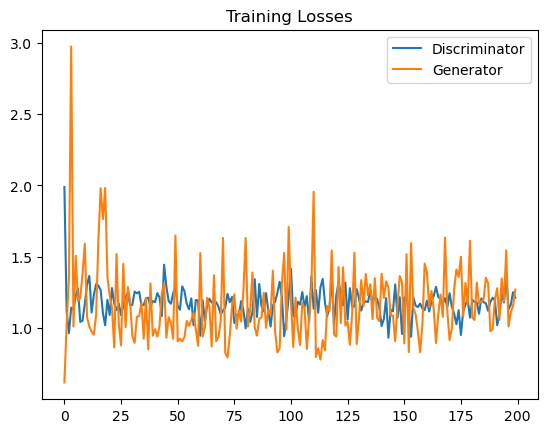

In [11]:
##Training losses recorded after each epoch plotted
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator')
plt.plot(losses.T[1], label='Generator')
plt.title("Training Losses")
plt.legend()

In [12]:
# a function for viewing a list of passed in sample images
def view_samples(epoch, samples):
    fig, axes = plt.subplots(figsize=(7,7), nrows=4, ncols=4, sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        img = img.detach()
        ax.xaxis.set_visible(False)
        ax.yaxis.set_visible(False)
        im = ax.imshow(img.reshape((28,28)), cmap='Greys_r')

In [13]:
# Load samples from generator, taken while training
with open('train_samples.pkl', 'rb') as f:
    samples = pkl.load(f)

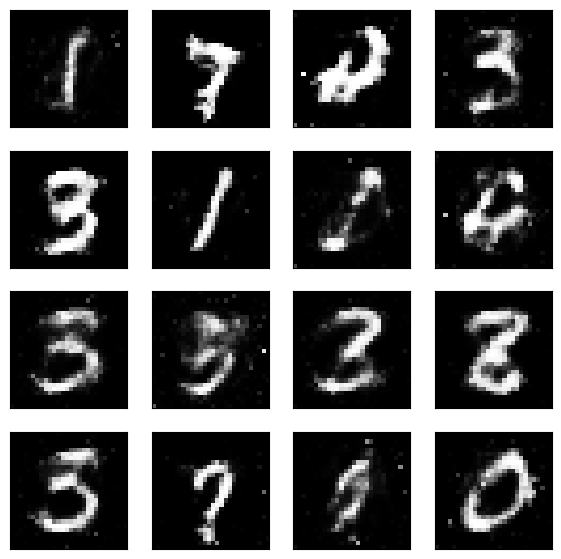

In [14]:
# -1 indicates final epoch's samples (the last in the list)
view_samples(-1, samples)

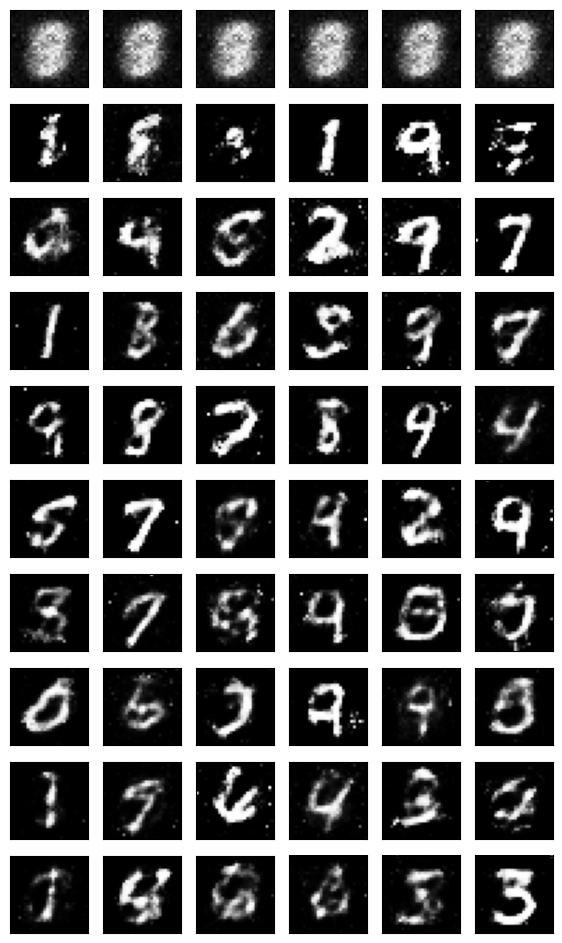

In [15]:
rows = 10 # split epochs into 10, so 100/10 = every 10 epochs
cols = 6
fig, axes = plt.subplots(figsize=(7,12), nrows=rows, ncols=cols, sharex=True, sharey=True)

for sample, ax_row in zip(samples[::int(len(samples)/rows)], axes):
    for img, ax in zip(sample[::int(len(sample)/cols)], ax_row):
        img = img.detach()
        ax.imshow(img.reshape((28,28)), cmap='Greys_r')
        ax.xaxis.set_visible(False)
        ax.yaxis.set_visible(False)

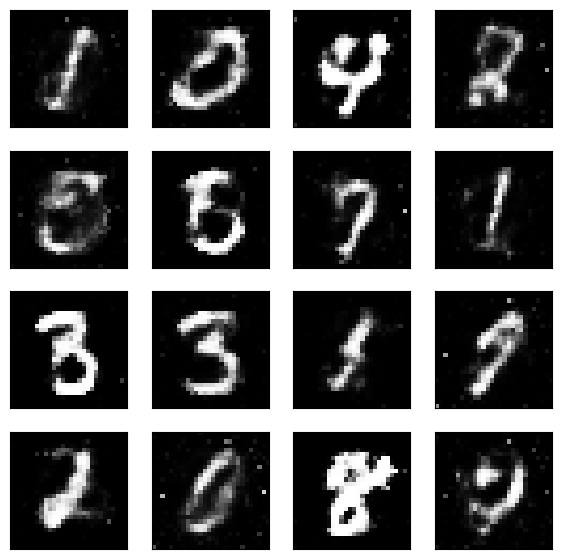

In [16]:
# randomly generated, new latent vectors
sample_size=16
rand_z = np.random.uniform(-1, 1, size=(sample_size, z_size))
rand_z = torch.from_numpy(rand_z).float()

G.eval() # eval mode
# generated samples
rand_images = G(rand_z)

# 0 indicates the first set of samples in the passed in list
# and we only have one batch of samples, here
view_samples(0, [rand_images])